In [2]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import KernelPCA
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import GridSearchCV
import seaborn as sns
import geopandas as gpd
from geopy.geocoders import Nominatim
import folium
from folium.plugins import MarkerCluster
from sklearn.pipeline import Pipeline
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import silhouette_score
import warnings
from sklearn.exceptions import ConvergenceWarning
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from numpy.linalg import LinAlgError
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression

In [3]:
# Load data
# File path to the saved final CSV
output_path = r'../../data/tidy/NTD_Annual_Data_Tidy_v02.csv'

# Read the CSV file and set the index to 'Agency'
df_final_combined = pd.read_csv(output_path, index_col='Agency')

# Drop the original columns to avoid redundancy
df_final_combined.drop(columns=['UZA Name'], inplace=True)

# Drop rows with null indexes
empty_index_rows = df_final_combined.index[df_final_combined.index.isnull()]
df_final_combined = df_final_combined.drop(empty_index_rows)

df_final_combined

,NTD ID,Operating Federal,Operating State,Operating Local,Operating Other,Capital Federal,Capital State,Capital Local,Capital Other,Agency VOMS,...,Days Not Operated Due to Emergencies,Non-Statutory Mixed Traffic,DRM Mixed Traffic ROW,City,State,UZA,Service Area Sq Miles,Service Area Pop,Latitude,Longitude
Agency,,,,,,,,,,,,,,,,,,,,,
"King County Department of Metro Transit, dba: King County Metro",1,126313019.0,17798927.0,573912810.0,266339342.0,35398236.0,22300662.0,97008549.0,9939102.0,18261.0,...,0.0,0.0,1299.03,Seattle,WA,"80389 - Seattle--Tacoma, WA",2134.0,2287050.0,47.606139,-122.332848
Spokane Transit Authority,2,31270192.0,1708713.0,51822996.0,9554657.0,12159213.0,674190.0,27455824.0,0.0,1116.0,...,0.0,0.0,958.10,Spokane,WA,"83764 - Spokane, WA",248.0,459007.0,47.657971,-117.423532
Pierce County Transportation Benefit Area Authority,3,40262064.0,2058990.0,37023952.0,63377478.0,3949421.0,5183835.0,36622271.0,0.0,1910.0,...,0.0,0.0,499.74,Lakewood,WA,"80389 - Seattle--Tacoma, WA",292.0,575963.0,47.171765,-122.518458
Confederated Tribes of the Colville Indian Reservation,4,1490917.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,...,0.0,0.0,0.00,Nespelem,WA,00053 - Washington Non-UZA,NaN,NaN,48.167100,-118.974748
"City of Everett, dba: EVERETT TRANSIT",5,12787325.0,993691.0,6623445.0,3385223.0,179716.0,224413.0,540939.0,0.0,84.0,...,0.0,0.0,118.40,Everett,WA,"80389 - Seattle--Tacoma, WA",34.0,110629.0,47.978985,-122.202079
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Payson Senior Center,99441,174873.0,0.0,30519.0,3581.0,0.0,0.0,0.0,0.0,2.0,...,0.0,0.0,0.00,Payson,AZ,NaN,NaN,NaN,34.230868,-111.325136
Calaveras Transit Agency,99442,275920.0,339983.0,445640.0,81711.0,0.0,72083.0,0.0,0.0,22.0,...,0.0,0.0,0.00,San Andreas,CA,NaN,NaN,NaN,38.196030,-120.680487
Elk Valley Rancheria,99452,28844.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.00,Crescent City,CA,00006 - California Non-UZA,NaN,NaN,41.755750,-124.202591


In [4]:
df_final_combined.loc[df_final_combined['City']=='Albany']

,NTD ID,Operating Federal,Operating State,Operating Local,Operating Other,Capital Federal,Capital State,Capital Local,Capital Other,Agency VOMS,...,Days Not Operated Due to Emergencies,Non-Statutory Mixed Traffic,DRM Mixed Traffic ROW,City,State,UZA,Service Area Sq Miles,Service Area Pop,Latitude,Longitude
Agency,,,,,,,,,,,,,,,,,,,,,
City of Albany,61,2028690.0,704075.0,231675.0,110.0,24374.0,61444.0,42762.0,0.0,30.0,...,0.0,0.0,0.0,Albany,OR,"00955 - Albany, OR",20.0,50724.0,44.636511,-123.105928
Capital District Transportation Authority,20002,45604100.0,61511458.0,11989543.0,2266367.0,17383862.0,3265527.0,2936405.0,0.0,1615.0,...,0.0,0.0,1541.1,Albany,NY,"00970 - Albany--Schenectady, NY",207.0,511949.0,42.652579,-73.756232


In [5]:
df_final_combined.loc[df_final_combined.index == 'St. Louis Metro']

,NTD ID,Operating Federal,Operating State,Operating Local,Operating Other,Capital Federal,Capital State,Capital Local,Capital Other,Agency VOMS,...,Days Not Operated Due to Emergencies,Non-Statutory Mixed Traffic,DRM Mixed Traffic ROW,City,State,UZA,Service Area Sq Miles,Service Area Pop,Latitude,Longitude
Agency,,,,,,,,,,,,,,,,,,,,,


In [6]:
# Creating the new columns
df_final_combined['Operating'] = df_final_combined[['Operating Federal', 'Operating State', 'Operating Local', 'Operating Other']].sum(axis=1)
df_final_combined['Capital'] = df_final_combined[['Capital Federal', 'Capital State', 'Capital Local', 'Capital Other']].sum(axis=1)

# Dropping the used columns
df_final_combined.drop(columns=['Operating Federal', 'Operating State', 'Operating Local', 'Operating Other', 
                                'Capital Federal', 'Capital State', 'Capital Local', 'Capital Other', 'Total OE'], inplace=True)

df_final_combined

,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Service Area Population,Primary UZA Area Sq Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,...,DRM Mixed Traffic ROW,City,State,UZA,Service Area Sq Miles,Service Area Pop,Latitude,Longitude,Operating,Capital
Agency,,,,,,,,,,,,,,,,,,,,,
"King County Department of Metro Transit, dba: King County Metro",1,18261.0,51015415.0,2287050.0,982.52,0.0,0.0,0.0,0.0,311.0,...,1299.03,Seattle,WA,"80389 - Seattle--Tacoma, WA",2134.0,2287050.0,47.606139,-122.332848,984364098.0,164646549.0
Spokane Transit Authority,2,1116.0,10296150.0,459007.0,171.67,0.0,0.0,0.0,0.0,79.0,...,958.10,Spokane,WA,"83764 - Spokane, WA",248.0,459007.0,47.657971,-117.423532,94356558.0,40289227.0
Pierce County Transportation Benefit Area Authority,3,1910.0,9841274.0,575963.0,982.52,0.0,0.0,0.0,0.0,77.0,...,499.74,Lakewood,WA,"80389 - Seattle--Tacoma, WA",292.0,575963.0,47.171765,-122.518458,142722484.0,45755527.0
Confederated Tribes of the Colville Indian Reservation,4,10.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,0.0,...,0.00,Nespelem,WA,00053 - Washington Non-UZA,NaN,NaN,48.167100,-118.974748,1490917.0,0.0
"City of Everett, dba: EVERETT TRANSIT",5,84.0,1625002.0,110629.0,982.52,0.0,0.0,0.0,0.0,15.0,...,118.40,Everett,WA,"80389 - Seattle--Tacoma, WA",34.0,110629.0,47.978985,-122.202079,23789684.0,945068.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Payson Senior Center,99441,2.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,...,0.00,Payson,AZ,NaN,NaN,NaN,34.230868,-111.325136,208973.0,0.0
Calaveras Transit Agency,99442,22.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0,5.0,...,0.00,San Andreas,CA,NaN,NaN,NaN,38.196030,-120.680487,1143254.0,72083.0
Elk Valley Rancheria,99452,1.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,1.0,...,0.00,Crescent City,CA,00006 - California Non-UZA,NaN,NaN,41.755750,-124.202591,28844.0,0.0


In [7]:
# Drop columns with more than 5% missing values
threshold = len(df_final_combined) * 0.95
df_final_combined = df_final_combined.dropna(axis=1, thresh=threshold)
df_final_combined

,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,Mode VOMS_FB,Mode VOMS_HR,...,Days of Service Operated,Days Not Operated Due to Emergencies,Non-Statutory Mixed Traffic,DRM Mixed Traffic ROW,City,State,Latitude,Longitude,Operating,Capital
Agency,,,,,,,,,,,,,,,,,,,,,
"King County Department of Metro Transit, dba: King County Metro",1,18261.0,51015415.0,0.0,0.0,0.0,0.0,311.0,2.0,0.0,...,2896.0,0.0,0.0,1299.03,Seattle,WA,47.606139,-122.332848,984364098.0,164646549.0
Spokane Transit Authority,2,1116.0,10296150.0,0.0,0.0,0.0,0.0,79.0,0.0,0.0,...,1349.0,0.0,0.0,958.10,Spokane,WA,47.657971,-117.423532,94356558.0,40289227.0
Pierce County Transportation Benefit Area Authority,3,1910.0,9841274.0,0.0,0.0,0.0,0.0,77.0,0.0,0.0,...,1350.0,0.0,0.0,499.74,Lakewood,WA,47.171765,-122.518458,142722484.0,45755527.0
Confederated Tribes of the Colville Indian Reservation,4,10.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.00,Nespelem,WA,48.167100,-118.974748,1490917.0,0.0
"City of Everett, dba: EVERETT TRANSIT",5,84.0,1625002.0,0.0,0.0,0.0,0.0,15.0,0.0,0.0,...,722.0,0.0,0.0,118.40,Everett,WA,47.978985,-122.202079,23789684.0,945068.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Payson Senior Center,99441,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,Payson,AZ,34.230868,-111.325136,208973.0,0.0
Calaveras Transit Agency,99442,22.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,...,0.0,0.0,0.0,0.00,San Andreas,CA,38.196030,-120.680487,1143254.0,72083.0
Elk Valley Rancheria,99452,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.00,Crescent City,CA,41.755750,-124.202591,28844.0,0.0


In [8]:
# Save the City and State columns separately
city_state_df = df_final_combined[['City', 'State']].copy()

# Columns to exclude for PCA
exclude_columns = ['NTD ID', 'City', 'State', 'UZA','Latitude', 'Longitude']

# Select the columns to include in PCA
pca_columns = [col for col in df_final_combined.columns if col not in exclude_columns]

In [9]:
## Standardize the data
# StandardScaler is a class from the sklearn.preprocessing module that standardizes features by removing the mean and scaling to unit variance. It transforms the data such that each feature has a mean of 0 and a standard deviation of 1.
scaler = StandardScaler()
df_scaled = pd.DataFrame(scaler.fit_transform(df_final_combined[pca_columns]), columns=pca_columns, index=df_final_combined.index)
df_scaled

,Agency VOMS,Actual Vehicle/Passenger Car Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,Mode VOMS_FB,Mode VOMS_HR,Mode VOMS_IP,...,OpExp NVM,OpExp GA,UZA Area SQ Miles,UZA Population,Days of Service Operated,Days Not Operated Due to Emergencies,Non-Statutory Mixed Traffic,DRM Mixed Traffic ROW,Operating,Capital
Agency,,,,,,,,,,,,,,,,,,,,,
"King County Department of Metro Transit, dba: King County Metro",11.655466,3.669529,-0.021301,-0.102551,-0.021301,-0.05912,5.514238,1.910837,-0.035062,-0.030131,...,0.951790,5.400079,1.128910,0.297153,6.395608,-0.088206,-0.02732,3.577842,3.906448,1.278261
Spokane Transit Authority,0.589336,0.633049,-0.021301,-0.102551,-0.021301,-0.05912,1.145771,-0.092203,-0.035062,-0.030131,...,0.046363,0.401259,-0.165377,-0.619045,2.732666,-0.088206,-0.02732,2.562472,0.278471,0.237287
Pierce County Transportation Benefit Area Authority,1.101818,0.599129,-0.021301,-0.102551,-0.021301,-0.05912,1.108111,-0.092203,-0.035062,-0.030131,...,-0.000921,0.598798,1.128910,0.297153,2.735034,-0.088206,-0.02732,1.197369,0.475627,0.283044
Confederated Tribes of the Colville Indian Reservation,-0.124525,-0.134746,-0.021301,-0.102551,-0.021301,-0.05912,-0.341768,0.909317,-0.035062,-0.030131,...,-0.055860,-0.125837,-0.439398,-0.190493,-0.461458,-0.088206,-0.02732,-0.290973,-0.100082,-0.099967
"City of Everett, dba: EVERETT TRANSIT",-0.076762,-0.013568,-0.021301,-0.102551,-0.021301,-0.05912,-0.059324,-0.092203,-0.035062,-0.030131,...,-0.032213,0.050019,1.128910,0.297153,1.248073,-0.088206,-0.02732,0.061650,-0.009184,-0.092056
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Payson Senior Center,-0.129688,-0.134746,-0.021301,-0.102551,-0.021301,-0.05912,-0.341768,-0.092203,-0.035062,-0.030131,...,-0.055860,-0.125837,-0.439398,-0.367689,-0.461458,-0.088206,-0.02732,-0.290973,-0.105307,-0.099967
Calaveras Transit Agency,-0.116779,-0.134746,-0.021301,-0.102551,-0.021301,-0.05912,-0.247620,-0.092203,-0.035062,-0.030131,...,-0.055860,-0.125837,-0.439398,0.537935,-0.461458,-0.088206,-0.02732,-0.290973,-0.101499,-0.099364
Elk Valley Rancheria,-0.130334,-0.134746,-0.021301,-0.102551,-0.021301,-0.05912,-0.322938,-0.092203,-0.035062,-0.030131,...,-0.055860,-0.125837,-0.439398,0.537935,-0.461458,-0.088206,-0.02732,-0.290973,-0.106042,-0.099967


In [10]:
X = df_scaled.values

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

Gamma: 0.0001, Components to explain 90% variance: 19
Gamma: 0.0005, Components to explain 90% variance: 18
Gamma: 0.001, Components to explain 90% variance: 16
Gamma: 0.005, Components to explain 90% variance: 15
Gamma: 0.01, Components to explain 90% variance: 14
Gamma: 0.02, Components to explain 90% variance: 13
Gamma: 0.05, Components to explain 90% variance: 12
Gamma: 0.1, Components to explain 90% variance: 13
Gamma: 0.5, Components to explain 90% variance: 13
Gamma: 1, Components to explain 90% variance: 13


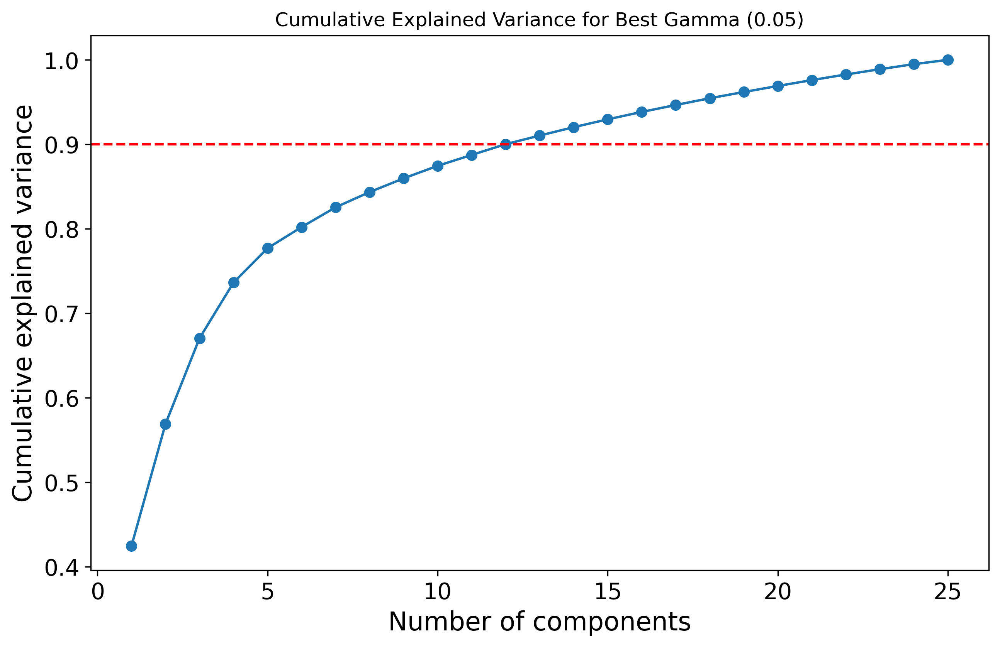

Best gamma: 0.05
Minimum number of components to explain 90% variance: 12


In [11]:
# Define gamma values to test
gamma_values = [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.02, 0.05, 0.1, 0.5, 1]

# Initialize variables to store the best results
best_gamma = None
best_n_components = None
min_components_for_90_variance = np.inf

# Store results for visualization
results = {}

for gamma in gamma_values:
    # Fit KernelPCA
    kpca = KernelPCA(n_components=25, kernel='rbf', gamma=gamma, fit_inverse_transform=True)
    X_kpca = kpca.fit_transform(X_scaled)
    
    # Use PCA to approximate explained variance
    pca = PCA(n_components=25)
    X_pca = pca.fit_transform(X_kpca)
    cumulative_explained_variance = np.cumsum(pca.explained_variance_ratio_)
    
    # Find the minimum number of components that explain at least 90% variance
    n_components = np.argmax(cumulative_explained_variance >= 0.90) + 1
    
    # Save results for plotting
    results[gamma] = cumulative_explained_variance
    
    # Update the best gamma and n_components if this is better
    if n_components < min_components_for_90_variance:
        min_components_for_90_variance = n_components
        best_gamma = gamma
        best_n_components = n_components

    print(f"Gamma: {gamma}, Components to explain 90% variance: {n_components}")

# Plot the cumulative explained variance for the best gamma
plt.figure(figsize=(10, 6), dpi=300)
plt.plot(range(1, len(results[best_gamma]) + 1), results[best_gamma], marker='o')
plt.axhline(y=0.90, color='r', linestyle='--')
plt.xlabel('Number of components', fontsize=16)
plt.ylabel('Cumulative explained variance', fontsize=16)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.title(f'Cumulative Explained Variance for Best Gamma ({best_gamma})')
plt.show()

print(f'Best gamma: {best_gamma}')
print(f'Minimum number of components to explain 90% variance: {best_n_components}')


Kernel: linear, Gamma: None, Components to explain 90% variance: 17
Kernel: linear, Gamma: None, Components to explain 90% variance: 17
Kernel: linear, Gamma: None, Components to explain 90% variance: 17
Kernel: linear, Gamma: None, Components to explain 90% variance: 17
Kernel: linear, Gamma: None, Components to explain 90% variance: 17
Kernel: linear, Gamma: None, Components to explain 90% variance: 17
Kernel: linear, Gamma: None, Components to explain 90% variance: 17
Kernel: linear, Gamma: None, Components to explain 90% variance: 17
Kernel: linear, Gamma: None, Components to explain 90% variance: 17
Kernel: linear, Gamma: None, Components to explain 90% variance: 17
Kernel: poly, Gamma: 0.0001, Components to explain 90% variance: 11
Kernel: poly, Gamma: 0.0005, Components to explain 90% variance: 4
Kernel: poly, Gamma: 0.001, Components to explain 90% variance: 3


C:\Users\Mahsa\anaconda3\envs\ox\Lib\site-packages\sklearn\decomposition\_kernel_pca.py:410: LinAlgWarning: Ill-conditioned matrix (rcond=7.57565e-21): result may not be accurate.
  self.dual_coef_ = linalg.solve(K, X, assume_a="pos", overwrite_a=True)
C:\Users\Mahsa\anaconda3\envs\ox\Lib\site-packages\sklearn\decomposition\_kernel_pca.py:410: LinAlgWarning: Ill-conditioned matrix (rcond=7.57565e-21): result may not be accurate.
  self.dual_coef_ = linalg.solve(K, X, assume_a="pos", overwrite_a=True)


Kernel: poly, Gamma: 0.005, Components to explain 90% variance: 3


C:\Users\Mahsa\anaconda3\envs\ox\Lib\site-packages\sklearn\decomposition\_kernel_pca.py:410: LinAlgWarning: Ill-conditioned matrix (rcond=6.67333e-25): result may not be accurate.
  self.dual_coef_ = linalg.solve(K, X, assume_a="pos", overwrite_a=True)
C:\Users\Mahsa\anaconda3\envs\ox\Lib\site-packages\sklearn\decomposition\_kernel_pca.py:410: LinAlgWarning: Ill-conditioned matrix (rcond=6.67333e-25): result may not be accurate.
  self.dual_coef_ = linalg.solve(K, X, assume_a="pos", overwrite_a=True)


Kernel: poly, Gamma: 0.01, Components to explain 90% variance: 3


C:\Users\Mahsa\anaconda3\envs\ox\Lib\site-packages\sklearn\decomposition\_kernel_pca.py:410: LinAlgWarning: Ill-conditioned matrix (rcond=1.25253e-28): result may not be accurate.
  self.dual_coef_ = linalg.solve(K, X, assume_a="pos", overwrite_a=True)
C:\Users\Mahsa\anaconda3\envs\ox\Lib\site-packages\sklearn\decomposition\_kernel_pca.py:410: LinAlgWarning: Ill-conditioned matrix (rcond=1.25253e-28): result may not be accurate.
  self.dual_coef_ = linalg.solve(K, X, assume_a="pos", overwrite_a=True)


Kernel: poly, Gamma: 0.02, Components to explain 90% variance: 3


C:\Users\Mahsa\anaconda3\envs\ox\Lib\site-packages\sklearn\decomposition\_kernel_pca.py:410: LinAlgWarning: Ill-conditioned matrix (rcond=3.16863e-33): result may not be accurate.
  self.dual_coef_ = linalg.solve(K, X, assume_a="pos", overwrite_a=True)
C:\Users\Mahsa\anaconda3\envs\ox\Lib\site-packages\sklearn\decomposition\_kernel_pca.py:410: LinAlgWarning: Ill-conditioned matrix (rcond=3.16863e-33): result may not be accurate.
  self.dual_coef_ = linalg.solve(K, X, assume_a="pos", overwrite_a=True)


Kernel: poly, Gamma: 0.05, Components to explain 90% variance: 3
Skipping Kernel: poly, Gamma: 0.1 due to LinAlgError
Skipping Kernel: poly, Gamma: 0.5 due to LinAlgError
Skipping Kernel: poly, Gamma: 1 due to LinAlgError
Kernel: rbf, Gamma: 0.0001, Components to explain 90% variance: 19
Kernel: rbf, Gamma: 0.0005, Components to explain 90% variance: 18
Kernel: rbf, Gamma: 0.001, Components to explain 90% variance: 16
Kernel: rbf, Gamma: 0.005, Components to explain 90% variance: 15
Kernel: rbf, Gamma: 0.01, Components to explain 90% variance: 14
Kernel: rbf, Gamma: 0.02, Components to explain 90% variance: 13
Kernel: rbf, Gamma: 0.05, Components to explain 90% variance: 12
Kernel: rbf, Gamma: 0.1, Components to explain 90% variance: 13
Kernel: rbf, Gamma: 0.5, Components to explain 90% variance: 13
Kernel: rbf, Gamma: 1, Components to explain 90% variance: 13
Kernel: sigmoid, Gamma: 0.0001, Components to explain 90% variance: 18
Kernel: sigmoid, Gamma: 0.0005, Components to explain 90

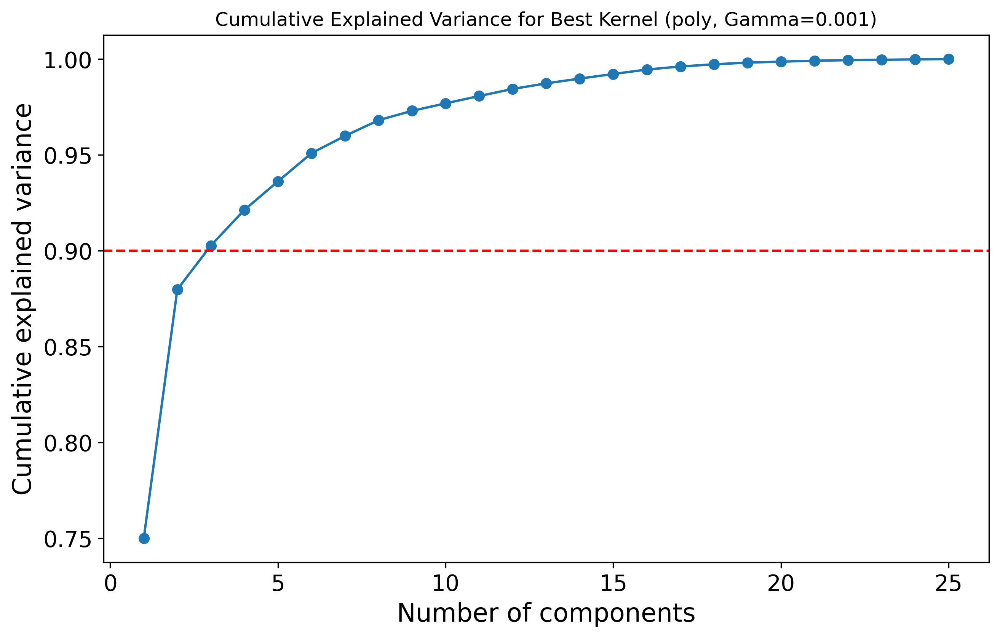

Best kernel: poly
Best gamma: 0.001
Minimum number of components to explain 90% variance: 3


In [12]:
# Define kernel types and gamma values to test
kernels = ['linear', 'poly', 'rbf', 'sigmoid']
gamma_values = [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.02, 0.05, 0.1, 0.5, 1]

# Initialize variables to store the best results
best_kernel = None
best_gamma = None
best_n_components = None
min_components_for_90_variance = np.inf

# Store results for visualization
results = {}

for kernel in kernels:
    for gamma in gamma_values:
        if kernel == 'linear':  # Gamma is not used for the linear kernel
            gamma = None
        
        # Fit KernelPCA
        try:
            kpca = KernelPCA(n_components=25, kernel=kernel, gamma=gamma, alpha=1e-5, fit_inverse_transform=True)
            X_kpca = kpca.fit_transform(X_scaled)
        except LinAlgError as e:
            print(f"Skipping Kernel: {kernel}, Gamma: {gamma} due to LinAlgError")
            continue
        
        # Use PCA to approximate explained variance
        pca = PCA(n_components=25)
        X_pca = pca.fit_transform(X_kpca)
        cumulative_explained_variance = np.cumsum(pca.explained_variance_ratio_)
        
        # Find the minimum number of components that explain at least 90% variance
        n_components = np.argmax(cumulative_explained_variance >= 0.90) + 1
        
        # Save results for plotting
        results[(kernel, gamma)] = cumulative_explained_variance
        
        # Update the best kernel, gamma, and n_components if this is better
        if n_components < min_components_for_90_variance:
            min_components_for_90_variance = n_components
            best_kernel = kernel
            best_gamma = gamma
            best_n_components = n_components
        
        print(f"Kernel: {kernel}, Gamma: {gamma}, Components to explain 90% variance: {n_components}")

# Plot the cumulative explained variance for the best kernel and gamma
best_key = (best_kernel, best_gamma)
plt.figure(figsize=(10, 6), dpi=300)
plt.plot(range(1, len(results[best_key]) + 1), results[best_key], marker='o')
plt.axhline(y=0.90, color='r', linestyle='--')
plt.xlabel('Number of components', fontsize=16)
plt.ylabel('Cumulative explained variance', fontsize=16)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.title(f'Cumulative Explained Variance for Best Kernel ({best_kernel}, Gamma={best_gamma})')
plt.show()

print(f'Best kernel: {best_kernel}')
print(f'Best gamma: {best_gamma}')
print(f'Minimum number of components to explain 90% variance: {best_n_components}')


In [13]:
X = df_scaled.values

# Define the gamma values to compare
gamma_values = [0.0001, 0.0005, 0.0006, 0.0007, 0.0008, 0.009, 0.001, 0.002, 0.003, 0.005, 0.01, 0.02, 0.04, 0.06, 0.08, 0.1, 0.5, 1, 5]

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Define a basic regression model for evaluation purposes
reg = LinearRegression()

# Dictionary to store cross-validation results
cv_scores = {}

for gamma in gamma_values:
    # Create a pipeline with KPCA and the regression model
    kpca = KernelPCA(n_components=9, kernel='rbf', gamma=gamma)
    pipeline = Pipeline([
        ('kpca', kpca),
        ('reg', reg)
    ])
    
    # Perform cross-validation
    scores = cross_val_score(pipeline, X_scaled, X_scaled[:, 0], cv=5, scoring='r2')  # Using R^2 score for regression
    cv_scores[gamma] = scores.mean()
    
    print(f"Gamma: {gamma}, Cross-Validation R^2 Score: {scores.mean()}")

# Choose the gamma with the highest cross-validation score
best_gamma = max(cv_scores, key=cv_scores.get)
print(f"Best gamma value: {best_gamma}")

Gamma: 0.0001, Cross-Validation R^2 Score: 0.17024604044907
Gamma: 0.0005, Cross-Validation R^2 Score: 0.26062713772368695
Gamma: 0.0006, Cross-Validation R^2 Score: 0.26646833133790604
Gamma: 0.0007, Cross-Validation R^2 Score: 0.2862749538206971
Gamma: 0.0008, Cross-Validation R^2 Score: 0.2916241582289648
Gamma: 0.009, Cross-Validation R^2 Score: 0.2208243764756245
Gamma: 0.001, Cross-Validation R^2 Score: 0.2748514921002057
Gamma: 0.002, Cross-Validation R^2 Score: 0.2539289721132634
Gamma: 0.003, Cross-Validation R^2 Score: 0.27074372857695417
Gamma: 0.005, Cross-Validation R^2 Score: 0.24824457823709398
Gamma: 0.01, Cross-Validation R^2 Score: 0.21357628389330943
Gamma: 0.02, Cross-Validation R^2 Score: 0.17578345535678785
Gamma: 0.04, Cross-Validation R^2 Score: 0.13228801383761976
Gamma: 0.06, Cross-Validation R^2 Score: 0.10675088530041779
Gamma: 0.08, Cross-Validation R^2 Score: 0.09001205086275296
Gamma: 0.1, Cross-Validation R^2 Score: 0.075048443445711
Gamma: 0.5, Cross-Va

# Kernel PCA

In [14]:
# Assuming df_scaled is your data
X = df_scaled.values

# Define the gamma values to compare
gamma_values = [0.1, 0.5, 1, 5, 10, 100]

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Define a basic regression model for evaluation purposes
reg = LinearRegression()

# Dictionary to store cross-validation results
cv_scores = {}

for gamma in gamma_values:
    # Create a pipeline with KPCA and the regression model
    kpca = KernelPCA(n_components=9, kernel='rbf', gamma=gamma)
    pipeline = Pipeline([
        ('kpca', kpca),
        ('reg', reg)
    ])
    
    # Perform cross-validation
    scores = cross_val_score(pipeline, X_scaled, X_scaled[:, 0], cv=5, scoring='r2')  # Using R^2 score for regression
    cv_scores[gamma] = scores.mean()
    
    print(f"Gamma: {gamma}, Cross-Validation R^2 Score: {scores.mean()}")

# Choose the gamma with the highest cross-validation score
best_gamma = max(cv_scores, key=cv_scores.get)
print(f"Best gamma value: {best_gamma}")


Gamma: 0.1, Cross-Validation R^2 Score: 0.07504844344571097
Gamma: 0.5, Cross-Validation R^2 Score: -0.00222757146059529
Gamma: 1, Cross-Validation R^2 Score: -0.018342369619929567
Gamma: 5, Cross-Validation R^2 Score: -0.03993607442087406
Gamma: 10, Cross-Validation R^2 Score: -0.04068873873854713
Gamma: 100, Cross-Validation R^2 Score: -0.047800910646683105
Best gamma value: 0.1


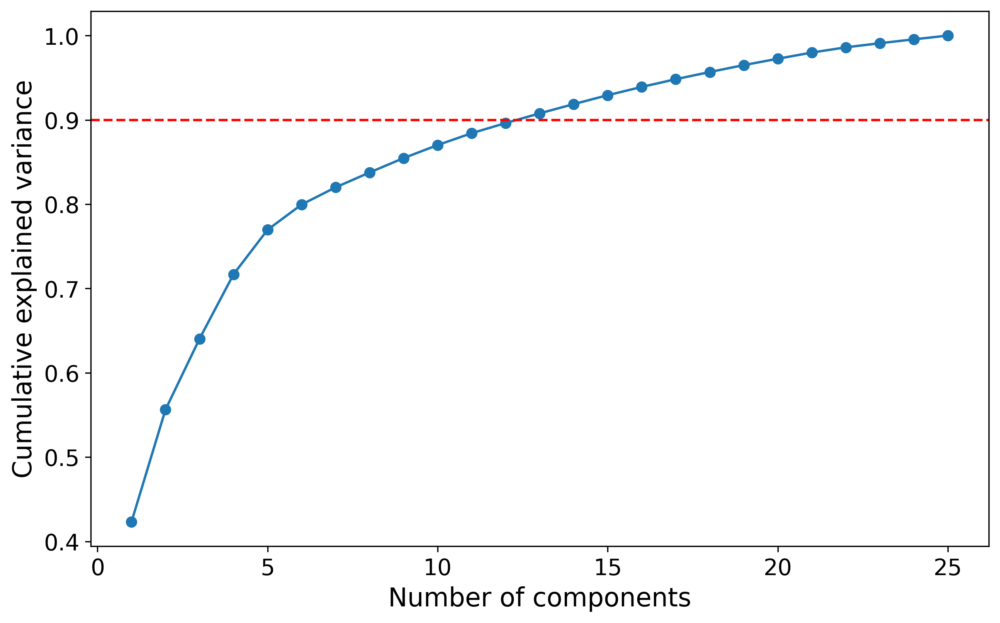

Number of components needed to explain 90% of the variance: 12


In [15]:
# Fit KernelPCA
kpca = KernelPCA(n_components=25, kernel='rbf', fit_inverse_transform=True, gamma=0.1)
X_kpca = kpca.fit_transform(df_scaled)

# Explained variance approximation using PCA on transformed data
pca = PCA(n_components=25)
X_pca = pca.fit_transform(X_kpca)
cumulative_explained_variance = np.cumsum(pca.explained_variance_ratio_)

# Plot cumulative explained variance
plt.figure(figsize=(10, 6), dpi=300)
plt.plot(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, marker='o')
plt.xlabel('Number of components', fontsize=16)
plt.ylabel('Cumulative explained variance', fontsize=16)
plt.axhline(y=0.9, color='r', linestyle='--')
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
#plt.title('Cumulative Explained Variance for KPCA')
plt.show()

n_factors_variance = np.argmax(cumulative_explained_variance > 0.9) 
print(f'Number of components needed to explain 90% of the variance: {n_factors_variance}')


In [16]:
kpca = KernelPCA(n_components=12, kernel='rbf')
X_kpca = kpca.fit_transform(df_scaled)
print("X_kpca.shape", X_kpca.shape)

def gmm_bic_score(estimator, X):
    """Callable to pass to GridSearchCV that will use the BIC score."""
    # Make it negative since GridSearchCV expects a score to maximize
    return -estimator.bic(X)


param_grid = {
    "n_components": range(2, 36),
    "covariance_type": [ "full"],
}
grid_search = GridSearchCV(
    GaussianMixture(random_state=111), param_grid=param_grid, scoring=gmm_bic_score
)

grid_search.fit(X_kpca) 


df = pd.DataFrame(grid_search.cv_results_)[
    ["param_n_components", "param_covariance_type", "mean_test_score"]
]
df["mean_test_score"] = -df["mean_test_score"]
df = df.rename(
    columns={
        "param_n_components": "Number of clusters",
        "param_covariance_type": "Type of covariance",
        "mean_test_score": "BIC score",
    }
)
df.sort_values(by="BIC score")#.head()

X_kpca.shape (2205, 12)


,Number of clusters,Type of covariance,BIC score
3,5,full,-33724.679839
4,6,full,-33483.061857
2,4,full,-33283.154092
5,7,full,-32840.229965
6,8,full,-32783.211761
1,3,full,-31952.267021
7,9,full,-31763.065826
8,10,full,-31268.929034
9,11,full,-30485.421592
10,12,full,-29072.977506


In [17]:
## Find the minimum BIC score and its location
#min_bic = pivot_df.min().min()
#min_location = pivot_df.stack().idxmin()

## Plotting the heatmap with the modified color scheme and highlight the best BIC score
#plt.figure(figsize=(10, 8), dpi=300)
#sns.heatmap(pivot_df, annot=True, fmt=".1f", cmap="RdYlGn", center=min_bic)

## Highlight the best BIC score with a square
#plt.gca().add_patch(plt.Rectangle((pivot_df.columns.get_loc(min_location[1]), pivot_df.index.get_loc(min_location[0])), 1, 1, fill=False, edgecolor='blue', lw=3))
##plt.title("Grid Search BIC Scores for GMM")
#plt.show()

In [18]:
#from sklearn.pipeline import Pipeline
#from sklearn.model_selection import GridSearchCV
#from sklearn.decomposition import KernelPCA
#from sklearn.mixture import GaussianMixture
#from sklearn.preprocessing import StandardScaler
#from sklearn.metrics import make_scorer
#import numpy as np

## Custom scorer for BIC
#def bic_scorer(estimator, X):
#    gmm = estimator.named_steps['gmm']
#    gmm.fit(X)
#    return -gmm.bic(X)  # Return negative BIC because GridSearchCV maximizes the score

#bic_score = make_scorer(bic_scorer, greater_is_better=True)

## Define the pipeline
#pipeline = Pipeline([
#    ('kpca', KernelPCA()),
#    ('gmm', GaussianMixture())
#])

# Define the parameter grid
#param_grid = {
#    'kpca__n_components': [4, 5, 6, 7, 8, 9, 10],  
#    'kpca__kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
#    'kpca__gamma': [0.01, 0.1, 1, 10],  # Relevant for 'poly', 'rbf', and 'sigmoid'
#    'kpca__degree': [2, 3, 4],  # Relevant for 'poly'
#    'gmm__n_components': [3, 4, 5, 6, 7],  # Number of clusters
#    'gmm__covariance_type': ['full', 'tied', 'diag', 'spherical'],
#    'gmm__reg_covar': [1e-6, 1e-4, 1e-2]
#}

## Perform the grid search
#grid_search = GridSearchCV(pipeline, param_grid, cv=3, n_jobs=-1, scoring=bic_score)
#grid_search.fit(X_scaled)

## Get the best parameters and model
#best_params = grid_search.best_params_
#best_model = grid_search.best_estimator_

#print("Best Parameters:", best_params)

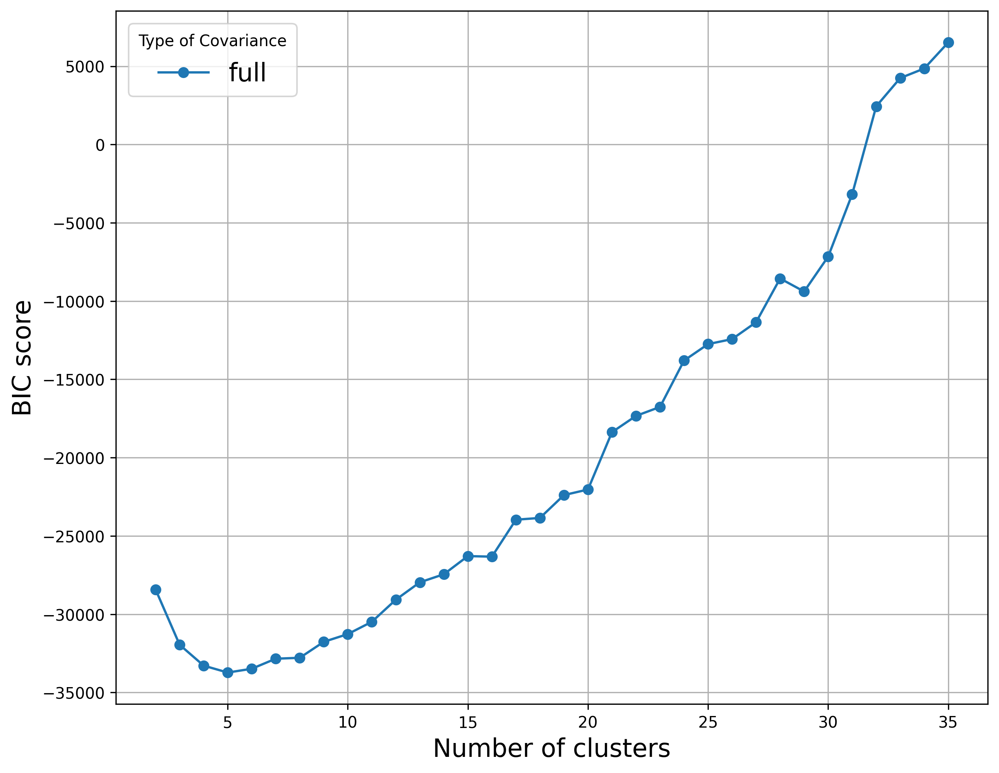

In [19]:
# Pivot the DataFrame
pivot_df = df.pivot_table(values="BIC score", index="Number of clusters", columns="Type of covariance")

# Plotting the line plot
plt.figure(figsize=(10, 8), dpi=300)
for col in pivot_df.columns:
    plt.plot(pivot_df.index, pivot_df[col], marker='o', label=col)

#plt.title("Grid Search BIC Scores for GMM")
plt.xlabel("Number of clusters", fontsize=16)
plt.ylabel("BIC score", fontsize=16)
plt.legend(title="Type of Covariance", fontsize=16)
plt.grid(True)
plt.show()


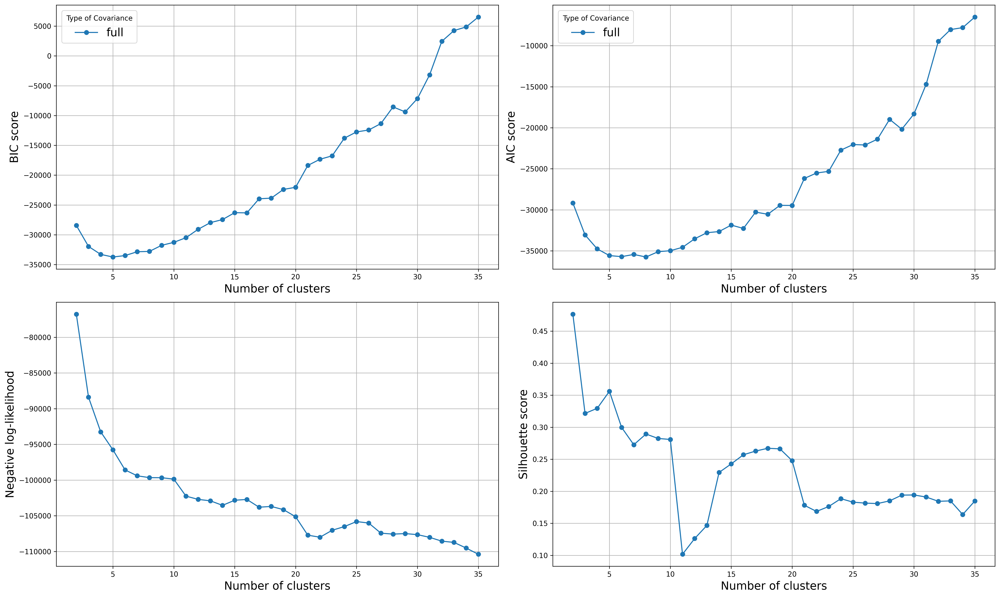

,Number of clusters,BIC score,AIC score,Negative Log Likelihood,Silhouette Score
Number of clusters,,,,,
2,2,-28427.403185,-29167.520308,-76771.577268,0.476275
3,3,-31952.267021,-33064.487227,-88388.625730,0.321540
4,4,-33283.154092,-34767.477382,-93247.491482,0.329518
5,5,-33724.679839,-35581.106212,-95754.916697,0.356054
6,6,-33483.061857,-35711.591314,-98579.726241,0.299740
7,7,-32840.229965,-35440.862506,-99404.918091,0.272640
8,8,-32783.211761,-35755.947386,-99658.774463,0.289362
9,9,-31763.065826,-35107.904534,-99668.757429,0.282457
10,10,-31268.929034,-34985.870826,-99866.572318,0.280892


In [20]:
def gmm_bic_score(estimator, X):
    return -estimator.bic(X)

def gmm_aic_score(estimator, X):
    return -estimator.aic(X)

def gmm_neg_log_likelihood_score(estimator, X):
    return estimator.score(X) * X.shape[0]

param_grid = {
    "n_components": range(2, 36),
    "covariance_type": ["full"],
}

# Grid search with BIC
grid_search_bic = GridSearchCV(
    GaussianMixture(random_state=111), param_grid=param_grid, scoring=gmm_bic_score
)
grid_search_bic.fit(X_kpca)


# Grid search with AIC
grid_search_aic = GridSearchCV(
    GaussianMixture(random_state=111), param_grid=param_grid, scoring=gmm_aic_score
)
grid_search_aic.fit(X_kpca)

# Collect BIC and AIC scores
df_bic = pd.DataFrame(grid_search_bic.cv_results_)[
    ["param_n_components", "param_covariance_type", "mean_test_score"]
]
df_bic["mean_test_score"] = -df_bic["mean_test_score"]
df_bic = df_bic.rename(
    columns={
        "param_n_components": "Number of clusters",
        "param_covariance_type": "Type of covariance",
        "mean_test_score": "BIC score",
    }
)

df_aic = pd.DataFrame(grid_search_aic.cv_results_)[
    ["param_n_components", "param_covariance_type", "mean_test_score"]
]
df_aic["mean_test_score"] = -df_aic["mean_test_score"]
df_aic = df_aic.rename(
    columns={
        "param_n_components": "Number of clusters",
        "param_covariance_type": "Type of covariance",
        "mean_test_score": "AIC score",
    }
)

# Calculate Negative Log Likelihood and Silhouette Scores
n_clusters_range = range(2, 36)
neg_log_likelihood_scores = []
silhouette_scores = []

for n_clusters in n_clusters_range:
    gmm = GaussianMixture(n_components=n_clusters, covariance_type='full', random_state=111)
    gmm.fit(X_kpca)
    labels = gmm.predict(X_kpca)
    
    # Negative log-likelihood
    neg_log_likelihood = -gmm.score(X_kpca) * X_kpca.shape[0]
    neg_log_likelihood_scores.append(neg_log_likelihood)
    
    # Silhouette score
    silhouette_avg = silhouette_score(X_kpca, labels)
    silhouette_scores.append(silhouette_avg)

# Create DataFrame for Negative Log Likelihood and Silhouette Scores
df_neg_log_likelihood = pd.DataFrame({
    "Number of clusters": n_clusters_range,
    "Negative Log Likelihood": neg_log_likelihood_scores
})

df_silhouette = pd.DataFrame({
    "Number of clusters": n_clusters_range,
    "Silhouette Score": silhouette_scores
})

# Plotting BIC, AIC, Negative Log Likelihood, and Silhouette Scores
plt.figure(figsize=(20, 12), dpi=300)

plt.subplot(2, 2, 1)
pivot_df_bic = df_bic.pivot_table(values="BIC score", index="Number of clusters", columns="Type of covariance")
for col in pivot_df_bic.columns:
    plt.plot(pivot_df_bic.index, pivot_df_bic[col], marker='o', label=col)
plt.xlabel("Number of clusters", fontsize=16)
plt.ylabel("BIC score", fontsize=16)
plt.legend(title="Type of Covariance", fontsize=16)
plt.grid(True)

plt.subplot(2, 2, 2)
pivot_df_aic = df_aic.pivot_table(values="AIC score", index="Number of clusters", columns="Type of covariance")
for col in pivot_df_aic.columns:
    plt.plot(pivot_df_aic.index, pivot_df_aic[col], marker='o', label=col)
plt.xlabel("Number of clusters", fontsize=16)
plt.ylabel("AIC score", fontsize=16)
plt.legend(title="Type of Covariance", fontsize=16)
plt.grid(True)

plt.subplot(2, 2, 3)
plt.plot(df_neg_log_likelihood["Number of clusters"], df_neg_log_likelihood["Negative Log Likelihood"], marker='o')
plt.xlabel("Number of clusters", fontsize=16)
plt.ylabel("Negative log-likelihood", fontsize=16)
plt.grid(True)

plt.subplot(2, 2, 4)
plt.plot(df_silhouette["Number of clusters"], df_silhouette["Silhouette Score"], marker='o')
plt.xlabel("Number of clusters", fontsize=16)
plt.ylabel("Silhouette score", fontsize=16)
plt.grid(True)

plt.tight_layout()
plt.show()

# Create a table combining all scores
df_combined = pd.DataFrame({
    "Number of clusters": n_clusters_range,
    "BIC score": df_bic.set_index("Number of clusters")["BIC score"].reindex(n_clusters_range),
    "AIC score": df_aic.set_index("Number of clusters")["AIC score"].reindex(n_clusters_range),
    "Negative Log Likelihood": df_neg_log_likelihood.set_index("Number of clusters")["Negative Log Likelihood"].reindex(n_clusters_range),
    "Silhouette Score": df_silhouette.set_index("Number of clusters")["Silhouette Score"].reindex(n_clusters_range)
})


# Display the combined table
df_combined

In [21]:
# Define the best GMM model based on the BIC score
best_gmm = GaussianMixture(n_components=5, covariance_type='full', random_state=111)

# Fit the model to the Kernel PCA transformed data and predict the clusters
clusters = best_gmm.fit_predict(X_kpca)

# Add the clusters to your dataframe
df_final_combined['Cluster'] = clusters

print("Best GMM Model:")
print("Number of components:", best_gmm.n_components)
print("Covariance type:", best_gmm.covariance_type)


Best GMM Model:
Number of components: 5
Covariance type: full


C:\Users\Mahsa\AppData\Local\Temp\ipykernel_33356\44102426.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_final_combined['Cluster'] = clusters


In [22]:
df_final_combined

,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,Mode VOMS_FB,Mode VOMS_HR,...,Days Not Operated Due to Emergencies,Non-Statutory Mixed Traffic,DRM Mixed Traffic ROW,City,State,Latitude,Longitude,Operating,Capital,Cluster
Agency,,,,,,,,,,,,,,,,,,,,,
"King County Department of Metro Transit, dba: King County Metro",1,18261.0,51015415.0,0.0,0.0,0.0,0.0,311.0,2.0,0.0,...,0.0,0.0,1299.03,Seattle,WA,47.606139,-122.332848,984364098.0,164646549.0,0
Spokane Transit Authority,2,1116.0,10296150.0,0.0,0.0,0.0,0.0,79.0,0.0,0.0,...,0.0,0.0,958.10,Spokane,WA,47.657971,-117.423532,94356558.0,40289227.0,3
Pierce County Transportation Benefit Area Authority,3,1910.0,9841274.0,0.0,0.0,0.0,0.0,77.0,0.0,0.0,...,0.0,0.0,499.74,Lakewood,WA,47.171765,-122.518458,142722484.0,45755527.0,3
Confederated Tribes of the Colville Indian Reservation,4,10.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.00,Nespelem,WA,48.167100,-118.974748,1490917.0,0.0,3
"City of Everett, dba: EVERETT TRANSIT",5,84.0,1625002.0,0.0,0.0,0.0,0.0,15.0,0.0,0.0,...,0.0,0.0,118.40,Everett,WA,47.978985,-122.202079,23789684.0,945068.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Payson Senior Center,99441,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.00,Payson,AZ,34.230868,-111.325136,208973.0,0.0,1
Calaveras Transit Agency,99442,22.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,...,0.0,0.0,0.00,San Andreas,CA,38.196030,-120.680487,1143254.0,72083.0,1
Elk Valley Rancheria,99452,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.00,Crescent City,CA,41.755750,-124.202591,28844.0,0.0,1


In [23]:
import numpy as np
import pandas as pd
from sklearn.metrics import pairwise_distances

# Step 1: Filter Numeric Columns
# Select only numeric columns to avoid issues with non-numeric data
numeric_columns = df_final_combined.select_dtypes(include=[np.number]).columns

# Step 2: Compute Centroids for Each Cluster
# Group by cluster and calculate the mean for numeric columns
cluster_centroids = df_final_combined.groupby('Cluster')[numeric_columns].mean()

# Step 3: Compute Distance of Each System to Its Cluster Centroid
# Initialize a list to store distances
distances = []

for index, row in df_final_combined.iterrows():
    # Extract the cluster number
    cluster_id = row['Cluster']
    
    # Extract the cluster centroid
    centroid = cluster_centroids.loc[cluster_id].values
    
    # Calculate Euclidean distance between the system and the centroid
    distance = np.linalg.norm(row[numeric_columns] - centroid)
    distances.append(distance)

# Add distances to the DataFrame
df_final_combined['Distance_to_Centroid'] = distances

# Step 4: Rank Members within Each Cluster
# Sort by cluster and distance, then rank
df_final_combined['Rank'] = df_final_combined.groupby('Cluster')['Distance_to_Centroid'].rank()

# Step 5: Compare Cluster Centroids with the Overall Centroid (Optional)
# Calculate the overall centroid of all systems
overall_centroid = df_final_combined[numeric_columns].mean()

# Compute distances between each cluster centroid and the overall centroid
cluster_centroids['Distance_to_Overall'] = pairwise_distances(
    cluster_centroids.values, 
    [overall_centroid],
    metric='euclidean'
).flatten()

C:\Users\Mahsa\AppData\Local\Temp\ipykernel_33356\2177560740.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_final_combined['Distance_to_Centroid'] = distances
C:\Users\Mahsa\AppData\Local\Temp\ipykernel_33356\2177560740.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_final_combined['Rank'] = df_final_combined.groupby('Cluster')['Distance_to_Centroid'].rank()


In [24]:
# Outputs
print("Cluster Centroids with Distance to Overall Centroid:")
cluster_centroids



Cluster Centroids with Distance to Overall Centroid:


,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,Mode VOMS_FB,Mode VOMS_HR,...,Days of Service Operated,Days Not Operated Due to Emergencies,Non-Statutory Mixed Traffic,DRM Mixed Traffic ROW,Latitude,Longitude,Operating,Capital,Cluster,Distance_to_Overall
Cluster,,,,,,,,,,,,,,,,,,,,,
0,46562.108434,3399.048193,3.013687e+07,0.722892,13.289157,0.289157,58.915663,127.650602,1.216867,104.144578,...,1127.578313,2.674699,0.360241,817.674337,39.117336,-95.171794,4.901148e+08,2.492458e+08,0.0,5.913102e+08
1,52840.375583,15.901244,0.000000e+00,0.000000,0.003110,0.000000,0.000000,8.135303,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,38.588908,-92.650646,1.189564e+06,1.915743e+05,1.0,3.125330e+07
2,47137.694006,97.539432,1.237883e+06,0.000000,0.000000,0.000000,0.000000,24.552050,0.000000,0.100946,...,467.075710,0.305994,0.000000,159.948580,38.438661,-90.089449,1.075375e+07,2.181210e+06,2.0,2.039387e+07
3,46527.529880,427.509960,4.279548e+06,0.000000,5.904382,0.000000,2.621514,37.756972,0.406375,2.342629,...,705.904382,0.505976,0.000000,379.895219,37.750280,-91.940301,4.481234e+07,1.836192e+07,3.0,2.408951e+07
4,54539.212687,24.861940,6.111146e+04,0.000000,0.902985,0.000000,0.000000,6.361940,0.000000,0.000000,...,40.675373,0.007463,0.000000,5.611940,38.410472,-99.452077,2.082548e+06,3.688437e+05,4.0,3.043396e+07


In [25]:
print("\nRanked Systems within Each Cluster:")
df_final_combined.sort_values(by=['Cluster', 'Rank'])


Ranked Systems within Each Cluster:


,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,Mode VOMS_FB,Mode VOMS_HR,...,DRM Mixed Traffic ROW,City,State,Latitude,Longitude,Operating,Capital,Cluster,Distance_to_Centroid,Rank
Agency,,,,,,,,,,,,,,,,,,,,,
Tri-County Metropolitan Transportation District of Oregon,8,4518.0,36072191.0,0.0,0.0,0.0,0.0,157.0,0.0,0.0,...,1345.90,Portland,OR,45.515232,-122.678385,597810154.0,232618676.0,0,2.031072e+08,1.0
Utah Transit Authority,80001,8504.0,40768367.0,0.0,66.0,0.0,45.0,139.0,0.0,0.0,...,2390.14,Salt Lake City,UT,40.760779,-111.891047,511976617.0,91983487.0,0,2.143644e+08,2.0
Port Authority of Allegheny County,30022,3292.0,33102167.0,0.0,0.0,0.0,0.0,208.0,0.0,0.0,...,1345.00,Pittsburgh,PA,40.440625,-79.995886,459713071.0,83115118.0,0,2.190535e+08,3.0
"County of Miami-Dade , dba: Transportation & Public Work",40034,9373.0,60878000.0,0.0,9.0,0.0,0.0,332.0,0.0,84.0,...,2298.90,Miami,FL,25.761680,-80.191790,670334407.0,264965118.0,0,2.332193e+08,4.0
Alameda-Contra Costa Transit District,90014,2730.0,22028991.0,0.0,24.0,0.0,0.0,132.0,0.0,0.0,...,1233.90,Oakland,CA,37.804351,-122.271164,469719908.0,37722662.0,0,2.647810e+08,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"City of Torrance, dba: Torrance Transit System",90010,148.0,1575799.0,0.0,0.0,0.0,0.0,36.0,0.0,0.0,...,197.00,Torrance,CA,33.835849,-118.340629,22850260.0,1195619.0,4,2.626464e+07,264.0
"City of Gardena, dba: GTrans",90042,60.0,1210726.0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,...,102.00,Gardena,CA,33.888349,-118.308962,23646737.0,3843037.0,4,2.766267e+07,265.0
"County of Rockland , dba: Public Transportation - Transport of Rockland",20084,106.0,2744759.0,0.0,0.0,0.0,0.0,19.0,0.0,0.0,...,138.00,New City,NY,41.147595,-73.989306,19091946.0,10302390.0,4,2.786416e+07,266.0


In [26]:
# Step 4: Get Five Closest Agencies for Each Cluster
# Sort by cluster and distance to the centroid
df_final_combined = df_final_combined.sort_values(by=['Cluster', 'Distance_to_Centroid'])

# Group by cluster and take the top 5 closest agencies
top_5_closest = df_final_combined.groupby('Cluster').head(5)

# Output
print("Five Closest Agencies to the Centroid for Each Cluster:")
top_5_closest[['City', 'State', 'Cluster', 'Distance_to_Centroid']]

Five Closest Agencies to the Centroid for Each Cluster:


,City,State,Cluster,Distance_to_Centroid
Agency,,,,
Tri-County Metropolitan Transportation District of Oregon,Portland,OR,0,2.031072e+08
Utah Transit Authority,Salt Lake City,UT,0,2.143644e+08
Port Authority of Allegheny County,Pittsburgh,PA,0,2.190535e+08
"County of Miami-Dade , dba: Transportation & Public Work",Miami,FL,0,2.332193e+08
Alameda-Contra Costa Transit District,Oakland,CA,0,2.647810e+08
"Municipality of Caguas , dba: Autonomous Municipality of Caguas",Caguas,PR,1,1.757313e+05
Burlington Urban Service,Burlington,IA,1,2.194743e+05
Confederated Tribes and Bands of The Yakama Nation,Toppenish,WA,1,2.223665e+05
Muskogee County Public Transit Authority,Muskogee,OK,1,2.246432e+05


In [27]:
df_final_combined.loc[df_final_combined['City']=='Boston']

,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,Mode VOMS_FB,Mode VOMS_HR,...,DRM Mixed Traffic ROW,City,State,Latitude,Longitude,Operating,Capital,Cluster,Distance_to_Centroid,Rank
Agency,,,,,,,,,,,,,,,,,,,,,
"Bay State LLC, dba: Bay State Cruise Company",11238,3.0,56980.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,...,0.0,Boston,MA,42.360082,-71.05888,5.358833e+06,1.490242e+06,0,6.174405e+08,60.0
Massachusetts Bay Transportation Authority,10003,18162.0,89707746.0,0.0,0.0,0.0,416.0,372.0,8.0,312.0,...,1582.0,Boston,MA,42.360082,-71.05888,1.912721e+09,1.594842e+09,0,2.099998e+09,78.0
"Mission Hill Link, Inc.",10182,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Boston,MA,42.360082,-71.05888,1.457670e+05,1.475000e+03,4,2.441298e+06,47.0


In [28]:
df_final_combined.loc[df_final_combined['City']=='Springfield']

,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,Mode VOMS_FB,Mode VOMS_HR,...,DRM Mixed Traffic ROW,City,State,Latitude,Longitude,Operating,Capital,Cluster,Distance_to_Centroid,Rank
Agency,,,,,,,,,,,,,,,,,,,,,
"Sangamon County, dba: Sangamon/Menard Area Regional Transit",55307,5.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,...,0.0,Springfield,IL,39.781721,-89.650148,679786.0,0.0,1,9.437981e+05,208.0
"City of Springfield, Ohio, dba: Springfield City Area Transit",50020,26.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,...,0.0,Springfield,OH,39.924227,-83.808817,2346678.0,140305.0,1,2.145303e+06,970.0
"City of Springfield, dba: City Utilities of Springfield, MO",70003,44.0,1228189.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,...,246.0,Springfield,MO,37.208957,-93.292299,11425244.0,846376.0,2,3.096059e+06,14.0
"Springfield Mass Transit District, dba: Sangamon Mass Transit District",50059,126.0,2360991.0,0.0,0.0,0.0,0.0,15.0,0.0,0.0,...,324.0,Springfield,IL,39.781721,-89.650148,16174561.0,573435.0,2,9.035212e+06,157.0
Pioneer Valley Transit Authority,10008,418.0,6849772.0,0.0,0.0,0.0,0.0,86.0,0.0,0.0,...,822.0,Springfield,MA,42.101483,-72.589811,53331041.0,15827346.0,3,2.291885e+07,22.0
Peter Pan Bus Lines,11160,8.0,0.0,0.0,8.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Springfield,MA,42.101483,-72.589811,4357530.0,0.0,3,5.216955e+07,157.0


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


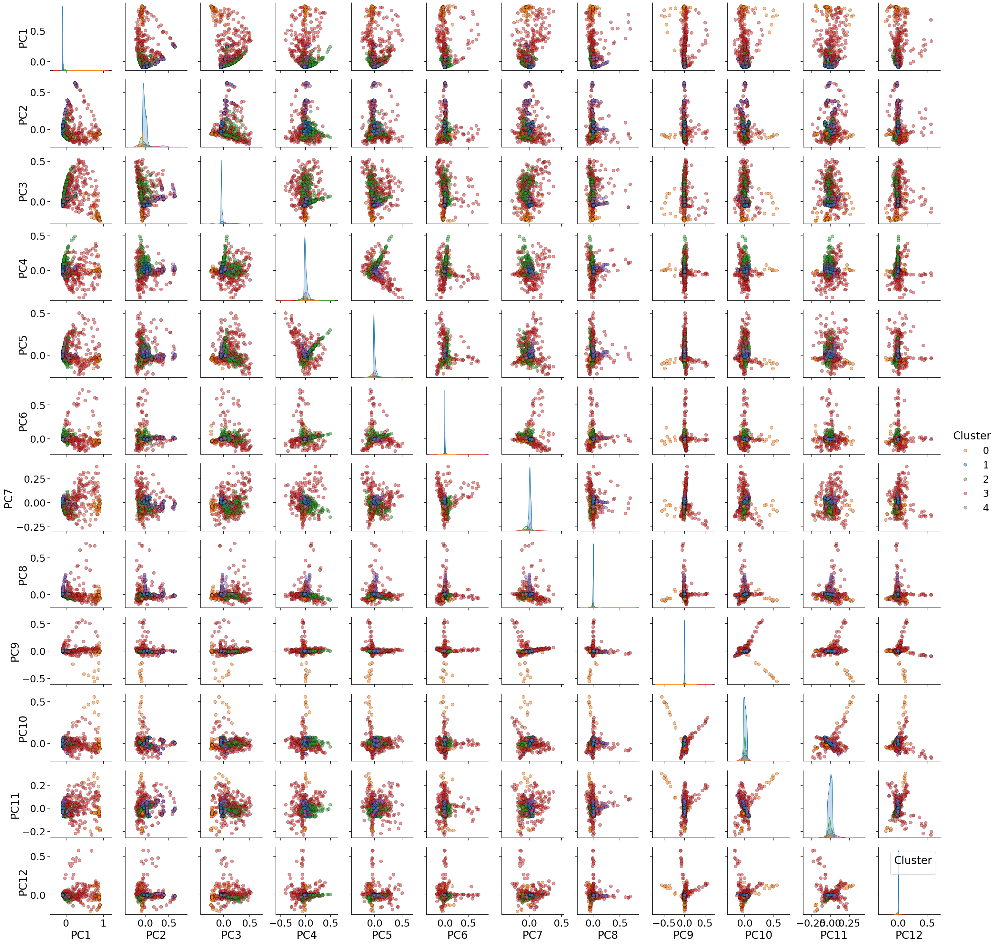

In [29]:
from matplotlib.colors import ListedColormap
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Assuming X_kpca, df_final_combined, and clusters are already defined

# Convert the Kernel PCA result into a DataFrame
n_components = X_kpca.shape[1]  # Number of principal components
kpca_df = pd.DataFrame(X_kpca, columns=[f'PC{i+1}' for i in range(n_components)], index=df_final_combined.index)
kpca_df['Cluster'] = clusters

# Define the colors for the clusters
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']

discrete_cmap = ListedColormap(colors)

# Set the font scale
sns.set_context("notebook", font_scale=2)  # Adjust font_scale as needed

# Create a pair plot of the first six principal components colored by cluster
pair_plot = sns.pairplot(kpca_df.iloc[:, :13], hue='Cluster', palette=colors, diag_kind='kde', 
                         plot_kws={'alpha':0.5, 's':50, 'edgecolor':'k'}, height=2.5)

# Adjust legend font size
plt.legend(title='Cluster', fontsize='20', title_fontsize='24')
plt.show()


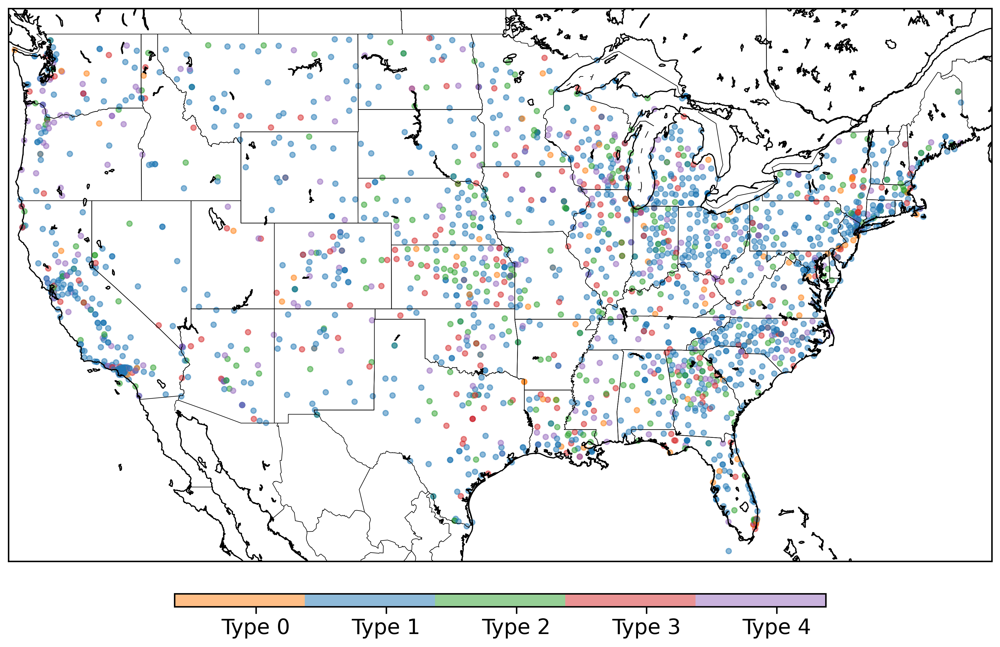

In [30]:
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
import pandas as pd
from matplotlib.colors import ListedColormap

# Ensure 'clusters' is a factor (discrete)
clusters = pd.Series(clusters).astype('category')

# Create a discrete colormap
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']
discrete_cmap = ListedColormap(colors)

# Initialize the Basemap for Kernel PCA clusters
fig, ax = plt.subplots(figsize=(15, 10), dpi=300)
m = Basemap(projection='merc', llcrnrlat=24, urcrnrlat=50, llcrnrlon=-125, urcrnrlon=-66, lat_ts=0, resolution='i', ax=ax)

# Draw coastlines, countries, and states
m.drawcoastlines()
m.drawcountries()
m.drawstates()

# Convert latitude and longitude to map projection coordinates
x, y = m(df_final_combined['Longitude'].values, df_final_combined['Latitude'].values)

# Plot the clusters with discrete colors using the custom colormap
scatter = ax.scatter(x, y, c=clusters.cat.codes, cmap=discrete_cmap, s=20, alpha=0.5)

# Add a color bar with discrete values and make it horizontal at the bottom
cbar = plt.colorbar(scatter, ax=ax, orientation='horizontal', fraction=0.02, pad=0.05, aspect=50)
cbar.set_ticks([0.5, 1.3, 2.1, 2.9, 3.7])
cbar.set_ticklabels(['Type 0', 'Type 1', 'Type 2', 'Type 3', 'Type 4'])

# Set the position of the color bar
cbar.ax.xaxis.set_ticks_position('bottom')
cbar.ax.xaxis.set_label_position('bottom')

# Adjust the font size of the color bar ticks
cbar.ax.tick_params(labelsize=18)  # Change the font size as needed

plt.show()


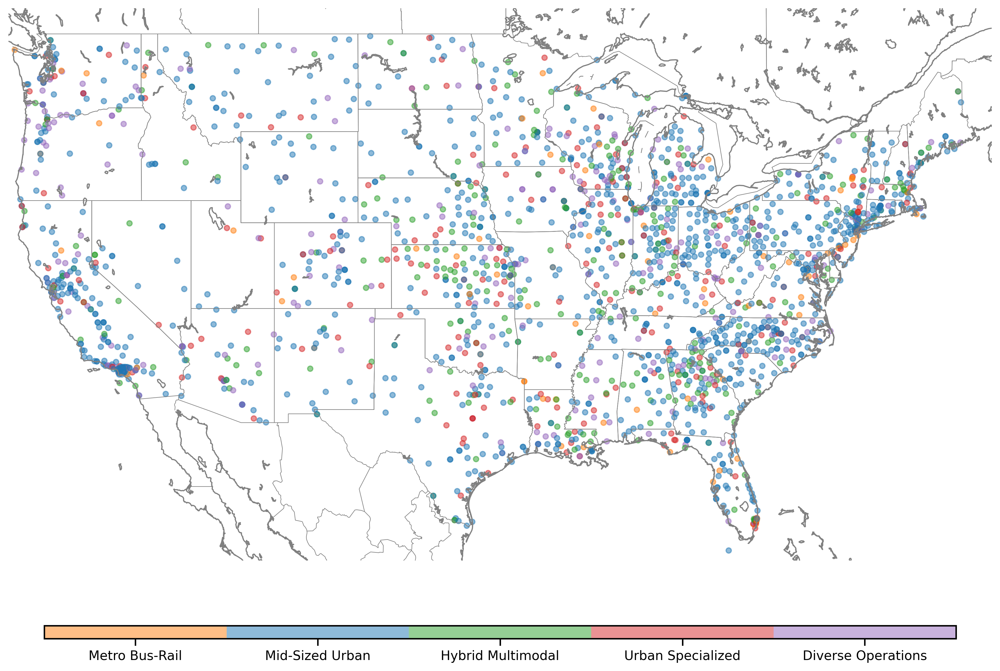

In [31]:
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
import pandas as pd
from matplotlib.colors import ListedColormap

# Ensure 'clusters' is a factor (discrete)
clusters = pd.Series(clusters).astype('category')

# Create a discrete colormap
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']
discrete_cmap = ListedColormap(colors)

# Initialize the Basemap for Kernel PCA clusters
fig, ax = plt.subplots(figsize=(15, 10), dpi=300)
m = Basemap(projection='merc', llcrnrlat=24, urcrnrlat=50, llcrnrlon=-125, urcrnrlon=-66, lat_ts=0, resolution='i', ax=ax)

# Draw coastlines, countries, and states with gray boundaries
m.drawcoastlines(color='gray')
m.drawcountries(color='gray')
m.drawstates(color='gray')

# Convert latitude and longitude to map projection coordinates
x, y = m(df_final_combined['Longitude'].values, df_final_combined['Latitude'].values)

# Plot the clusters with discrete colors using the custom colormap
scatter = ax.scatter(x, y, c=clusters.cat.codes, cmap=discrete_cmap, s=20, alpha=0.5)

# Add a color bar with discrete values and make it horizontal at the bottom
cbar = plt.colorbar(scatter, ax=ax, orientation='horizontal', fraction=0.02, pad=0.1, aspect=70)
cbar.set_ticks([0.4, 1.2, 2, 2.8, 3.6])
#cbar.set_ticklabels(['Metropolitan multi-modal', 'Specialized urban systems', 'Hybrid urban-rural', 'Medium urban multi-modal', 'Diverse operations'])
cbar.set_ticklabels(['Metro Bus-Rail', 'Mid-Sized Urban', 'Hybrid Multimodal', 'Urban Specialized', 'Diverse Operations'])


# Set the position of the color bar
cbar.ax.xaxis.set_ticks_position('bottom')
cbar.ax.xaxis.set_label_position('bottom')

# Adjust the font size of the color bar ticks
cbar.ax.tick_params(labelsize=11)  # Reduced the font size

# Remove the border around the plot
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

plt.show()


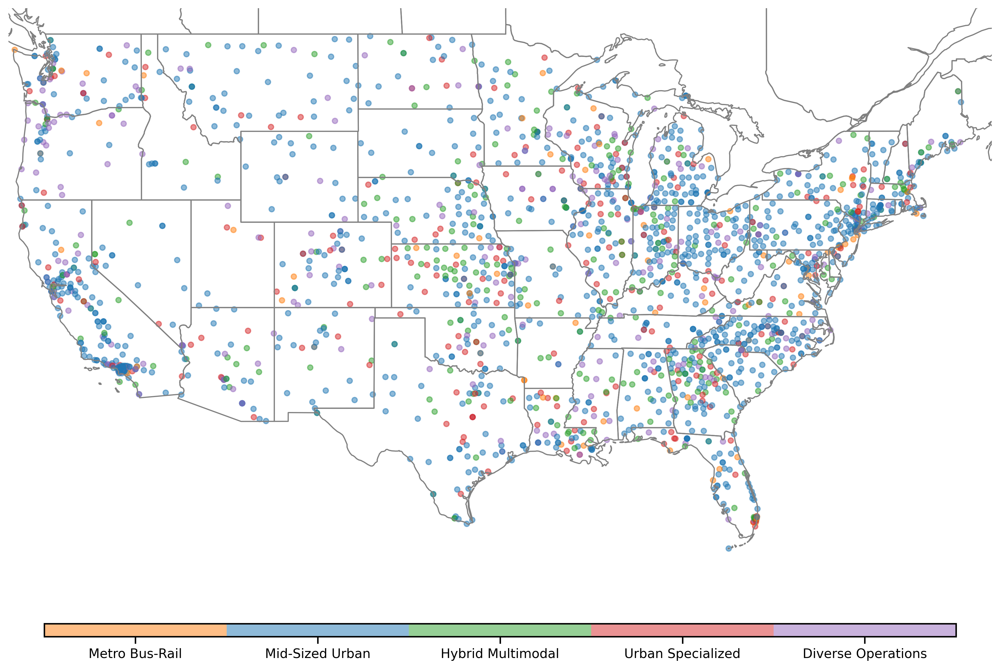

In [32]:
import matplotlib.pyplot as plt
import pandas as pd
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import ListedColormap

# Assuming 'clusters' and 'df_final_combined' are defined
# Ensure 'clusters' is a factor (discrete)
clusters = pd.Series(clusters).astype('category')

# Create a discrete colormap
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']
discrete_cmap = ListedColormap(colors)

# Initialize the map with cartopy
fig, ax = plt.subplots(figsize=(15, 10), dpi=300, subplot_kw={'projection': ccrs.Mercator()})
ax.set_extent([-125, -66, 24, 50], crs=ccrs.PlateCarree())

# Add coastlines and state boundaries, but no country boundaries
#ax.add_feature(cfeature.COASTLINE, edgecolor='gray')
ax.add_feature(cfeature.STATES, edgecolor='gray')

# Convert latitude and longitude to map projection coordinates
sc = ax.scatter(df_final_combined['Longitude'], df_final_combined['Latitude'], 
                c=clusters.cat.codes, cmap=discrete_cmap, s=20, alpha=0.5, 
                transform=ccrs.PlateCarree())

# Add a color bar with discrete values and make it horizontal at the bottom
cbar = plt.colorbar(sc, ax=ax, orientation='horizontal', fraction=0.02, pad=0.1, aspect=70)
cbar.set_ticks([0.4, 1.2, 2, 2.8, 3.6])
#cbar.set_ticklabels(['Metro Bus-Rail', 'Mid-Urban Multimodal', 'Hybrid Multimodal', 'Urban Specialized', 'Diverse Operations'])
cbar.set_ticklabels(['Metro Bus-Rail', 'Mid-Sized Urban', 'Hybrid Multimodal', 'Urban Specialized', 'Diverse Operations'])


# Set the position of the color bar
cbar.ax.xaxis.set_ticks_position('bottom')
cbar.ax.xaxis.set_label_position('bottom')

# Adjust the font size of the color bar ticks
cbar.ax.tick_params(labelsize=11)  # Reduced the font size

# Remove plot borders (spines)
ax.spines['geo'].set_visible(False)

plt.show()


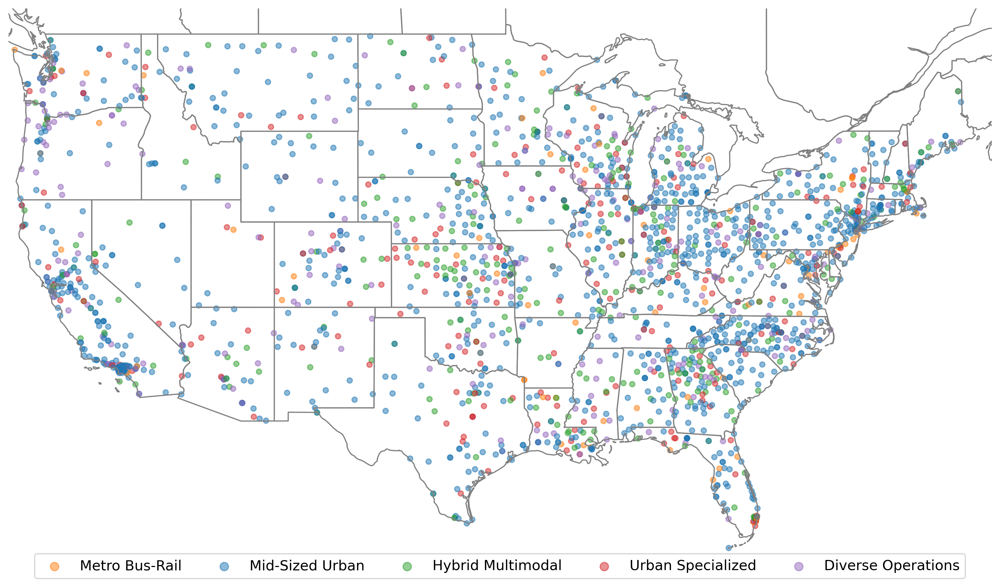

In [33]:
# Assuming 'clusters' and 'df_final_combined' are defined
# Ensure 'clusters' is a factor (discrete)
clusters = pd.Series(clusters).astype('category')

# Create a discrete colormap
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']
discrete_cmap = ListedColormap(colors)

# Initialize the map with cartopy
fig, ax = plt.subplots(figsize=(15, 10), dpi=300, subplot_kw={'projection': ccrs.Mercator()})
ax.set_extent([-125, -66, 24, 50], crs=ccrs.PlateCarree())

# Add coastlines and state boundaries, but no country boundaries
ax.add_feature(cfeature.STATES, edgecolor='gray')

# Convert latitude and longitude to map projection coordinates
sc = ax.scatter(df_final_combined['Longitude'], df_final_combined['Latitude'], 
                c=clusters.cat.codes, cmap=discrete_cmap, s=20, alpha=0.5, 
                transform=ccrs.PlateCarree())

# Custom legend using scatter plot to replicate the circles in the plot
#labels = ['Metro Bus-Rail', 'Mid-Urban Multimodal', 'Hybrid Multimodal', 'Urban Specialized', 'Diverse Operations']
labels = ['Metro Bus-Rail', 'Mid-Sized Urban', 'Hybrid Multimodal', 'Urban Specialized', 'Diverse Operations']

handles = [plt.scatter([], [], color=color, s=50, alpha=0.5) for color in colors]

# Add the custom legend
plt.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.05), ncol=5, fontsize=12, title="")

# Remove plot borders (spines)
ax.spines['geo'].set_visible(False)

plt.show()


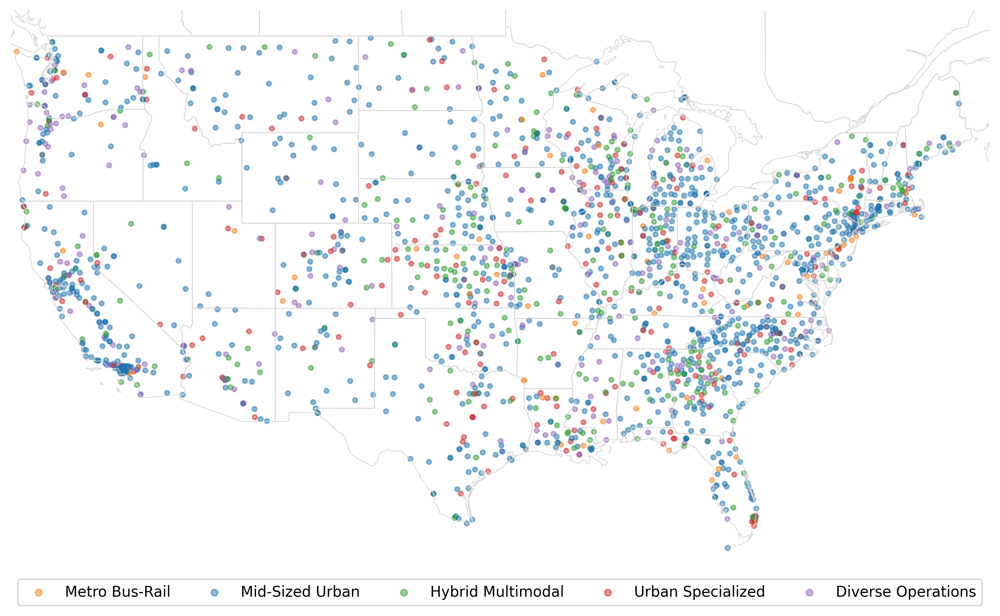

In [ ]:
fig, ax = plt.subplots(figsize=(12, 7), dpi=300, subplot_kw={'projection': ccrs.Mercator()})
ax.set_extent([-125, -66, 24, 50], crs=ccrs.PlateCarree())

# Add lighter state boundaries
ax.add_feature(cfeature.STATES, edgecolor='lightgray', linewidth=0.5)

# Adjust dot size for smaller map
sc = ax.scatter(df_final_combined['Longitude'], df_final_combined['Latitude'], 
                c=clusters.cat.codes, cmap=discrete_cmap, s=10, alpha=0.5, 
                transform=ccrs.PlateCarree())

# Custom legend
#labels = ['Metro Bus-Rail', 'Mid-Urban Multimodal', 'Hybrid Multimodal', 'Urban Specialized', 'Diverse Operations']
labels = ['Metro Bus-Rail', 'Mid-Sized Urban', 'Hybrid Multimodal', 'Urban Specialized', 'Diverse Operations']

handles = [plt.scatter([], [], color=color, s=20, alpha=0.5) for color in colors]

plt.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.1), ncol=5, fontsize=10, title="")
ax.spines['geo'].set_visible(False)
plt.show()


In [ ]:
# Define the mapping of clusters to names
cluster_names = {
    0: 'Metro Bus-Rail',
    1: 'Mid-Sized Urban', #'Mid-Urban Multimodal',
    2: 'Hybrid Multimodal',
    3: 'Urban Specialized',
    4: 'Diverse Operations'
}

# Map the clusters to names
df_final_combined['Cluster Name'] = df_final_combined['Cluster'].map(cluster_names)

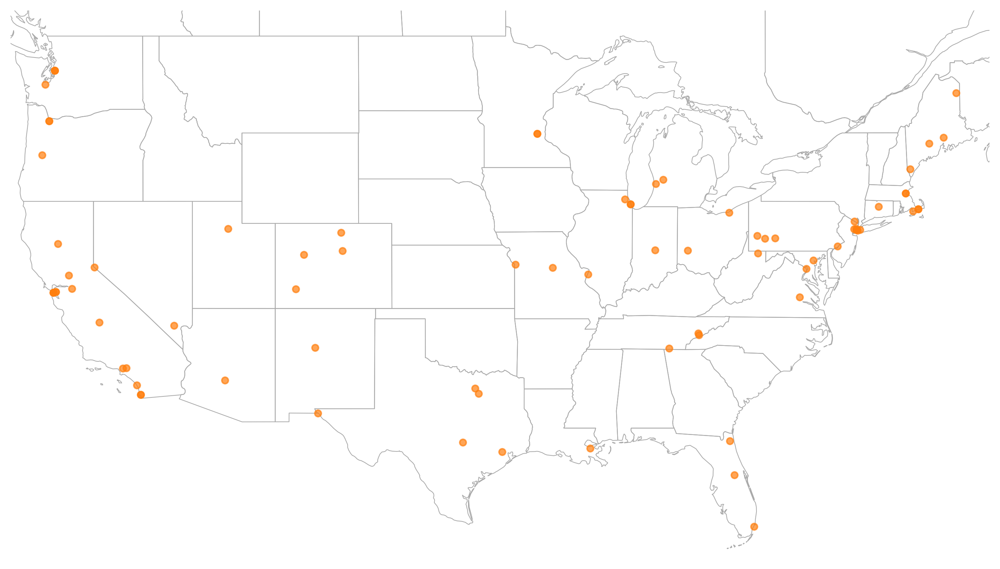

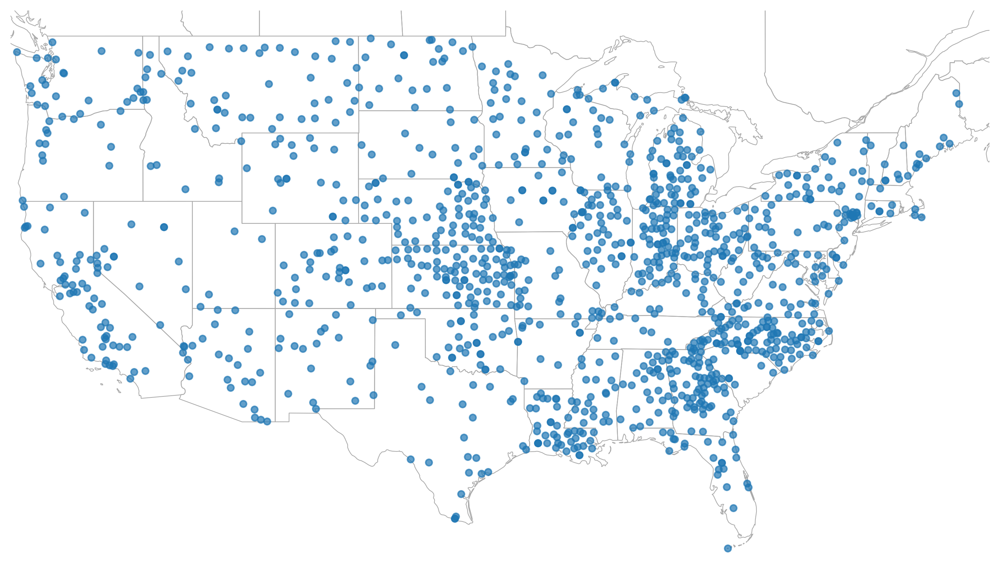

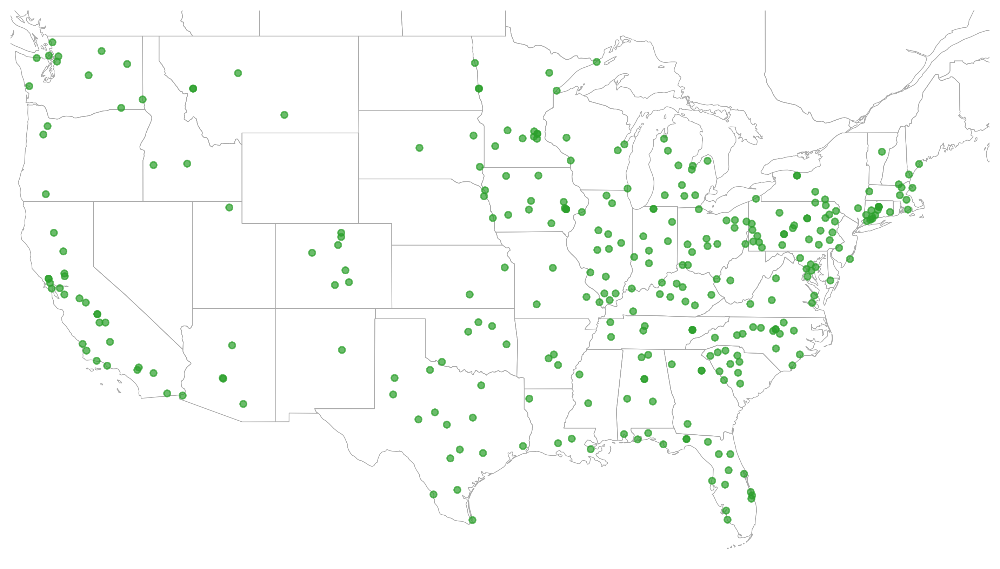

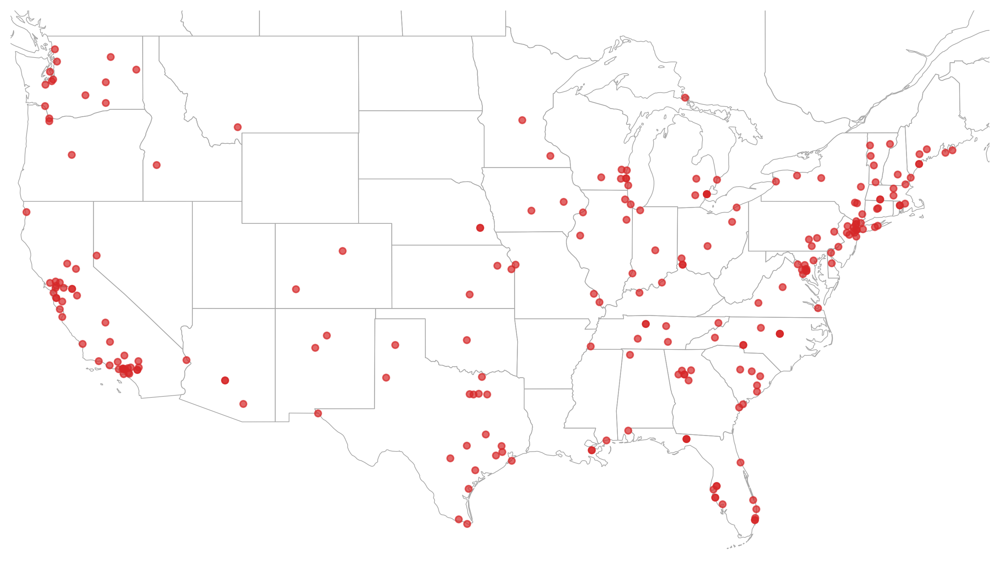

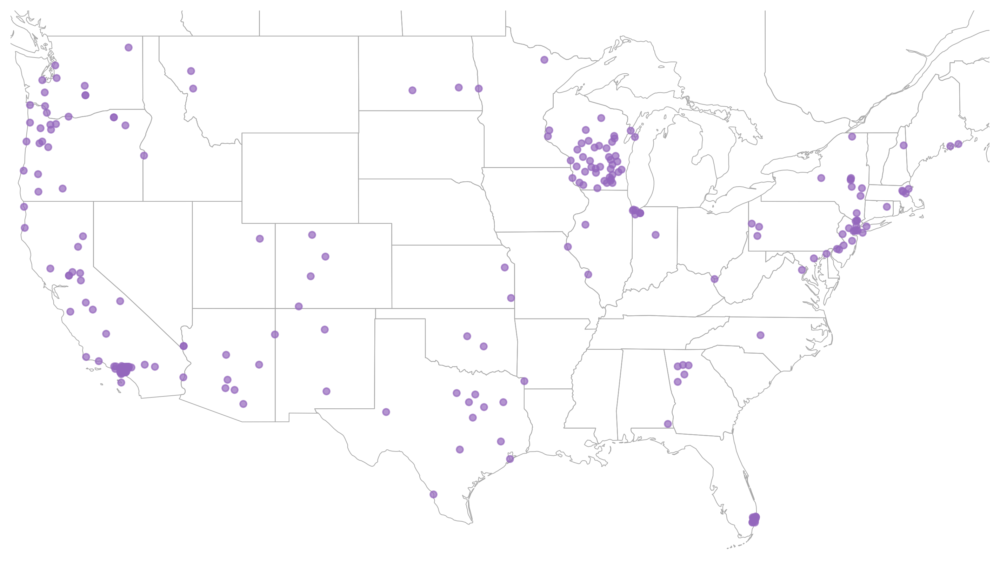

In [ ]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Define cluster categories and custom colors
cluster_labels = ['Metro Bus-Rail', 'Mid-Sized Urban', 'Hybrid Multimodal', 'Urban Specialized', 'Diverse Operations']
cluster_colors = ['#E69F00', '#56B4E9', '#009E73', '#D55E00', '#CC79A7']  # Custom colors
cluster_colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']


# Loop through each cluster type and generate a separate map
for label, color in zip(cluster_labels, cluster_colors):
    fig, ax = plt.subplots(figsize=(12, 7), dpi=300, subplot_kw={'projection': ccrs.Mercator()})
    ax.set_extent([-125, -66, 24, 50], crs=ccrs.PlateCarree())

    # Add state boundaries for better visualization
    ax.add_feature(cfeature.STATES, edgecolor='darkgray', linewidth=0.5, zorder=1)

    # Filter data for the current cluster
    cluster_data = df_final_combined[df_final_combined['Cluster Name'] == label]

    # Plot the points
    ax.scatter(cluster_data['Longitude'], cluster_data['Latitude'], color=color, s=20, alpha=0.7, transform=ccrs.PlateCarree(), zorder=2)

    # Title for each individual figure
    #ax.set_title(f"{label} Transit Systems", fontsize=14)

    ax.spines['geo'].set_visible(False)

    plt.show()


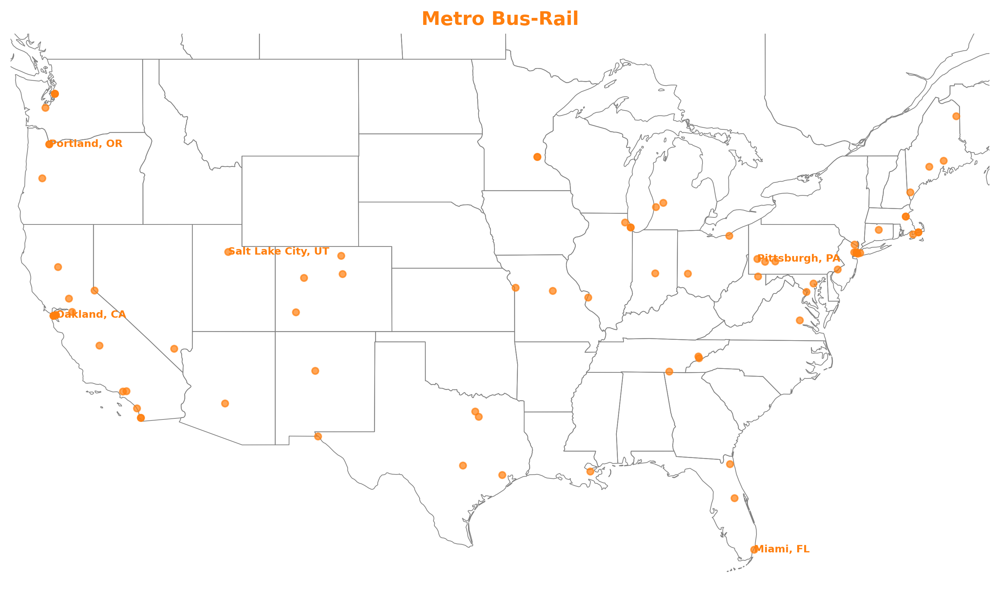

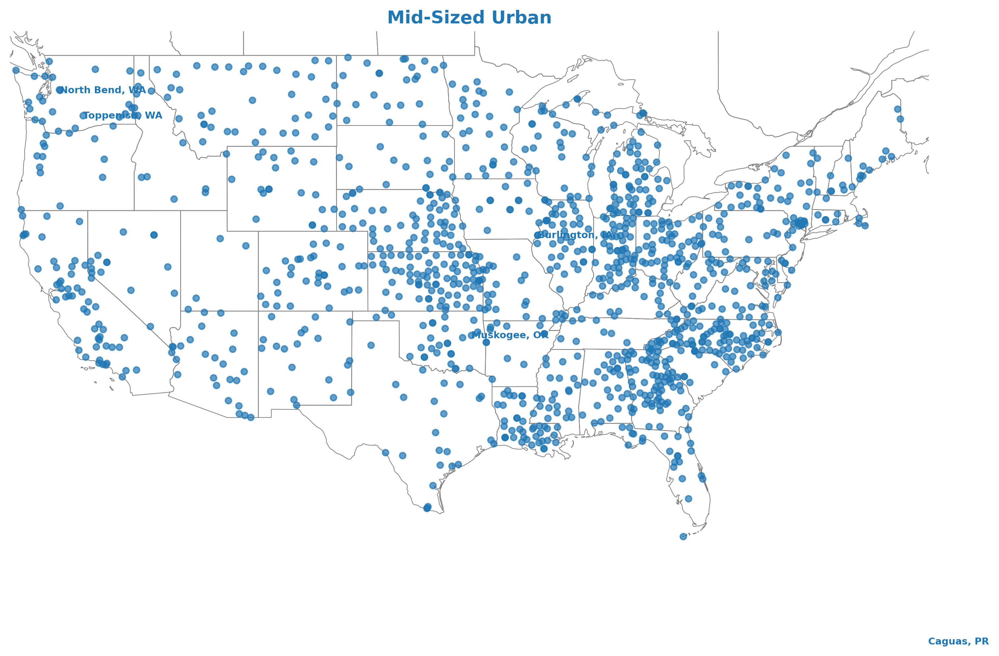

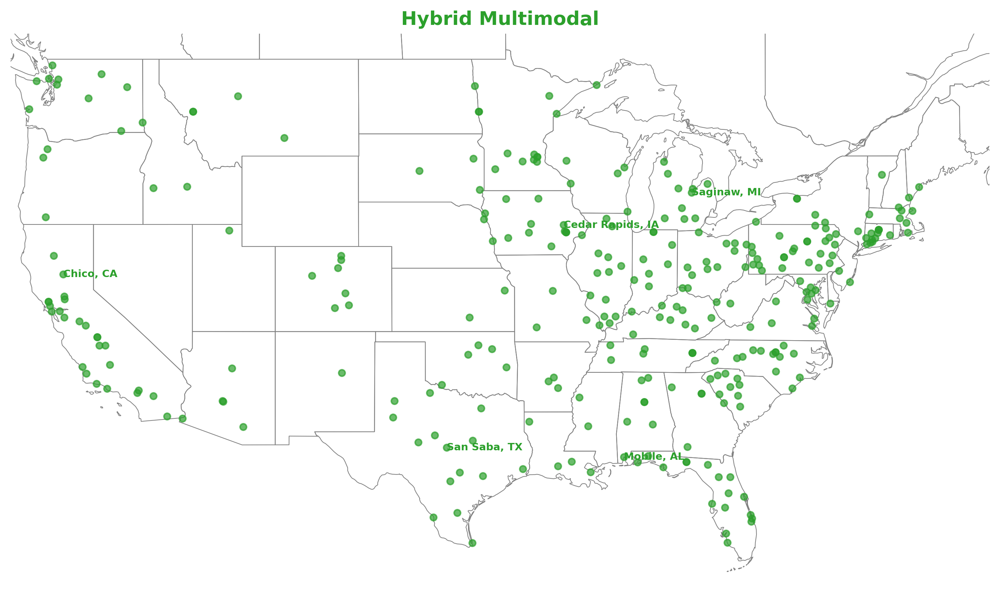

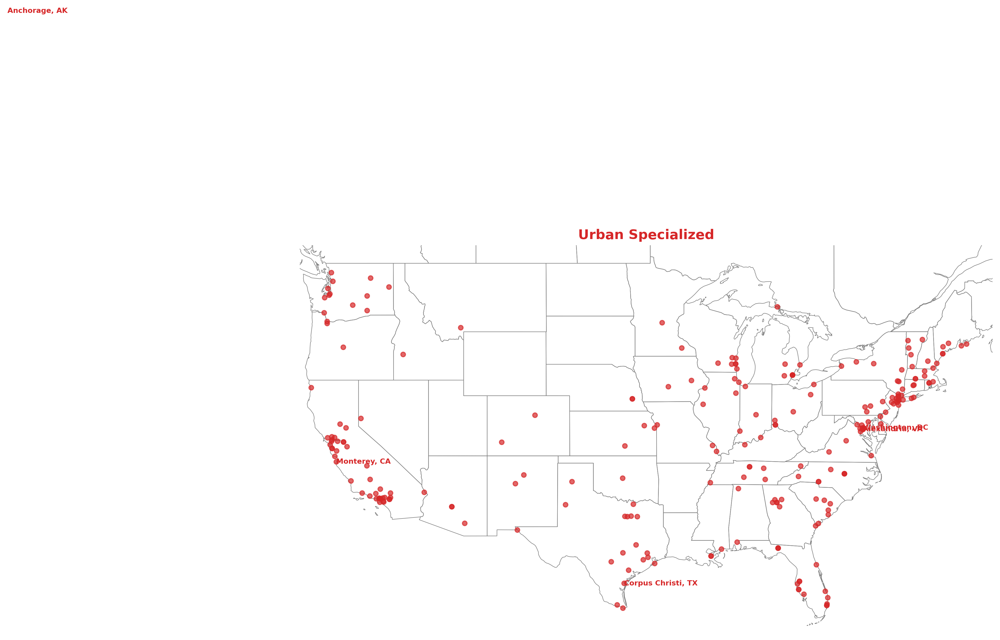

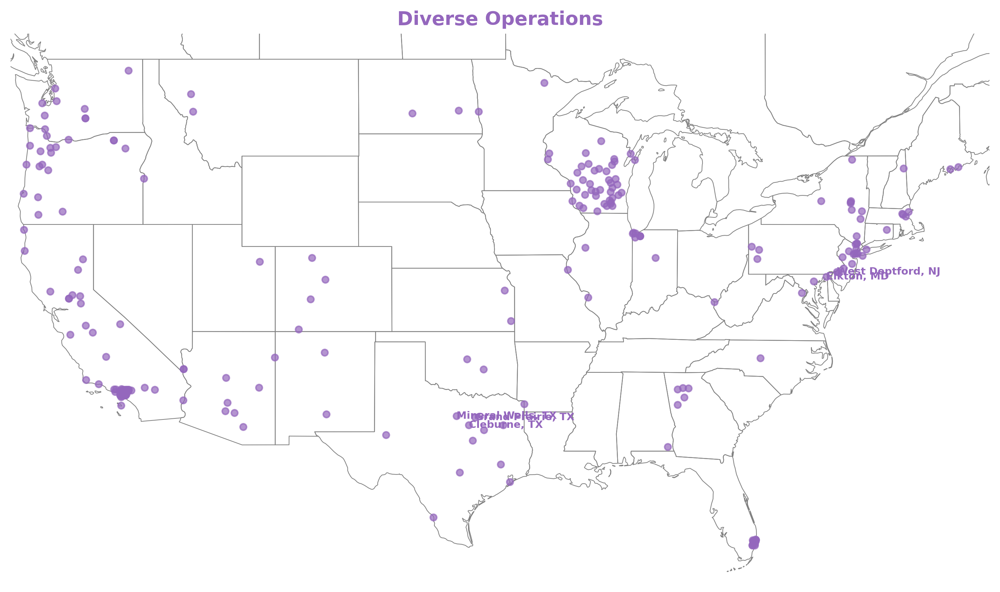

In [ ]:
# Create a mapping from cluster index to cluster label for consistent filtering
cluster_map = {
    0: 'Metro Bus-Rail',
    1: 'Mid-Sized Urban',
    2: 'Hybrid Multimodal',
    3: 'Urban Specialized',
    4: 'Diverse Operations'
}
cluster_colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']

# Loop through each cluster
for cluster_id, (label, color) in enumerate(zip(cluster_map.values(), cluster_colors)):
    fig, ax = plt.subplots(figsize=(12, 7), dpi=300, subplot_kw={'projection': ccrs.Mercator()})
    ax.set_extent([-125, -66, 24, 50], crs=ccrs.PlateCarree())
    #ax.set_extent([-180, -60, 15, 72], crs=ccrs.PlateCarree()) # This include Mainland U.S., Alaska, Hawaii, and Puerto Rico


    # Add U.S. state borders
    ax.add_feature(cfeature.STATES, edgecolor='gray', linewidth=0.5, zorder=1)

    # Filter main data for this cluster
    cluster_data = df_final_combined[df_final_combined['Cluster Name'] == label]
    ax.scatter(cluster_data['Longitude'], cluster_data['Latitude'], color=color, s=20, alpha=0.7, transform=ccrs.PlateCarree(), zorder=2)

    # Plot city labels for top 5 closest systems to centroid in this cluster
    top_5 = top_5_closest[top_5_closest['Cluster'] == cluster_id]
    for _, row in top_5.iterrows():
        ax.text(
            row['Longitude'], row['Latitude'],
            f"{row['City']}, {row['State']}",
            transform=ccrs.PlateCarree(),
            fontsize=7, weight='bold', color=color,
            ha='left', va='center', zorder=3
        )

    # Optional title
    ax.set_title(label, fontsize=13, weight='bold', color=color)
    ax.spines['geo'].set_visible(False)

    plt.show()


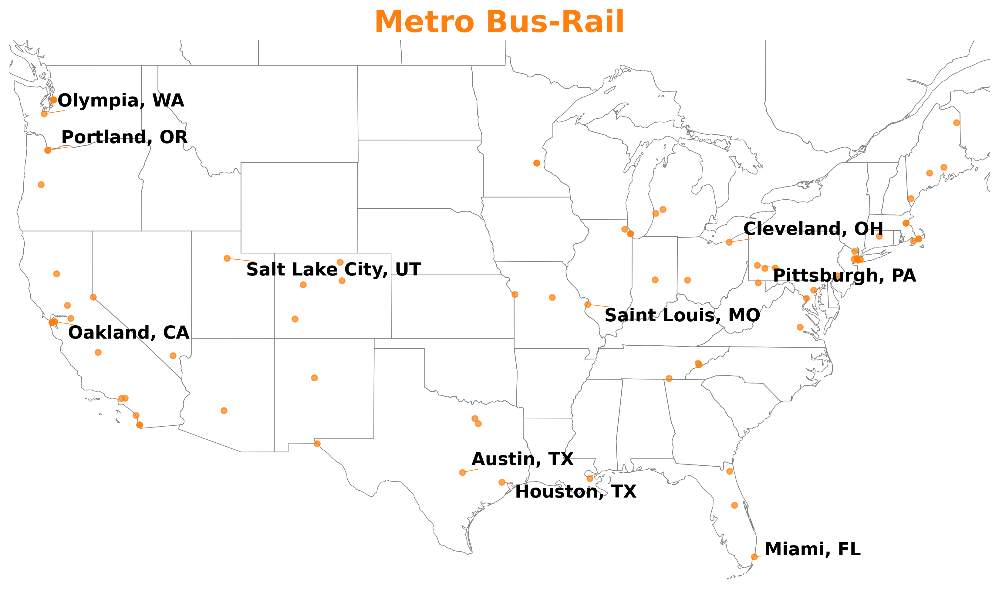

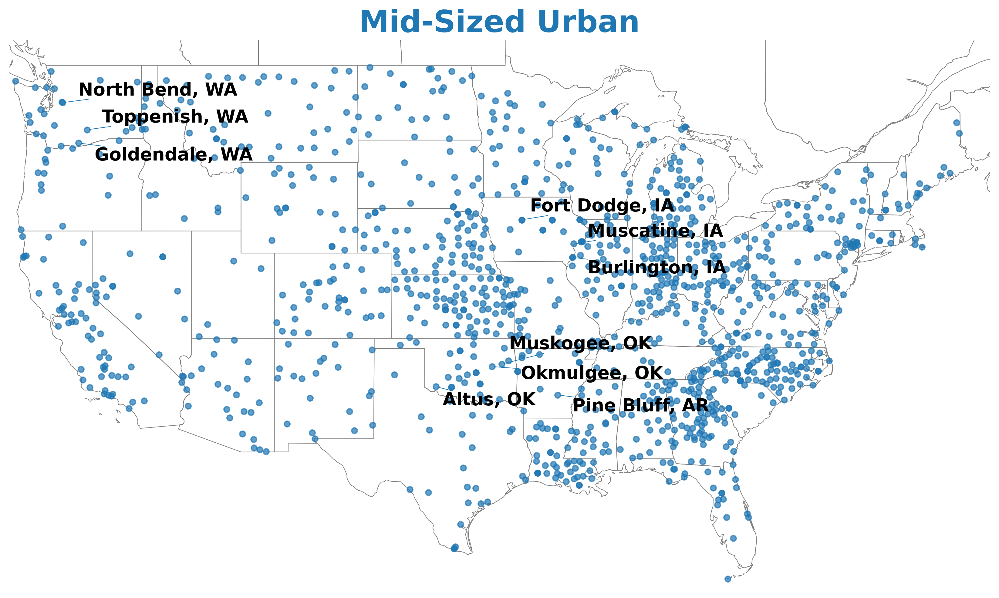

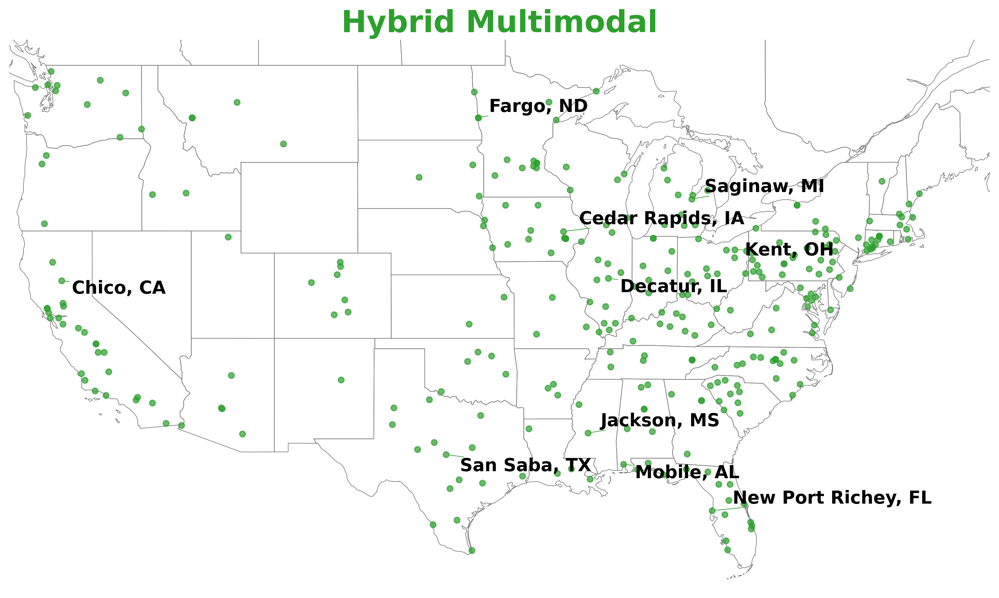

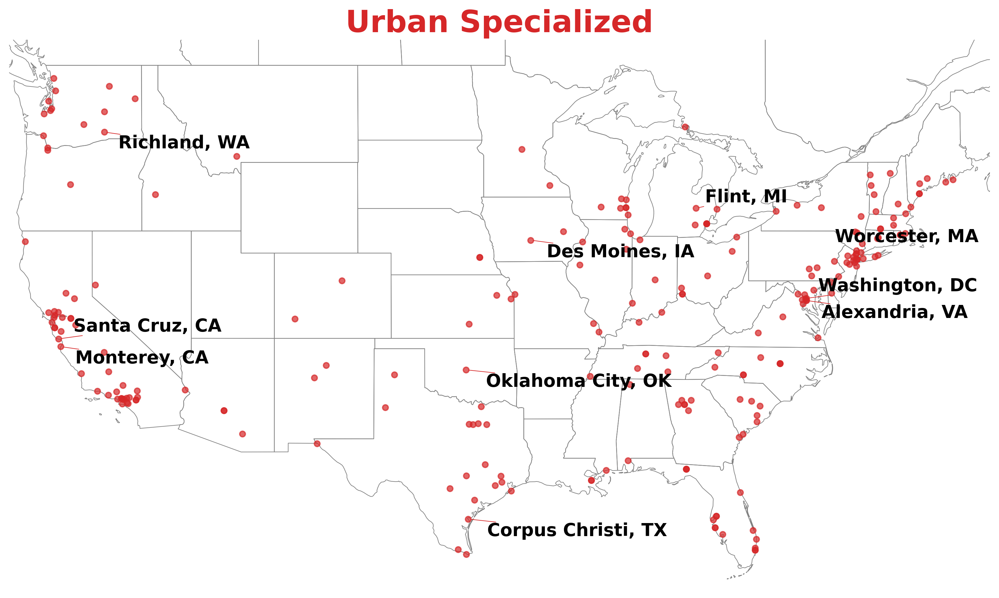

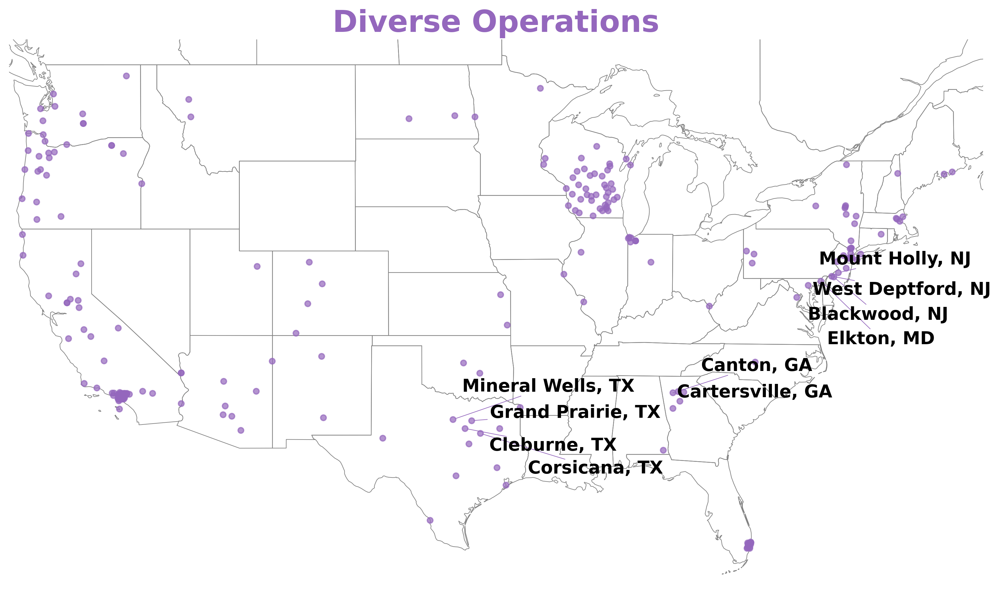

In [43]:
from adjustText import adjust_text

# Define geographic bounds for contiguous U.S.
us_bounds = {
    'lon_min': -125,
    'lon_max': -66.5,
    'lat_min': 24,
    'lat_max': 50
}

# Step 1: Filter to agencies within contiguous U.S.
df_us_only = df_final_combined[
    (df_final_combined['Longitude'] >= us_bounds['lon_min']) &
    (df_final_combined['Longitude'] <= us_bounds['lon_max']) &
    (df_final_combined['Latitude'] >= us_bounds['lat_min']) &
    (df_final_combined['Latitude'] <= us_bounds['lat_max'])
]

# Step 2: Sort by cluster and distance to centroid
df_us_only = df_us_only.sort_values(by=['Cluster', 'Distance_to_Centroid'])

# Step 3: Take top N closest per cluster 
N = 10
#top_n_closest_us = df_us_only.groupby('Cluster').head(N)
top_n_closest_us = (
    df_us_only
    .drop_duplicates(subset=['City', 'State', 'Cluster'])  # remove duplicate city-state-cluster
    .sort_values(by=['Cluster', 'Distance_to_Centroid'])
    .groupby('Cluster')
    .head(N)
)


# Cluster labels and colors
cluster_map = {
    0: 'Metro Bus-Rail',
    1: 'Mid-Sized Urban',
    2: 'Hybrid Multimodal',
    3: 'Urban Specialized',
    4: 'Diverse Operations'
}
cluster_colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']

# Loop through clusters
for cluster_id, (label, color) in enumerate(zip(cluster_map.values(), cluster_colors)):
    fig, ax = plt.subplots(figsize=(12, 7), dpi=300, subplot_kw={'projection': ccrs.Mercator()})
    ax.set_extent([-125, -66, 24, 50], crs=ccrs.PlateCarree())

    # Add state boundaries
    ax.add_feature(cfeature.STATES, edgecolor='gray', linewidth=0.5, zorder=1)

    # Plot all systems in this cluster
    cluster_data = df_final_combined[df_final_combined['Cluster Name'] == label]
    ax.scatter(
        cluster_data['Longitude'], cluster_data['Latitude'],
        color=color, s=20, alpha=0.7,
        transform=ccrs.PlateCarree(), zorder=2
    )

    # Get top 10 in contiguous U.S.
    top_n = top_n_closest_us[top_n_closest_us['Cluster'] == cluster_id]

    # Add labels with adjustText
    texts = []
    for _, row in top_n.iterrows():
        texts.append(
            ax.text(
                row['Longitude'], row['Latitude'],
                f"{row['City']}, {row['State']}",
                transform=ccrs.PlateCarree(),
                fontsize=14, weight='bold', color='black',
                ha='left', va='center', zorder=3,
                #bbox=dict(boxstyle="round,pad=0.5", fc="white", ec="gray", alpha=0.8)
            )
        )

    adjust_text(
        texts,
        only_move={'points': 'y', 'texts': 'y'},
        arrowprops=dict(arrowstyle='-', color=color, lw=0.5),
        ax=ax
    )

    # Title
    ax.set_title(label, fontsize=24, weight='bold', color=color)
    ax.spines['geo'].set_visible(False)

    plt.tight_layout()
    plt.show()


In [ ]:
# Select only numeric columns
numeric_cols = df_final_combined.select_dtypes(include=['number']).columns

# Calculate average key indicators by cluster type for numeric columns
average_indicators = df_final_combined.groupby('Cluster')[numeric_cols].mean()

# Display the average indicators for reference
average_indicators

In [ ]:
average_indicators[['Mode VOMS_MB','Mode VOMS_HR','Mode VOMS_LR']]

In [ ]:
## Select the top 10 most important features based on mean feature importance
#top_n = 20

#mean_importance = feature_importances.mean(axis=1)
#top_features = mean_importance.nlargest(top_n).index

## Select the key indicators based on the top features
#key_indicators = average_indicators[top_features]

## Display the table with key indicators
#print("Key Indicators by Cluster Type:")
#key_indicators

In [ ]:
df_final_combined.loc[df_final_combined['Cluster']==4]

In [ ]:
# Expanded list of notable examples with their respective cities
notable_examples = {
    "MTA New York City Transit": "New York",
    "Los Angeles Metro": "Los Angeles",
    "Miami-Dade Transit": "Miami",
    "San Francisco Muni": "San Francisco",
    "Spokane Transit Authority": "Spokane",
    "Missoula Urban Transportation District": "Missoula",
    "Denver RTD": "Denver",
    "Minneapolis Metro Transit": "Minneapolis",
    "King County Metro": "Seattle",
    "Chicago Transit Authority (CTA)": "Chicago",
    "Washington Metropolitan Area Transit Authority (WMATA)": "Washington",
    "Boston MBTA": "Boston",
    "Philadelphia SEPTA": "Philadelphia",
    "Portland TriMet": "Portland",
    "Atlanta MARTA": "Atlanta",
    "Houston METRO": "Houston",
    "Dallas DART": "Dallas",
    "San Diego MTS": "San Diego",
    "San Jose VTA": "San Jose",
    "Phoenix Valley Metro": "Phoenix",
    "St. Louis Metro": "St. Louis",
    "Baltimore MTA": "Baltimore",
    "Cleveland RTA": "Cleveland",
    "Salt Lake City UTA": "Salt Lake City",
    "Pittsburgh Port Authority": "Pittsburgh",
    "Sacramento RT": "Sacramento",
    "Charlotte CATS": "Charlotte",
    "Orlando LYNX": "Orlando",
    "Austin Capital Metro": "Austin"
}

# Function to check clusters for notable examples
def check_clusters(df, examples):
    results = []
    for agency, city in examples.items():
        cluster = df.loc[(df['City'] == city)].get('Cluster', 'Not Found')
        results.append({'Agency': agency, 'City': city, 'Cluster': cluster.values[0] if not cluster.empty else 'Not Found'})
    return pd.DataFrame(results)

# Assuming df_final_combined is the DataFrame with all information including 'Cluster' and 'City'
cluster_results = check_clusters(df_final_combined, notable_examples)

# Display the results
cluster_results


In [ ]:
df_final_combined[['City', 'State', 'Cluster', 'Cluster Name']].loc[df_final_combined['Cluster']==0].head(20)

In [ ]:
df_final_combined[['City', 'State', 'Cluster', 'Cluster Name']].loc[(df_final_combined['Cluster'] == 4) & (df_final_combined['State'] == 'OR')]


In [ ]:
df_final_combined[['City', 'State', 'Cluster', 'Cluster Name']].loc[(df_final_combined['Cluster'] == 4)].tail(30)


In [ ]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

# Assuming best_gmm and X_kpca are already defined and best_gmm is fitted

# Fit the model to the Kernel PCA transformed data and predict the clusters
clusters = best_gmm.fit_predict(X_kpca)

# Convert the Kernel PCA result into a DataFrame
n_components = X_kpca.shape[1]  # Number of principal components
kpca_df = pd.DataFrame(X_kpca, columns=[f'PC{i+1}' for i in range(n_components)], index=df_final_combined.index)

# Add the clusters to your dataframe
kpca_df['Cluster'] = clusters

# Define the colors for the clusters
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']
sns.set_palette(sns.color_palette(colors))

# Set the font scale
sns.set_context("notebook", font_scale=1.5)  # Adjust font_scale as needed

# Create a violin plot for each of the twelve principal components by cluster
fig, axes = plt.subplots(3, 3, figsize=(18, 18))

for i, ax in enumerate(axes.flat):
    if i < 9:
        pc_column = f'PC{i+1}'
        sns.violinplot(x='Cluster', y=pc_column, data=kpca_df, palette=colors, ax=ax)
        #ax.set_title(f'PC{i+1}')

plt.tight_layout()
plt.show()


In [ ]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

# Assuming best_gmm and X_kpca are already defined and best_gmm is fitted

# Fit the model to the Kernel PCA transformed data and predict the clusters
clusters = best_gmm.fit_predict(X_kpca)

# Convert the Kernel PCA result into a DataFrame
n_components = X_kpca.shape[1]  # Number of principal components
kpca_df = pd.DataFrame(X_kpca, columns=[f'PC{i+1}' for i in range(n_components)], index=df_final_combined.index)

# Add the clusters to your dataframe, adding one to start clusters from 1 instead of 0
kpca_df['Cluster'] = clusters + 1

# Define the colors for the clusters
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']
sns.set_palette(sns.color_palette(colors))

# Set the font scale
sns.set_context("notebook", font_scale=1.5)  # Adjust font_scale as needed

# Descriptions for the kernel principal components
pc_descriptions = [
    "Operating scale",
    "Urban area characteristics",
    "Passenger demand",
    "Commuter operations",
    "Commuter demand response",
    "Vanpool operations",
    "Motor bus and vanpool costs",
    "Taxi ridership and hours",
    "Ferryboat and rapid bus",
    "Rapid bus and geographic scale",
    "Rural area characteristics",
    "Commuter rail demand"
]

# Create a violin plot for each of the twelve principal components by cluster
fig, axes = plt.subplots(3, 3, figsize=(18, 18))

for i, ax in enumerate(axes.flat):
    if i < 9:
        pc_column = f'PC{i+1}'
        sns.violinplot(x='Cluster', y=pc_column, data=kpca_df, palette=colors, ax=ax)
        ax.set_ylabel(pc_descriptions[i], fontsize=18)  # Match y-axis label size to x-axis
        ax.set_xlabel('Cluster', fontsize=18)  # Ensure x-axis label size is set

plt.tight_layout()
plt.show()


In [ ]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

# Assuming best_gmm and X_kpca are already defined and best_gmm is fitted

# Fit the model to the Kernel PCA transformed data and predict the clusters
clusters = best_gmm.fit_predict(X_kpca)

# Convert the Kernel PCA result into a DataFrame
n_components = X_kpca.shape[1]  # Number of principal components
kpca_df = pd.DataFrame(X_kpca, columns=[f'PC{i+1}' for i in range(n_components)], index=df_final_combined.index)

# Add the clusters to your dataframe
kpca_df['Cluster'] = clusters

# Define the mapping of clusters to names
cluster_names = {
    0: 'Metro Bus-Rail',
    1: 'Mid-Sized Urban', #'Mid-Urban Multimodal',
    2: 'Hybrid Multimodal',
    3: 'Urban Specialized',
    4: 'Diverse Operations'
}

# Map the clusters to names
kpca_df['Cluster Name'] = kpca_df['Cluster'].map(cluster_names)

# Define the colors for the clusters
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']

colors = ['#ff7f0e', '#d62728', '#2ca02c', '#1f77b4', '#9467bd']

sns.set_palette(sns.color_palette(colors))

# Set the font scale
sns.set_context("notebook", font_scale=1.5)  # Adjust font_scale as needed

# Descriptions for the kernel principal components
pc_descriptions = [
    "Operating scale",
    "Urban area characteristics",
    "Passenger demand",
    "Commuter operations",
    "Commuter demand response",
    "Vanpool operations",
    "Motor bus and vanpool costs",
    "Taxi ridership and hours",
    "Ferryboat and rapid bus",
    "Rapid bus and geographic scale",
    "Rural area characteristics",
    "Commuter rail demand"
]

# Create a violin plot for each of the twelve principal components by cluster
fig, axes = plt.subplots(3, 3, figsize=(18, 18))

for i, ax in enumerate(axes.flat):
    if i < 9:
        pc_column = f'PC{i+1}'
        sns.violinplot(y='Cluster Name', x=pc_column, data=kpca_df, palette=colors, ax=ax, orient='h')
        ax.set_xlabel(pc_descriptions[i], fontsize=18)  # Match x-axis label size to y-axis
        if i % 3 != 0:  # If not in the left column
            ax.set_ylabel('')
            ax.set_yticklabels([])
        else:
            ax.set_ylabel('', fontsize=18)

plt.tight_layout()
plt.show()


## Explained Variance Contribution

In [ ]:
df_final_combined['Cluster'].unique()

In [ ]:
# Plot explained variance for the selected components
explained_variance = pca.explained_variance_ratio_[:12]
cumulative_explained_variance = np.cumsum(explained_variance)

plt.figure(figsize=(10, 6), dpi=300)
plt.bar(range(1, 13), explained_variance, alpha=0.7, label='Individual explained variance')
plt.step(range(1, 13), cumulative_explained_variance, where='mid', label='Cumulative explained variance', color='red')
plt.xlabel('Principal component', fontsize=16)
plt.ylabel('Explained variance ratio', fontsize=16)
plt.xticks(range(1, 13), fontsize=14)
plt.yticks(fontsize=14)
plt.legend(loc='best', fontsize=14)
plt.show()


## Feature Importance in PCs

In [ ]:
## Retrieve the loadings of the original features on the principal components
#loadings = pd.DataFrame(pca.components_.T[:, :7], columns=[f'PC{i+1}' for i in range(7)], index=df_scaled.columns)

## Plot the loadings
#plt.figure(figsize=(14, 8), dpi=300)
#sns.heatmap(loadings, annot=True, cmap='coolwarm')
##plt.title('Feature Loadings on Principal Components', fontsize=16)
#plt.show()


In [ ]:
# Project the original features onto the principal components to approximate loadings
approx_loadings = np.dot(df_scaled.T, X_kpca) / np.sum(X_kpca**2, axis=0)

# Create a DataFrame for the loadings
loadings = pd.DataFrame(approx_loadings, columns=[f'PC{i+1}' for i in range(12)], index=df_scaled.columns)

# Plot the loadings
plt.figure(figsize=(50, 50), dpi=300)
sns.heatmap(loadings, annot=True, cmap='coolwarm')
#plt.title('Approximate Feature Loadings on Principal Components', fontsize=16)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestRegressor

# Initialize a DataFrame to store feature importances
feature_importances = pd.DataFrame(index=df_scaled.columns)

# Train a Random Forest Regressor for each principal component
for i in range(X_kpca.shape[1]):
    # Use the ith principal component as the target
    y = X_kpca[:, i]

    # Train a Random Forest Regressor
    rf = RandomForestRegressor(n_estimators=100, random_state=42)
    rf.fit(df_scaled, y)

    # Extract feature importances
    feature_importances[f'PC{i+1}'] = rf.feature_importances_

# Get the top 5-10 most important variables for each principal component
top_features_per_pc = pd.DataFrame()
for pc in feature_importances.columns:
    top_features = feature_importances[pc].nlargest(10)
    top_features_per_pc = pd.concat([top_features_per_pc, top_features], axis=1)

# Ensure all principal components are present
#top_features_per_pc = top_features_per_pc.reindex(feature_importances.columns, axis=1).fillna(0)

In [ ]:
# Plotting
plt.figure(figsize=(20, 20), dpi=300)  
heatmap = sns.heatmap(top_features_per_pc, annot=True, cmap='RdYlGn', cbar_kws={'label': 'Feature importance'}, annot_kws={"size": 10})

plt.xlabel('Principal components', fontsize=18)
plt.ylabel('Features', fontsize=18)

# Adjust the font size of tick labels
plt.xticks(fontsize=12)  
plt.yticks(fontsize=12)

# Adjust colorbar font size and color
cbar = heatmap.collections[0].colorbar
cbar.ax.tick_params(labelsize=16) 
cbar.ax.yaxis.label.set_size(16) 

plt.tight_layout()
plt.show()

In [ ]:
# Initialize a DataFrame to store feature importances
feature_importances = pd.DataFrame(index=df_scaled.columns)

# Train a Random Forest Regressor for each principal component
for i in range(X_kpca.shape[1]):
    # Use the ith principal component as the target
    y = X_kpca[:, i]

    # Train a Random Forest Regressor
    rf = RandomForestRegressor(n_estimators=100, random_state=42)
    rf.fit(df_scaled, y)

    # Extract feature importances
    feature_importances[f'PC{i+1}'] = rf.feature_importances_

# Get the top 10 most important variables for each principal component
top_n = 10
for pc in feature_importances.columns:
    top_features = feature_importances[pc].nlargest(top_n)

    # Plotting each PC separately
    plt.figure(figsize=(11, 6), dpi=300)
    sns.barplot(x=top_features.values, y=top_features.index, color='green')
    #plt.title(f'Top {top_n} Features for {pc}', fontsize=16)
    plt.xlabel('Feature Importance', fontsize=22)
    plt.ylabel('Features', fontsize=22)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    plt.tight_layout()
    plt.show()


In [ ]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor

# Assuming df_scaled and X_kpca are already defined and the Random Forest Regressors are fitted

# Initialize a DataFrame to store feature importances
feature_importances = pd.DataFrame(index=df_scaled.columns)

# Train a Random Forest Regressor for each principal component
for i in range(X_kpca.shape[1]):
    # Use the ith principal component as the target
    y = X_kpca[:, i]

    # Train a Random Forest Regressor
    rf = RandomForestRegressor(n_estimators=100, random_state=42)
    rf.fit(df_scaled, y)

    # Extract feature importances
    feature_importances[f'PC{i+1}'] = rf.feature_importances_

# Dictionary for more readable variable names including modes
variable_names = {
    'Actual Vehicle/Passenger Car Miles': 'Total Vehicle Miles',
    'OpExp VO': 'Vehicle Operating Expenses',
    'OpExp VM': 'Vehicle Maintenance Expenses',
    'OpExp NVM': 'Non-Vehicle Maintenance Expenses',
    'OpExp GA': 'General Administrative Expenses',
    'Operating': 'Total Operating Expenses',
    'Capital': 'Total Capital Expenses',
    'Agency VOMS': 'Total Agency Vehicles',
    'UZA Area SQ Miles': 'Urban Area Size',
    'UZA Population': 'Urban Area Population',
    'Days of Service Operated': 'Service Days Operated',
    'Days Not Operated Due to Emergencies': 'Emergency Service Days Not Operated',
    'Non-Statutory Mixed Traffic': 'Non-Statutory Mixed Traffic',
    'DRM Mixed Traffic ROW': 'Demand Response Mixed Traffic',
    'FARES_AR': 'Fare Revenues (Aerial Tramway)',
    'FARES_CB': 'Fare Revenues (Commuter Bus)',
    'FARES_CC': 'Fare Revenues (Cable Car)',
    'FARES_CR': 'Fare Revenues (Commuter Rail)',
    'FARES_DR': 'Fare Revenues (Demand Response)',
    'FARES_DT': 'Fare Revenues (Demand Response Taxi)',
    'FARES_FB': 'Fare Revenues (Ferryboat)',
    'FARES_HR': 'Fare Revenues (Heavy Rail)',
    'FARES_IP': 'Fare Revenues (Inclined Plane)',
    'FARES_JT': 'Fare Revenues (Jitney)',
    'FARES_LR': 'Fare Revenues (Light Rail)',
    'FARES_MB': 'Fare Revenues (Motorbus)',
    'FARES_MG': 'Fare Revenues (Monorail)',
    'FARES_OR': 'Fare Revenues (Other)',
    'FARES_OT': 'Fare Revenues (Other Transit)',
    'FARES_PB': 'Fare Revenues (Public Bike)',
    'FARES_RB': 'Fare Revenues (Rapid Bus)',
    'FARES_SR': 'Fare Revenues (Streetcar Rail)',
    'FARES_TB': 'Fare Revenues (Trolleybus)',
    'FARES_TR': 'Fare Revenues (Tram)',
    'FARES_VP': 'Fare Revenues (Vanpool)',
    'FARES_YR': 'Fare Revenues (Hybrid Rail)',
    'DRM_AR': 'Demand Response Miles (Aerial Tramway)',
    'DRM_CB': 'Demand Response Miles (Commuter Bus)',
    'DRM_CC': 'Demand Response Miles (Cable Car)',
    'DRM_CR': 'Demand Response Miles (Commuter Rail)',
    'DRM_DR': 'Demand Response Miles (Demand Response)',
    'DRM_DT': 'Demand Response Miles (Demand Response Taxi)',
    'DRM_FB': 'Demand Response Miles (Ferryboat)',
    'DRM_HR': 'Demand Response Miles (Heavy Rail)',
    'DRM_IP': 'Demand Response Miles (Inclined Plane)',
    'DRM_JT': 'Demand Response Miles (Jitney)',
    'DRM_LR': 'Demand Response Miles (Light Rail)',
    'DRM_MB': 'Demand Response Miles (Motorbus)',
    'DRM_MG': 'Demand Response Miles (Monorail)',
    'DRM_OR': 'Demand Response Miles (Other)',
    'DRM_OT': 'Demand Response Miles (Other Transit)',
    'DRM_PB': 'Demand Response Miles (Public Bike)',
    'DRM_RB': 'Demand Response Miles (Rapid Bus)',
    'DRM_SR': 'Demand Response Miles (Streetcar Rail)',
    'DRM_TB': 'Demand Response Miles (Trolleybus)',
    'DRM_TR': 'Demand Response Miles (Tram)',
    'DRM_VP': 'Demand Response Miles (Vanpool)',
    'DRM_YR': 'Demand Response Miles (Hybrid Rail)',
    'VRM_AR': 'Vehicle Revenue Miles (Aerial Tramway)',
    'VRM_CB': 'Vehicle Revenue Miles (Commuter Bus)',
    'VRM_CC': 'Vehicle Revenue Miles (Cable Car)',
    'VRM_CR': 'Vehicle Revenue Miles (Commuter Rail)',
    'VRM_DR': 'Vehicle Revenue Miles (Demand Response)',
    'VRM_DT': 'Vehicle Revenue Miles (Demand Response Taxi)',
    'VRM_FB': 'Vehicle Revenue Miles (Ferryboat)',
    'VRM_HR': 'Vehicle Revenue Miles (Heavy Rail)',
    'VRM_IP': 'Vehicle Revenue Miles (Inclined Plane)',
    'VRM_JT': 'Vehicle Revenue Miles (Jitney)',
    'VRM_LR': 'Vehicle Revenue Miles (Light Rail)',
    'VRM_MB': 'Vehicle Revenue Miles (Motorbus)',
    'VRM_MG': 'Vehicle Revenue Miles (Monorail)',
    'VRM_OR': 'Vehicle Revenue Miles (Other)',
    'VRM_OT': 'Vehicle Revenue Miles (Other Transit)',
    'VRM_PB': 'Vehicle Revenue Miles (Public Bike)',
    'VRM_RB': 'Vehicle Revenue Miles (Rapid Bus)',
    'VRM_SR': 'Vehicle Revenue Miles (Streetcar Rail)',
    'VRM_TB': 'Vehicle Revenue Miles (Trolleybus)',
    'VRM_TR': 'Vehicle Revenue Miles (Tram)',
    'VRM_VP': 'Vehicle Revenue Miles (Vanpool)',
    'VRM_YR': 'Vehicle Revenue Miles (Hybrid Rail)',
    'VRH_AR': 'Vehicle Revenue Hours (Aerial Tramway)',
    'VRH_CB': 'Vehicle Revenue Hours (Commuter Bus)',
    'VRH_CC': 'Vehicle Revenue Hours (Cable Car)',
    'VRH_CR': 'Vehicle Revenue Hours (Commuter Rail)',
    'VRH_DR': 'Vehicle Revenue Hours (Demand Response)',
    'VRH_DT': 'Vehicle Revenue Hours (Demand Response Taxi)',
    'VRH_FB': 'Vehicle Revenue Hours (Ferryboat)',
    'VRH_HR': 'Vehicle Revenue Hours (Heavy Rail)',
    'VRH_IP': 'Vehicle Revenue Hours (Inclined Plane)',
    'VRH_JT': 'Vehicle Revenue Hours (Jitney)',
    'VRH_LR': 'Vehicle Revenue Hours (Light Rail)',
    'VRH_MB': 'Vehicle Revenue Hours (Motorbus)',
    'VRH_MG': 'Vehicle Revenue Hours (Monorail)',
    'VRH_OR': 'Vehicle Revenue Hours (Other)',
    'VRH_OT': 'Vehicle Revenue Hours (Other Transit)',
    'VRH_PB': 'Vehicle Revenue Hours (Public Bike)',
    'VRH_RB': 'Vehicle Revenue Hours (Rapid Bus)',
    'VRH_SR': 'Vehicle Revenue Hours (Streetcar Rail)',
    'VRH_TB': 'Vehicle Revenue Hours (Trolleybus)',
    'VRH_TR': 'Vehicle Revenue Hours (Tram)',
    'VRH_VP': 'Vehicle Revenue Hours (Vanpool)',
    'VRH_YR': 'Vehicle Revenue Hours (Hybrid Rail)',
    'UPT_AR': 'Passenger Trips (Aerial Tramway)',
    'UPT_CB': 'Passenger Trips (Commuter Bus)',
    'UPT_CC': 'Passenger Trips (Cable Car)',
    'UPT_CR': 'Passenger Trips (Commuter Rail)',
    'UPT_DR': 'Passenger Trips (Demand Response)',
    'UPT_DT': 'Passenger Trips (Demand Response Taxi)',
    'UPT_FB': 'Passenger Trips (Ferryboat)',
    'UPT_HR': 'Passenger Trips (Heavy Rail)',
    'UPT_IP': 'Passenger Trips (Inclined Plane)',
    'UPT_JT': 'Passenger Trips (Jitney)',
    'UPT_LR': 'Passenger Trips (Light Rail)',
    'UPT_MB': 'Passenger Trips (Motorbus)',
    'UPT_MG': 'Passenger Trips (Monorail)',
    'UPT_OR': 'Passenger Trips (Other)',
    'UPT_OT': 'Passenger Trips (Other Transit)',
    'UPT_PB': 'Passenger Trips (Public Bike)',
    'UPT_RB': 'Passenger Trips (Rapid Bus)',
    'UPT_SR': 'Passenger Trips (Streetcar Rail)',
    'UPT_TB': 'Passenger Trips (Trolleybus)',
    'UPT_TR': 'Passenger Trips (Tram)',
    'UPT_VP': 'Passenger Trips (Vanpool)',
    'UPT_YR': 'Passenger Trips (Hybrid Rail)',
    'PMT_AR': 'Passenger Miles Traveled (Aerial Tramway)',
    'PMT_CB': 'Passenger Miles Traveled (Commuter Bus)',
    'PMT_CC': 'Passenger Miles Traveled (Cable Car)',
    'PMT_CR': 'Passenger Miles Traveled (Commuter Rail)',
    'PMT_DR': 'Passenger Miles Traveled (Demand Response)',
    'PMT_DT': 'Passenger Miles Traveled (Demand Response Taxi)',
    'PMT_FB': 'Passenger Miles Traveled (Ferryboat)',
    'PMT_HR': 'Passenger Miles Traveled (Heavy Rail)',
    'PMT_IP': 'Passenger Miles Traveled (Inclined Plane)',
    'PMT_JT': 'Passenger Miles Traveled (Jitney)',
    'PMT_LR': 'Passenger Miles Traveled (Light Rail)',
    'PMT_MB': 'Passenger Miles Traveled (Motorbus)',
    'PMT_MG': 'Passenger Miles Traveled (Monorail)',
    'PMT_OR': 'Passenger Miles Traveled (Other)',
    'PMT_OT': 'Passenger Miles Traveled (Other Transit)',
    'PMT_PB': 'Passenger Miles Traveled (Public Bike)',
    'PMT_RB': 'Passenger Miles Traveled (Rapid Bus)',
    'PMT_SR': 'Passenger Miles Traveled (Streetcar Rail)',
    'PMT_TB': 'Passenger Miles Traveled (Trolleybus)',
    'PMT_TR': 'Passenger Miles Traveled (Tram)',
    'PMT_VP': 'Passenger Miles Traveled (Vanpool)',
    'PMT_YR': 'Passenger Miles Traveled (Hybrid Rail)',
    'Mode VOMS_RB': 'Agency Vehicles (Rapid Bus)',
    'Mode VOMS_FB': 'Agency Vehicles (Ferryboat)',
    'RevenueHours_DR': 'Vehicle Revenue Hours (Demand Response)',
    'PassengerTrips_DR': 'Passenger Trips (Demand Response)',
    'PassengerMiles_CB': 'Passenger Miles (Commuter Bus)',
    'PassengerMiles_DR': 'Passenger Miles (Demand Response)',
    'DemandRespMiles_MB': 'Demand Response Miles (Motorbus)',  
    'Mode VOMS_VP': 'Agency Vehicles (Vanpool)',
    
}

# Rename the columns in the DataFrame
df_scaled.rename(columns=variable_names, inplace=True)

# Get the top 5 most important variables for each principal component
top_n = 5

# Define the titles for each principal component based on the descriptions
pc_titles = [
    'Operating scale',
    'Urban area characteristics',
    'Passenger demand',
    'Commuter operations',
    'Commuter demand response',
    'Vanpool operations',
    'Motor bus and vanpool costs',
    'Taxi ridership and hours',
    'Ferryboat and rapid bus',
    'Rapid bus and geographic scale',
    'Rural area characteristics',
    'Commuter rail demand'
]

fig, axes = plt.subplots(4, 3, figsize=(25, 20), dpi=300)

for i, ax in enumerate(axes.flat):
    if i < X_kpca.shape[1]:
        pc = f'PC{i+1}'
        top_features = feature_importances[pc].nlargest(top_n)

        sns.barplot(x=top_features.values, y=top_features.index, ax=ax, color='steelblue')
        ax.set_xlabel('Feature Importance', fontsize=16)
        ax.set_ylabel('')
        ax.set_title(pc_titles[i], fontsize=18)
        ax.tick_params(axis='x', labelsize=14)
        ax.tick_params(axis='y', labelsize=14)

plt.tight_layout()
plt.show()


In [ ]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor

# Assuming df_scaled and X_kpca are already defined and the Random Forest Regressors are fitted

# Initialize a DataFrame to store feature importances
feature_importances = pd.DataFrame(index=df_scaled.columns)

# Train a Random Forest Regressor for each principal component
for i in range(X_kpca.shape[1]):
    # Use the ith principal component as the target
    y = X_kpca[:, i]

    # Train a Random Forest Regressor
    rf = RandomForestRegressor(n_estimators=100, random_state=42)
    rf.fit(df_scaled, y)

    # Extract feature importances
    feature_importances[f'PC{i+1}'] = rf.feature_importances_

# Dictionary for more readable variable names including modes
variable_names = {
    'Actual Vehicle/Passenger Car Miles': 'Total Vehicle Miles',
    'OpExp VO': 'Vehicle Operating EXP',
    'OpExp VM': 'Vehicle Maintenance EXP',
    'OpExp NVM': 'Non-Vehicle Maintenance EXP',
    'OpExp GA': 'General Administrative EXP',
    'Operating': 'Total Operating EXP',
    'Capital': 'Total Capital EXP',
    'Agency VOMS': 'Agency Total Vehicles',
    'UZA Area SQ Miles': 'Urban Area',
    'UZA Population': 'Urban Area Population',
    'Days of Service Operated': 'Service Days Operated',
    'Days Not Operated Due to Emergencies': 'Emergency Service Days Not Operated',
    'Non-Statutory Mixed Traffic': 'Non-Statutory Mixed Traffic',
    'DRM Mixed Traffic ROW': 'Demand Response Mixed Traffic',
    'FARES_AR': 'Fare Revenues (Alaska Railroad)',
    'FARES_CB': 'Fare Revenues (Commuter Bus)',
    'FARES_CC': 'Fare Revenues (Cable Car)',
    'FARES_CR': 'Fare Revenues (Commuter Rail)',
    'FARES_DR': 'Fare Revenues (Demand Response)',
    'FARES_DT': 'Fare Revenues (Demand Taxi)',
    'FARES_FB': 'Fare Revenues (Ferryboat)',
    'FARES_HR': 'Fare Revenues (Heavy Rail)',
    'FARES_IP': 'Fare Revenues (Inclined Plane)',
    'FARES_JT': 'Fare Revenues (Jitney)',
    'FARES_LR': 'Fare Revenues (Light Rail)',
    'FARES_MB': 'Fare Revenues (Bus)',
    'FARES_MG': 'Fare Revenues (Monorail)',
    'FARES_OR': 'Fare Revenues (Other)',
    'FARES_OT': 'Fare Revenues (Other Transit)',
    'FARES_PB': 'Fare Revenues (Publico)',
    'FARES_RB': 'Fare Revenues (Bus Rapid Transit)',
    'FARES_SR': 'Fare Revenues (Streetcar)',
    'FARES_TB': 'Fare Revenues (Trolleybus)',
    'FARES_TR': 'Fare Revenues (Aerial Tramway)',
    'FARES_VP': 'Fare Revenues (Vanpool)',
    'FARES_YR': 'Fare Revenues (Hybrid Rail)',
    'DRM_AR': 'Demand Response Miles (Alaska Railroad)',
    'DRM_CB': 'Demand Response Miles (Commuter Bus)',
    'DRM_CC': 'Demand Response Miles (Cable Car)',
    'DRM_CR': 'Demand Response Miles (Commuter Rail)',
    'DRM_DR': 'Demand Response Miles (Demand Response)',
    'DRM_DT': 'Demand Response Miles (Demand Taxi)',
    'DRM_FB': 'Demand Response Miles (Ferryboat)',
    'DRM_HR': 'Demand Response Miles (Heavy Rail)',
    'DRM_IP': 'Demand Response Miles (Inclined Plane)',
    'DRM_JT': 'Demand Response Miles (Jitney)',
    'DRM_LR': 'Demand Response Miles (Light Rail)',
    'DRM_MB': 'Demand Response Miles (Bus)',
    'DRM_MG': 'Demand Response Miles (Monorail)',
    'DRM_OR': 'Demand Response Miles (Other)',
    'DRM_OT': 'Demand Response Miles (Other Transit)',
    'DRM_PB': 'Demand Response Miles (Publico)',
    'DRM_RB': 'Demand Response Miles (Bus Rapid Transit)',
    'DRM_SR': 'Demand Response Miles (Streetcar)',
    'DRM_TB': 'Demand Response Miles (Trolleybus)',
    'DRM_TR': 'Demand Response Miles (Tram)',
    'DRM_VP': 'Demand Response Miles (Vanpool)',
    'DRM_YR': 'Demand Response Miles (Hybrid Rail)',
    'VRM_AR': 'Vehicle Revenue Miles (Alaska Railroad)',
    'VRM_CB': 'Vehicle Revenue Miles (Commuter Bus)',
    'VRM_CC': 'Vehicle Revenue Miles (Cable Car)',
    'VRM_CR': 'Vehicle Revenue Miles (Commuter Rail)',
    'VRM_DR': 'Vehicle Revenue Miles (Demand Response)',
    'VRM_DT': 'Vehicle Revenue Miles (Demand Taxi)',
    'VRM_FB': 'Vehicle Revenue Miles (Ferryboat)',
    'VRM_HR': 'Vehicle Revenue Miles (Heavy Rail)',
    'VRM_IP': 'Vehicle Revenue Miles (Inclined Plane)',
    'VRM_JT': 'Vehicle Revenue Miles (Jitney)',
    'VRM_LR': 'Vehicle Revenue Miles (Light Rail)',
    'VRM_MB': 'Vehicle Revenue Miles (Bus)',
    'VRM_MG': 'Vehicle Revenue Miles (Monorail)',
    'VRM_OR': 'Vehicle Revenue Miles (Other)',
    'VRM_OT': 'Vehicle Revenue Miles (Other Transit)',
    'VRM_PB': 'Vehicle Revenue Miles (Publico)',
    'VRM_RB': 'Vehicle Revenue Miles (Bus Rapid Transit)',
    'VRM_SR': 'Vehicle Revenue Miles (Streetcar)',
    'VRM_TB': 'Vehicle Revenue Miles (Trolleybus)',
    'VRM_TR': 'Vehicle Revenue Miles (Tram)',
    'VRM_VP': 'Vehicle Revenue Miles (Vanpool)',
    'VRM_YR': 'Vehicle Revenue Miles (Hybrid Rail)',
    'VRH_AR': 'Vehicle Revenue Hours (Alaska Railroad)',
    'VRH_CB': 'Vehicle Revenue Hours (Commuter Bus)',
    'VRH_CC': 'Vehicle Revenue Hours (Cable Car)',
    'VRH_CR': 'Vehicle Revenue Hours (Commuter Rail)',
    'VRH_DR': 'Vehicle Revenue Hours (Demand Response)',
    'VRH_DT': 'Vehicle Revenue Hours (Demand Taxi)',
    'VRH_FB': 'Vehicle Revenue Hours (Ferryboat)',
    'VRH_HR': 'Vehicle Revenue Hours (Heavy Rail)',
    'VRH_IP': 'Vehicle Revenue Hours (Inclined Plane)',
    'VRH_JT': 'Vehicle Revenue Hours (Jitney)',
    'VRH_LR': 'Vehicle Revenue Hours (Light Rail)',
    'VRH_MB': 'Vehicle Revenue Hours (Bus)',
    'VRH_MG': 'Vehicle Revenue Hours (Monorail)',
    'VRH_OR': 'Vehicle Revenue Hours (Other)',
    'VRH_OT': 'Vehicle Revenue Hours (Other Transit)',
    'VRH_PB': 'Vehicle Revenue Hours (Publico)',
    'VRH_RB': 'Vehicle Revenue Hours (Bus Rapid Transit)',
    'VRH_SR': 'Vehicle Revenue Hours (Streetcar)',
    'VRH_TB': 'Vehicle Revenue Hours (Trolleybus)',
    'VRH_TR': 'Vehicle Revenue Hours (Tram)',
    'VRH_VP': 'Vehicle Revenue Hours (Vanpool)',
    'VRH_YR': 'Vehicle Revenue Hours (Hybrid Rail)',
    'UPT_AR': 'Passenger Trips (Alaska Railroad)',
    'UPT_CB': 'Passenger Trips (Commuter Bus)',
    'UPT_CC': 'Passenger Trips (Cable Car)',
    'UPT_CR': 'Passenger Trips (Commuter Rail)',
    'UPT_DR': 'Passenger Trips (Demand Response)',
    'UPT_DT': 'Passenger Trips (Demand Taxi)',
    'UPT_FB': 'Passenger Trips (Ferryboat)',
    'UPT_HR': 'Passenger Trips (Heavy Rail)',
    'UPT_IP': 'Passenger Trips (Inclined Plane)',
    'UPT_JT': 'Passenger Trips (Jitney)',
    'UPT_LR': 'Passenger Trips (Light Rail)',
    'UPT_MB': 'Passenger Trips (Bus)',
    'UPT_MG': 'Passenger Trips (Monorail)',
    'UPT_OR': 'Passenger Trips (Other)',
    'UPT_OT': 'Passenger Trips (Other Transit)',
    'UPT_PB': 'Passenger Trips (Publico)',
    'UPT_RB': 'Passenger Trips (Bus Rapid Transit)',
    'UPT_SR': 'Passenger Trips (Streetcar)',
    'UPT_TB': 'Passenger Trips (Trolleybus)',
    'UPT_TR': 'Passenger Trips (Tram)',
    'UPT_VP': 'Passenger Trips (Vanpool)',
    'UPT_YR': 'Passenger Trips (Hybrid Rail)',
    'PMT_AR': 'Passenger Miles Traveled (Alaska Railroad)',
    'PMT_CB': 'Passenger Miles Traveled (Commuter Bus)',
    'PMT_CC': 'Passenger Miles Traveled (Cable Car)',
    'PMT_CR': 'Passenger Miles Traveled (Commuter Rail)',
    'PMT_DR': 'Passenger Miles Traveled (Demand Response)',
    'PMT_DT': 'Passenger Miles Traveled (Demand Taxi)',
    'PMT_FB': 'Passenger Miles Traveled (Ferryboat)',
    'PMT_HR': 'Passenger Miles Traveled (Heavy Rail)',
    'PMT_IP': 'Passenger Miles Traveled (Inclined Plane)',
    'PMT_JT': 'Passenger Miles Traveled (Jitney)',
    'PMT_LR': 'Passenger Miles Traveled (Light Rail)',
    'PMT_MB': 'Passenger Miles Traveled (Bus)',
    'PMT_MG': 'Passenger Miles Traveled (Monorail)',
    'PMT_OR': 'Passenger Miles Traveled (Other)',
    'PMT_OT': 'Passenger Miles Traveled (Other Transit)',
    'PMT_PB': 'Passenger Miles Traveled (Publico)',
    'PMT_RB': 'Passenger Miles Traveled (Bus Rapid Transit)',
    'PMT_SR': 'Passenger Miles Traveled (Streetcar)',
    'PMT_TB': 'Passenger Miles Traveled (Trolleybus)',
    'PMT_TR': 'Passenger Miles Traveled (Tram)',
    'PMT_VP': 'Passenger Miles Traveled (Vanpool)',
    'PMT_YR': 'Passenger Miles Traveled (Hybrid Rail)',
    'Mode VOMS_RB': 'Agency Vehicles (Rapid Bus)',
    'Mode VOMS_FB': 'Agency Vehicles (Ferryboat)',
    'RevenueHours_DR': 'Vehicle Revenue Hours (Demand Response)',
    'PassengerTrips_DR': 'Passenger Trips (Demand Response)',
    'PassengerMiles_CB': 'Passenger Miles (Commuter Bus)',
    'PassengerMiles_DR': 'Passenger Miles (Demand Response)',
    'DemandRespMiles_MB': 'Demand Response Miles (Bus)',  
    'Mode VOMS_VP': 'Agency Vehicles (Vanpool)',
    'DemandRespMiles_MB':'Demand Response Miles (Bus)',
    'UZASize': 'Urban Area'
}

# Rename the columns in the DataFrame
df_scaled.rename(columns=variable_names, inplace=True)

# Get the top 5 most important variables for each principal component
top_n = 3

# Define the titles for each principal component based on the descriptions
pc_titles = [
    'Operating scale',
    'Urban area characteristics',
    'Passenger demand',
    'Commuter operations',
    'Commuter demand response',
    'Vanpool operations',
    #'Motor bus and vanpool costs',
    "Mixed traffic route costs",
    'Taxi ridership and hours',
    'Ferryboat and rapid bus',
    'Rapid bus and geographic scale',
    'Rural area characteristics',
    'Commuter rail demand'
]

fig, axes = plt.subplots(4, 3, figsize=(25, 20), dpi=300)

for i, ax in enumerate(axes.flat):
    if i < X_kpca.shape[1]:
        pc = f'PC{i+1}'
        top_features = feature_importances[pc].nlargest(top_n)

        sns.barplot(x=top_features.values, y=top_features.index, ax=ax, color='steelblue')
        ax.set_xlabel('Feature Importance', fontsize=16)
        ax.set_ylabel('')
        ax.set_title(pc_titles[i], fontsize=18)
        ax.tick_params(axis='x', labelsize=14)
        ax.tick_params(axis='y', labelsize=14)

plt.tight_layout()
plt.show()


In [ ]:
import shap
import xgboost as xgb
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Set global font size for better readability
plt.rcParams.update({'font.size': 14})

# Train an XGBoost model and calculate SHAP values for each kPC
shap_values_list = []
feature_names = df_scaled.columns

for i in range(X_kpca.shape[1]):
    # Use the ith principal component as the target
    y = X_kpca[:, i]

    # Train an XGBoost model
    model = xgb.XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
    model.fit(df_scaled, y)

    # Compute SHAP values
    explainer = shap.Explainer(model, df_scaled)
    shap_values = explainer(df_scaled)

    # Convert SHAP values to a DataFrame
    shap_df = pd.DataFrame(shap_values.values, columns=feature_names)
    shap_df['PC'] = f'PC{i+1}'
    shap_values_list.append(shap_df)

# Combine all SHAP values into a single DataFrame
shap_full_df = pd.concat(shap_values_list)

# Calculate mean SHAP values (positive and negative) for each feature and PC
shap_summary = (
    shap_full_df.melt(id_vars='PC', var_name='Feature', value_name='SHAP')
    .groupby(['PC', 'Feature'])['SHAP']
    .agg(['mean'])
    .reset_index()
)

# Add a column to indicate positive or negative SHAP values for hue
shap_summary['Impact'] = shap_summary['mean'].apply(lambda x: 'Positive' if x > 0 else 'Negative')

# Define titles for the principal components
#pc_titles = [
#    'Operating scale',
#    'Urban area characteristics',
#    'Passenger demand',
#    'Commuter operations',
#    'Commuter demand response',
#    'Vanpool operations',
#    'Mixed traffic route costs',
#    'Taxi ridership and hours',
#    'Ferryboat and rapid bus',
#    'Rapid bus and geographic scale',
#    'Rural area characteristics',
#    'Commuter rail demand'
#]

pc_titles = [
    'Operating scale',
    'Urban area characteristics',
    'Passenger demand',
    'Demand response operations',
    'Commuter demand response',
    'Vanpool operations',
    'Mixed traffic route costs',
    'Taxi ridership and hours',
    'Specialized transit modes'
]

pc_titles = [
    "Operating Scale and Expenses",  
    "Urban Demand and Travel Patterns",  
    "Urban Travel Scale and Expenses",  
    "Demand Response Operations",  
    "Demand Response Operations and Service",  
    "Administrative and Operational Costs",  
    "Route Service and Demand Metrics",  
    "Fare Revenue and Demand Response Operations",  
    "Passenger Trips and Fare Revenues",  
    "Fare Revenues and Demand Response Taxi Metrics",  
    "Urban Scale and Commuter Operations",  
    "Commuter Bus Performance and Travel Metrics"
]

pc_titles = [
    "Operating Expenses",  
    "Travel Demand",  
    "Service Scale",  
    "Compactness",  
    "Fleet Utilization",  
    "Administrative Costs",  
    "Service Frequency",  
    "Revenue Operations",  
    "Fare Collection",  
    "Taxi Revenue",  
    "Commuter Operations",
    "Bus Performance"
]



# Create subplots
fig, axes = plt.subplots(4, 3, figsize=(20, 16), dpi=300)

# Plot SHAP values for each kPC
for i, ax in enumerate(axes.flat):
    if i < len(pc_titles):
        pc = f'PC{i+1}'
        pc_data = shap_summary[shap_summary['PC'] == pc]
        sorted_data = pc_data.sort_values('mean', key=abs, ascending=False).head(5)

        sns.barplot(
            x='mean',
            y='Feature',
            hue='Impact',
            data=sorted_data,
            ax=ax,
            palette={'Positive': 'steelblue', 'Negative': 'lightcoral'},
            dodge=False  # Avoid side-by-side bars
        )
        ax.axvline(0, color='black', linestyle='--', linewidth=1)  # Add vertical line at 0
        ax.set_title(pc_titles[i], fontsize=18)
        ax.set_xlabel('SHAP value', fontsize=16)
        ax.set_ylabel('')  # Remove redundant labels
        ax.tick_params(axis='x', labelsize=14, rotation=45)  # Rotate x-axis labels
        ax.tick_params(axis='y', labelsize=14) 
        ax.grid(True, axis='x', linestyle='--', alpha=0.7)  # Add gridlines for x-axis

        
        # Remove the legend to avoid repetition
        ax.legend_.remove()  # Removes the legend for the current subplot
        #if i == 0:  # Show legend only on the first subplot
        #    ax.legend(title='Impact', fontsize=12, title_fontsize=14, loc='upper right')
        #else:
        #    ax.legend_.remove()

# Adjust layout to avoid overlap
plt.tight_layout()

# Save the figure (optional)
plt.savefig(r'../../figures/shap_summary_plots.png', dpi=300, bbox_inches='tight')

# Display the plots
plt.show()


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Store performance metrics
performance_metrics = []

for i in range(X_kpca.shape[1]):
    # Use the ith principal component as the target
    y = X_kpca[:, i]

    # Train an XGBoost model
    model = xgb.XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
    model.fit(df_scaled, y)

    # Predict values
    y_pred = model.predict(df_scaled)

    # Compute performance metrics
    mse = mean_squared_error(y, y_pred)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)

    # Store metrics
    performance_metrics.append({
        'PC': f'PC{i+1}',
        'MSE': mse,
        'MAE': mae,
        'R²': r2
    })

    # Compute SHAP values
    explainer = shap.Explainer(model, df_scaled)
    shap_values = explainer(df_scaled)

    # Convert SHAP values to a DataFrame
    shap_df = pd.DataFrame(shap_values.values, columns=feature_names)
    shap_df['PC'] = f'PC{i+1}'
    shap_values_list.append(shap_df)

# Convert performance metrics to a DataFrame for summary
performance_df = pd.DataFrame(performance_metrics)

# Display performance metrics
performance_df


In [ ]:
shap_df

In [ ]:
# Dictionary for more readable variable names including modes
variable_names = {
    'Actual Vehicle/Passenger Car Miles': 'Total Vehicle Miles',
    'OpExp VO': 'Vehicle Operating EXP',
    'OpExp VM': 'Vehicle Maintenance EXP',
    'OpExp NVM': 'Non-Vehicle Maintenance EXP',
    'OpExp GA': 'General Administrative EXP',
    'Operating': 'Total Operating EXP',
    'Capital': 'Total Capital EXP',
    'Agency VOMS': 'Agency Total Vehicles',
    'UZA Area SQ Miles': 'Urban Area',
    'UZA Population': 'Urban Area Population',
    'Days of Service Operated': 'Service Days Operated',
    'Days Not Operated Due to Emergencies': 'Emergency Service Days Not Operated',
    'Non-Statutory Mixed Traffic': 'Non-Statutory Mixed Traffic',
    'DRM Mixed Traffic ROW': 'Demand Response Mixed Traffic',
    'FARES_AR': 'Fare Revenues (Alaska Railroad)',
    'FARES_CB': 'Fare Revenues (Commuter Bus)',
    'FARES_CC': 'Fare Revenues (Cable Car)',
    'FARES_CR': 'Fare Revenues (Commuter Rail)',
    'FARES_DR': 'Fare Revenues (Demand Response)',
    'FARES_DT': 'Fare Revenues (Demand Taxi)',
    'FARES_FB': 'Fare Revenues (Ferryboat)',
    'FARES_HR': 'Fare Revenues (Heavy Rail)',
    'FARES_IP': 'Fare Revenues (Inclined Plane)',
    'FARES_JT': 'Fare Revenues (Jitney)',
    'FARES_LR': 'Fare Revenues (Light Rail)',
    'FARES_MB': 'Fare Revenues (Bus)',
    'FARES_MG': 'Fare Revenues (Monorail)',
    'FARES_OR': 'Fare Revenues (Other)',
    'FARES_OT': 'Fare Revenues (Other Transit)',
    'FARES_PB': 'Fare Revenues (Publico)',
    'FARES_RB': 'Fare Revenues (Bus Rapid Transit)',
    'FARES_SR': 'Fare Revenues (Streetcar)',
    'FARES_TB': 'Fare Revenues (Trolleybus)',
    'FARES_TR': 'Fare Revenues (Aerial Tramway)',
    'FARES_VP': 'Fare Revenues (Vanpool)',
    'FARES_YR': 'Fare Revenues (Hybrid Rail)',
    'DRM_AR': 'Demand Response Miles (Alaska Railroad)',
    'DRM_CB': 'Demand Response Miles (Commuter Bus)',
    'DRM_CC': 'Demand Response Miles (Cable Car)',
    'DRM_CR': 'Demand Response Miles (Commuter Rail)',
    'DRM_DR': 'Demand Response Miles (Demand Response)',
    'DRM_DT': 'Demand Response Miles (Demand Taxi)',
    'DRM_FB': 'Demand Response Miles (Ferryboat)',
    'DRM_HR': 'Demand Response Miles (Heavy Rail)',
    'DRM_IP': 'Demand Response Miles (Inclined Plane)',
    'DRM_JT': 'Demand Response Miles (Jitney)',
    'DRM_LR': 'Demand Response Miles (Light Rail)',
    'DRM_MB': 'Demand Response Miles (Bus)',
    'DRM_MG': 'Demand Response Miles (Monorail)',
    'DRM_OR': 'Demand Response Miles (Other)',
    'DRM_OT': 'Demand Response Miles (Other Transit)',
    'DRM_PB': 'Demand Response Miles (Publico)',
    'DRM_RB': 'Demand Response Miles (Bus Rapid Transit)',
    'DRM_SR': 'Demand Response Miles (Streetcar)',
    'DRM_TB': 'Demand Response Miles (Trolleybus)',
    'DRM_TR': 'Demand Response Miles (Tram)',
    'DRM_VP': 'Demand Response Miles (Vanpool)',
    'DRM_YR': 'Demand Response Miles (Hybrid Rail)',
    'VRM_AR': 'Vehicle Revenue Miles (Alaska Railroad)',
    'VRM_CB': 'Vehicle Revenue Miles (Commuter Bus)',
    'VRM_CC': 'Vehicle Revenue Miles (Cable Car)',
    'VRM_CR': 'Vehicle Revenue Miles (Commuter Rail)',
    'VRM_DR': 'Vehicle Revenue Miles (Demand Response)',
    'VRM_DT': 'Vehicle Revenue Miles (Demand Taxi)',
    'VRM_FB': 'Vehicle Revenue Miles (Ferryboat)',
    'VRM_HR': 'Vehicle Revenue Miles (Heavy Rail)',
    'VRM_IP': 'Vehicle Revenue Miles (Inclined Plane)',
    'VRM_JT': 'Vehicle Revenue Miles (Jitney)',
    'VRM_LR': 'Vehicle Revenue Miles (Light Rail)',
    'VRM_MB': 'Vehicle Revenue Miles (Bus)',
    'VRM_MG': 'Vehicle Revenue Miles (Monorail)',
    'VRM_OR': 'Vehicle Revenue Miles (Other)',
    'VRM_OT': 'Vehicle Revenue Miles (Other Transit)',
    'VRM_PB': 'Vehicle Revenue Miles (Publico)',
    'VRM_RB': 'Vehicle Revenue Miles (Bus Rapid Transit)',
    'VRM_SR': 'Vehicle Revenue Miles (Streetcar)',
    'VRM_TB': 'Vehicle Revenue Miles (Trolleybus)',
    'VRM_TR': 'Vehicle Revenue Miles (Tram)',
    'VRM_VP': 'Vehicle Revenue Miles (Vanpool)',
    'VRM_YR': 'Vehicle Revenue Miles (Hybrid Rail)',
    'VRH_AR': 'Vehicle Revenue Hours (Alaska Railroad)',
    'VRH_CB': 'Vehicle Revenue Hours (Commuter Bus)',
    'VRH_CC': 'Vehicle Revenue Hours (Cable Car)',
    'VRH_CR': 'Vehicle Revenue Hours (Commuter Rail)',
    'VRH_DR': 'Vehicle Revenue Hours (Demand Response)',
    'VRH_DT': 'Vehicle Revenue Hours (Demand Taxi)',
    'VRH_FB': 'Vehicle Revenue Hours (Ferryboat)',
    'VRH_HR': 'Vehicle Revenue Hours (Heavy Rail)',
    'VRH_IP': 'Vehicle Revenue Hours (Inclined Plane)',
    'VRH_JT': 'Vehicle Revenue Hours (Jitney)',
    'VRH_LR': 'Vehicle Revenue Hours (Light Rail)',
    'VRH_MB': 'Vehicle Revenue Hours (Bus)',
    'VRH_MG': 'Vehicle Revenue Hours (Monorail)',
    'VRH_OR': 'Vehicle Revenue Hours (Other)',
    'VRH_OT': 'Vehicle Revenue Hours (Other Transit)',
    'VRH_PB': 'Vehicle Revenue Hours (Publico)',
    'VRH_RB': 'Vehicle Revenue Hours (Bus Rapid Transit)',
    'VRH_SR': 'Vehicle Revenue Hours (Streetcar)',
    'VRH_TB': 'Vehicle Revenue Hours (Trolleybus)',
    'VRH_TR': 'Vehicle Revenue Hours (Tram)',
    'VRH_VP': 'Vehicle Revenue Hours (Vanpool)',
    'VRH_YR': 'Vehicle Revenue Hours (Hybrid Rail)',
    'UPT_AR': 'Passenger Trips (Alaska Railroad)',
    'UPT_CB': 'Passenger Trips (Commuter Bus)',
    'UPT_CC': 'Passenger Trips (Cable Car)',
    'UPT_CR': 'Passenger Trips (Commuter Rail)',
    'UPT_DR': 'Passenger Trips (Demand Response)',
    'UPT_DT': 'Passenger Trips (Demand Taxi)',
    'UPT_FB': 'Passenger Trips (Ferryboat)',
    'UPT_HR': 'Passenger Trips (Heavy Rail)',
    'UPT_IP': 'Passenger Trips (Inclined Plane)',
    'UPT_JT': 'Passenger Trips (Jitney)',
    'UPT_LR': 'Passenger Trips (Light Rail)',
    'UPT_MB': 'Passenger Trips (Bus)',
    'UPT_MG': 'Passenger Trips (Monorail)',
    'UPT_OR': 'Passenger Trips (Other)',
    'UPT_OT': 'Passenger Trips (Other Transit)',
    'UPT_PB': 'Passenger Trips (Publico)',
    'UPT_RB': 'Passenger Trips (Bus Rapid Transit)',
    'UPT_SR': 'Passenger Trips (Streetcar)',
    'UPT_TB': 'Passenger Trips (Trolleybus)',
    'UPT_TR': 'Passenger Trips (Tram)',
    'UPT_VP': 'Passenger Trips (Vanpool)',
    'UPT_YR': 'Passenger Trips (Hybrid Rail)',
    'PMT_AR': 'Passenger Miles Traveled (Alaska Railroad)',
    'PMT_CB': 'Passenger Miles Traveled (Commuter Bus)',
    'PMT_CC': 'Passenger Miles Traveled (Cable Car)',
    'PMT_CR': 'Passenger Miles Traveled (Commuter Rail)',
    'PMT_DR': 'Passenger Miles Traveled (Demand Response)',
    'PMT_DT': 'Passenger Miles Traveled (Demand Taxi)',
    'PMT_FB': 'Passenger Miles Traveled (Ferryboat)',
    'PMT_HR': 'Passenger Miles Traveled (Heavy Rail)',
    'PMT_IP': 'Passenger Miles Traveled (Inclined Plane)',
    'PMT_JT': 'Passenger Miles Traveled (Jitney)',
    'PMT_LR': 'Passenger Miles Traveled (Light Rail)',
    'PMT_MB': 'Passenger Miles Traveled (Bus)',
    'PMT_MG': 'Passenger Miles Traveled (Monorail)',
    'PMT_OR': 'Passenger Miles Traveled (Other)',
    'PMT_OT': 'Passenger Miles Traveled (Other Transit)',
    'PMT_PB': 'Passenger Miles Traveled (Publico)',
    'PMT_RB': 'Passenger Miles Traveled (Bus Rapid Transit)',
    'PMT_SR': 'Passenger Miles Traveled (Streetcar)',
    'PMT_TB': 'Passenger Miles Traveled (Trolleybus)',
    'PMT_TR': 'Passenger Miles Traveled (Tram)',
    'PMT_VP': 'Passenger Miles Traveled (Vanpool)',
    'PMT_YR': 'Passenger Miles Traveled (Hybrid Rail)',
    'Mode VOMS_RB': 'Agency Vehicles (Rapid Bus)',
    'Mode VOMS_FB': 'Agency Vehicles (Ferryboat)',
    'RevenueHours_DR': 'Vehicle Revenue Hours (Demand Response)',
    'PassengerTrips_DR': 'Passenger Trips (Demand Response)',
    'PassengerMiles_CB': 'Passenger Miles (Commuter Bus)',
    'PassengerMiles_DR': 'Passenger Miles (Demand Response)',
    'DemandRespMiles_MB': 'Demand Response Miles (Bus)',  
    'Mode VOMS_VP': 'Agency Vehicles (Vanpool)',
    'DemandRespMiles_MB':'Demand Response Miles (Bus)',
    'UZASize': 'Urban Area'
}

# Rename the columns in the DataFrame
df_scaled.rename(columns=variable_names, inplace=True)

shap_df.rename(columns=variable_names, inplace=True)

# List of updated KPC names based on analysis
kpc_names = [
    "Operating Scale and Expenses",  
    "Urban Demand and Travel Patterns",  
    "Urban Travel Scale and Expenses",  
    "Demand Response Operations",  
    "Demand Response Operations and Service",  
    "Administrative and Operational Costs",  
    "Route Service and Demand Metrics",  
    "Fare Revenue and Demand Response Operations",  
    "Passenger Trips and Fare Revenues",  
    "Fare Revenues and Demand Response Taxi Metrics",  
    "Urban Scale and Commuter Operations",  
    "Commuter Bus Performance and Travel Metrics"
]

kpc_names = [
    "Operating Expenses",  
    "Travel Demand",  
    "Service Scale",  
    "Compactness",  
    "Fleet Utilization",  
    "Administrative Costs",  
    "Service Frequency",  
    "Revenue Operations",  
    "Fare Collection",  
    "Taxi Revenue",  
    "Commuter Operations",
    "Bus Performance"
]


# Loop through each principal component and generate beeswarm plots
for i in range(X_kpca.shape[1]):
    # Use the ith principal component as the target
    y = X_kpca[:, i]

    # Train an XGBoost model
    model = xgb.XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
    model.fit(df_scaled, y)

    # Use TreeExplainer explicitly
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(df_scaled)

    # Summarize SHAP values and select top 5 features
    shap_df = pd.DataFrame(shap_values, columns=feature_names)
    mean_abs_shap = shap_df.abs().mean(axis=0).sort_values(ascending=False).head(5)
    top_features = mean_abs_shap.index.tolist()

    # Filter SHAP values to include only top 5 features
    filtered_shap_values = shap_df[top_features]
    
    # Plot SHAP beeswarm for the top 5 features
    plt.figure(figsize=(15, 10), dpi=300)
    shap.summary_plot(filtered_shap_values.values, df_scaled[top_features], feature_names=top_features, show=False)
    
    # Add dynamic title with the updated KPC names
    plt.title(f"{kpc_names[i]}", fontsize=18)
    plt.tight_layout()
    
    plt.xlabel('SHAP value', fontsize=16)  # Set x-axis label
    plt.xticks(fontsize=14, rotation=45)   # Rotate x-axis labels
    plt.yticks(fontsize=14)                # Set y-axis label size

    # Save the plot with new naming convention
    plt.savefig(f'../../figures/shap_beeswarm_PC{i+1}.png', dpi=300, bbox_inches='tight')
    plt.close()


In [ ]:
# Initialize a DataFrame to store feature importances
feature_importances = pd.DataFrame(index=df_scaled.columns)

# Train a Random Forest Regressor for each principal component
for i in range(X_kpca.shape[1]):
    # Use the ith principal component as the target
    y = X_kpca[:, i]

    # Train a Random Forest Regressor
    rf = RandomForestRegressor(n_estimators=100, random_state=42)
    rf.fit(df_scaled, y)

    # Extract feature importances
    feature_importances[f'PC{i+1}'] = rf.feature_importances_

# Rename variables for readability
feature_importances.rename(index=variable_names, inplace=True)

# Find the top 5 features for each PC and get their union
top_features = set()
for pc in feature_importances.columns:
    top_features.update(feature_importances[pc].nlargest(5).index)

# Convert the set to a list for indexing
top_features = list(top_features)

# Filter the DataFrame to keep only the top features
filtered_feature_importances = feature_importances.loc[top_features]

# Sort the filtered features for better organization
filtered_feature_importances = filtered_feature_importances.loc[
    filtered_feature_importances.sum(axis=1).sort_values(ascending=False).index
]

# Plot as a heatmap
plt.figure(figsize=(14, 10), dpi=300)
sns.heatmap(
    filtered_feature_importances, 
    cmap="YlGnBu",  # Color palette for clarity (Yellow-Green-Blue gradient)
    linewidths=0.5,  # Separate cells with a small line
    linecolor='gray', 
    annot=False,  # Add annotations if you want to show exact values
    cbar_kws={"label": "Feature importance"}
)

# Titles and Labels
#plt.title("Feature Importance for Each Principal Component (Top Features)", fontsize=18)
plt.xlabel("Principal Components", fontsize=14)
plt.ylabel("Top Features", fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=12)  # Rotate x labels for better readability
plt.yticks(fontsize=10)

plt.tight_layout()
plt.show()


In [ ]:
from math import pi

# Calculate the mean of each PC for each cluster
cluster_means = kpca_df.groupby('Cluster Name').mean().loc[:, 'PC1':'PC12']

# Set up labels for the radar chart (principal component descriptions)
#pc_descriptions = [
#    "Operating scale", "Urban area characteristics", "Passenger demand", 
#    "Commuter operations", "Commuter demand response", "Vanpool operations", 
#    "Mixed traffic route costs", "Taxi ridership and hours", 
#    "Ferryboat and rapid bus", "Rapid bus and geographic scale", 
#    "Rural area characteristics", "Commuter rail demand"
#]

pc_descriptions = [
    'Operating scale',
    'Urban area characteristics',
    'Passenger demand',
    'Demand response operations',
    'Commuter demand response',
    'Vanpool operations',
    'Mixed traffic route costs',
    'Taxi ridership and hours',
    'Specialized transit modes'
]

pc_descriptions = [
    "Operating Scale and Expenses",  
    "Urban Demand and Travel Patterns",  
    "Urban Travel Scale and Expenses",  
    "Demand Response Operations",  
    "Demand Response Operations and Service",  
    "Administrative and Operational Costs",  
    "Route Service and Demand Metrics",  
    "Fare Revenue and Demand Response Operations",  
    "Passenger Trips and Fare Revenues",  
    "Fare Revenues and Demand Response Taxi Metrics",  
    "Urban Scale and Commuter Operations",  
    "Commuter Bus Performance and Travel Metrics"
]

# Number of variables we're plotting
num_vars = len(pc_descriptions)

# Compute angle of each axis in the plot (we divide the plot / number of variables)
angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
angles += angles[:1]  # The plot is circular, so we need to "wrap around" to the first axis

# Initialize the radar chart
fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(polar=True))

# Define colors for each cluster
colors = ['#ff7f0e', '#d62728', '#2ca02c', '#1f77b4', '#9467bd']
ax.set_facecolor('#f7f7f7')  # Optional: light background for readability

# Plot each cluster
for i, (cluster_name, row) in enumerate(cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]  # Repeat the first value to close the circular graph

    ax.plot(angles, values, linewidth=2, linestyle='solid', label=cluster_name, color=colors[i])
    ax.fill(angles, values, color=colors[i], alpha=0.25)  # Fill with a light color

# Add labels for each axis
plt.xticks(angles[:-1], pc_descriptions, color='black', size=12)

# Add a title
plt.title("Cluster Comparison Across Principal Components", size=16, pad=20)

# Add legend
plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1.1))

plt.show()


In [ ]:
from math import pi
import matplotlib.pyplot as plt
import numpy as np

# Sample DataFrame 'kpca_df' and data for illustration
# Assuming 'kpca_df' is defined and contains the required columns

# Calculate the mean of each PC for each cluster
cluster_means = kpca_df.groupby('Cluster Name').mean().loc[:, 'PC1':'PC12']

# Set up labels for the radar chart (principal component descriptions)
#pcs  = [
#    "Operating scale", "Urban area characteristics", "Passenger demand", 
#    "Commuter operations", "Commuter demand response", "Vanpool operations", 
#    "Mixed traffic route costs", "Taxi ridership and hours", 
#    "Ferryboat and rapid bus", "Rapid bus and geographic scale", 
#    "Rural area characteristics", "Commuter rail demand"
#]

pc_descriptions = [
    'Operating scale',
    'Urban area characteristics',
    'Passenger demand',
    'Demand response operations',
    'Commuter demand response',
    'Vanpool operations',
    'Mixed traffic route costs',
    'Taxi ridership and hours',
    'Specialized transit modes'
]

pc_descriptions = [
    "Operating Scale and Expenses",  
    "Urban Demand and Travel Patterns",  
    "Urban Travel Scale and Expenses",  
    "Demand Response Operations",  
    "Demand Response Operations and Service",  
    "Administrative and Operational Costs",  
    "Route Service and Demand Metrics",  
    "Fare Revenue and Demand Response Operations",  
    "Passenger Trips and Fare Revenues",  
    "Fare Revenues and Demand Response Taxi Metrics",  
    "Urban Scale and Commuter Operations",  
    "Commuter Bus Performance and Travel Metrics"
]

# Number of variables we're plotting
num_vars = len(pc_descriptions)

# Compute angle of each axis in the plot (we divide the plot / number of variables)
angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
angles += angles[:1]  # The plot is circular, so we need to "wrap around" to the first axis

# Initialize the radar chart
fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(polar=True))

# Draw the internal grid lines with a specific style
ax.yaxis.grid(color="gray", linestyle='--')  # This sets the style for radial gridlines

# Remove the outer circular border
ax.spines['polar'].set_visible(False)

# Draw a 12-sided polygon at the outer boundary
outer_polygon = [1] * (num_vars + 1)  # 12-sided polygon boundary at radius 1
ax.plot(angles, outer_polygon, color='gray', linestyle='-', linewidth=1.5)

# Define colors for each cluster
colors = ['#9467bd', '#1f77b4', '#2ca02c', '#d62728', '#ff7f0e']

ax.set_facecolor('#f7f7f7')  # light background for readability

# Plot each cluster
for i, (cluster_name, row) in enumerate(cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]  # Repeat the first value to close the circular graph

    ax.plot(angles, values, linewidth=2, linestyle='solid', label=cluster_name, color=colors[i])
    ax.fill(angles, values, color=colors[i], alpha=0.25)  # Fill with a light color

# Add labels for each axis
plt.xticks(angles[:-1], pc_descriptions, color='black', size=15)

# Add numerical labels for better readability
#for angle, description, values in zip(angles, pc_descriptions, cluster_means.values.T):
#    avg_value = np.mean(values)
#    ax.text(angle, avg_value + 0.05, f"{avg_value:.2f}", ha='center', va='center', fontsize=10)

# Add a title
#plt.title("Cluster Comparison Across Principal Components", size=16, pad=20)

# Adjust legend position to lower right corner
plt.legend(loc='upper right', bbox_to_anchor=(1.6, 0.9))

plt.show()


In [ ]:
# Calculate the mean of each PC for each cluster
cluster_means = kpca_df.groupby('Cluster Name').mean().loc[:, 'PC1':'PC12']

# Set up labels for the radar chart (principal component descriptions)
#pc_descriptions = [
#    "Operating scale", "Urban area characteristics", "Passenger demand", 
#    "Commuter operations", "Commuter demand response", "Vanpool operations", 
#    "Mixed traffic route costs", "Taxi ridership and hours", 
#    "Ferryboat and rapid bus", "Rapid bus and geographic scale", 
#    "Rural area characteristics", "Commuter rail demand"
#]

pc_descriptions = [
    'Operating scale',
    'Urban area characteristics',
    'Passenger demand',
    'Demand response operations',
    'Commuter demand response',
    'Vanpool operations',
    'Mixed traffic route costs',
    'Taxi ridership and hours',
    'Specialized transit modes'
]

pc_descriptions = [
    "Operating Scale and Expenses",  
    "Urban Demand and Travel Patterns",  
    "Urban Travel Scale and Expenses",  
    "Demand Response Operations",  
    "Demand Response Operations and Service",  
    "Administrative and Operational Costs",  
    "Route Service and Demand Metrics",  
    "Fare Revenue and Demand Response Operations",  
    "Passenger Trips and Fare Revenues",  
    "Fare Revenues and Demand Response Taxi Metrics",  
    "Urban Scale and Commuter Operations",  
    "Commuter Bus Performance and Travel Metrics"
]

# Number of variables we're plotting
num_vars = len(pc_descriptions)

# Compute angle of each axis in the plot (we divide the plot / number of variables)
angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
angles += angles[:1]  # The plot is circular, so we need to "wrap around" to the first axis

# Set up figure and subplots (arrange as a 2x3 grid for 5 clusters, adjust if needed)
fig, axes = plt.subplots(2, 3, figsize=(15, 10), subplot_kw=dict(polar=True))
axes = axes.flatten()

# Define colors for each cluster
colors = ['#ff7f0e', '#d62728', '#2ca02c', '#1f77b4', '#9467bd']

# Plot each cluster as an individual radar chart in the grid
for i, (cluster_name, row) in enumerate(cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]  # Repeat the first value to close the circular graph

    ax = axes[i]
    ax.plot(angles, values, linewidth=2, linestyle='solid', color=colors[i])
    ax.fill(angles, values, color=colors[i], alpha=0.25)
    
    # Title each subplot with the cluster name
    ax.set_title(cluster_name, size=14, color=colors[i], pad=20)
    
    # Add labels for each axis only on the first plot (for clarity and to avoid repetition)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(pc_descriptions, size=10, ha='center')
    
    # Suppress the angle labels
    ax.set_yticklabels([])
    ax.set_yticks([])  # Remove the radial ticks as well

# Hide any extra subplots in the grid (if there are more subplots than clusters)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle("Cluster Profiles Across Principal Components", size=16)
plt.tight_layout()
plt.show()


In [ ]:
# Calculate the mean of each PC for each cluster
cluster_means = kpca_df.groupby('Cluster Name').mean().loc[:, 'PC1':'PC12']

# Set up labels for the radar chart with two-line labels for readability
#pc_descriptions = [
#    "Operating\nscale", 
#    "Urban area\ncharacteristics", 
#    "Passenger\ndemand", 
#    "Commuter\noperations", 
#    "Commuter\ndemand response", 
#    "Vanpool\noperations", 
#    "Mixed traffic\nroute costs", 
#    "Taxi ridership\nand hours", 
#    "Ferryboat and\nrapid bus", 
#    "Rapid bus and\ngeographic scale", 
#    "Rural area\ncharacteristics", 
#    "Commuter rail\ndemand"
#]

pc_descriptions = [
    'Operating scale',
    'Urban area characteristics',
    'Passenger demand',
    'Demand response operations',
    'Commuter demand response',
    'Vanpool operations',
    'Mixed traffic route costs',
    'Taxi ridership and hours',
    'Specialized transit modes'
]

pc_descriptions = [
    "Operating Scale and Expenses",  
    "Urban Demand and Travel Patterns",  
    "Urban Travel Scale and Expenses",  
    "Demand Response Operations",  
    "Demand Response Operations and Service",  
    "Administrative and Operational Costs",  
    "Route Service and Demand Metrics",  
    "Fare Revenue and Demand Response Operations",  
    "Passenger Trips and Fare Revenues",  
    "Fare Revenues and Demand Response Taxi Metrics",  
    "Urban Scale and Commuter Operations",  
    "Commuter Bus Performance and Travel Metrics"
]

# Number of variables we're plotting
num_vars = len(pc_descriptions)

# Compute angle of each axis in the plot (we divide the plot / number of variables)
angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
angles += angles[:1]  # The plot is circular, so we need to "wrap around" to the first axis

# Set up figure and subplots (arrange as a 2x3 grid for 5 clusters, adjust if needed)
fig, axes = plt.subplots(2, 3, figsize=(15, 10), subplot_kw=dict(polar=True))
axes = axes.flatten()

# Define colors for each cluster
colors = ['#ff7f0e', '#d62728', '#2ca02c', '#1f77b4', '#9467bd']

# Plot each cluster as an individual radar chart in the grid
for i, (cluster_name, row) in enumerate(cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]  # Repeat the first value to close the circular graph

    ax = axes[i]
    ax.plot(angles, values, linewidth=2, linestyle='solid', color=colors[i])
    ax.fill(angles, values, color=colors[i], alpha=0.25)
    
    # Title each subplot with the cluster name
    ax.set_title(cluster_name, size=14, color=colors[i], pad=20)
    
    # Add labels for each axis only on the first plot (for clarity and to avoid repetition)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(pc_descriptions, size=10, ha='center')
    
    # Suppress the angle labels
    ax.set_yticklabels([])
    ax.set_yticks([])  # Remove the radial ticks as well

# Hide any extra subplots in the grid (if there are more subplots than clusters)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle("Cluster Profiles Across Principal Components", size=16)
plt.tight_layout()
plt.show()


In [ ]:
# Calculate the mean of each PC for each cluster
cluster_means = kpca_df.groupby('Cluster Name').mean().loc[:, 'PC1':'PC12']

# Set up labels for the radar chart with two-line labels for readability
#pc_descriptions = [
#    "Operating\nscale", 
#    "Urban area\ncharacteristics", 
#    "Passenger\ndemand", 
#    "Commuter\noperations", 
#    "Commuter\ndemand response", 
#    "Vanpool\noperations", 
#    "Mixed traffic\nroute costs", 
#    "Taxi ridership\nand hours", 
#    "Ferryboat and\nrapid bus", 
#    "Rapid bus and\ngeographic scale", 
#    "Rural area\ncharacteristics", 
#    "Commuter rail\ndemand"
#]

pc_descriptions = [
    'Operating scale',
    'Urban area characteristics',
    'Passenger demand',
    'Demand response operations',
    'Commuter demand response',
    'Vanpool operations',
    'Mixed traffic route costs',
    'Taxi ridership and hours',
    'Specialized transit modes'
]

pc_descriptions = [
    "Operating Scale and Expenses",  
    "Urban Demand and Travel Patterns",  
    "Urban Travel Scale and Expenses",  
    "Demand Response Operations",  
    "Demand Response Operations and Service",  
    "Administrative and Operational Costs",  
    "Route Service and Demand Metrics",  
    "Fare Revenue and Demand Response Operations",  
    "Passenger Trips and Fare Revenues",  
    "Fare Revenues and Demand Response Taxi Metrics",  
    "Urban Scale and Commuter Operations",  
    "Commuter Bus Performance and Travel Metrics"
]

pc_descriptions = [
    "Operating Expenses",  
    "Travel Demand",  
    "Service Scale",  
    "Compactness",  
    "Fleet Utilization",  
    "Administrative Costs",  
    "Service Frequency",  
    "Revenue Operations",  
    "Fare Collection",  
    "Taxi Revenue",  
    "Commuter Operations",
    "Bus Performance"
]

# Number of variables we're plotting
num_vars = len(pc_descriptions)

# Compute angle of each axis in the plot (we divide the plot / number of variables)
angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
angles += angles[:1]  # The plot is circular, so we need to "wrap around" to the first axis

# Set up figure and subplots (arrange as a 2x3 grid for 5 clusters, adjust if needed)
fig, axes = plt.subplots(2, 3, figsize=(15, 10), subplot_kw=dict(polar=True), dpi=300)
axes = axes.flatten()

# Define colors for each cluster
colors = ['#9467bd', '#1f77b4', '#2ca02c', '#d62728', '#ff7f0e']


# Plot each cluster as an individual radar chart in the grid
for i, (cluster_name, row) in enumerate(cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]  # Repeat the first value to close the hexagonal graph

    ax = axes[i]
    ax.plot(angles, values, linewidth=2, linestyle='solid', color=colors[i])
    ax.fill(angles, values, color=colors[i], alpha=0.25)
    
    # Title each subplot with the cluster name
    ax.set_title(cluster_name, size=14, color=colors[i], pad=20)
    
    # Add labels for each axis only on the first plot (for clarity and to avoid repetition)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(pc_descriptions, size=10, ha='center')
    
    # Hide the circular border
    ax.spines['polar'].set_visible(False)

    # Customize radial gridlines to resemble a hexagonal shape
    for line in ax.yaxis.get_gridlines():
        line.set_color("gray")
        line.set_linewidth(0.7)
        line.set_linestyle('-')
    
    # Suppress the angle labels
    ax.set_yticklabels([])
    ax.set_yticks([])  # Remove the radial ticks as well

# Hide any extra subplots in the grid (if there are more subplots than clusters)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Add a central title for the figure and ensure good layout
#plt.suptitle("Cluster Profiles Across Principal Components", size=16)
plt.tight_layout()
plt.show()


In [ ]:
# Remove the outer circle to improve label readability

# Set up figure and subplots (larger size and optimized layout)
fig, axes = plt.subplots(2, 3, figsize=(18, 12), subplot_kw=dict(polar=True), dpi=300)
axes = axes.flatten()

# Define improved colors and line styles for better contrast
colors = ['#9467bd', '#1f77b4', '#2ca02c', '#d62728', '#ff7f0e']


# Plot each cluster with enhancements
for i, (cluster_name, row) in enumerate(cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]  # Repeat the first value to close the graph

    ax = axes[i]
    ax.plot(angles, values, linewidth=2.5, linestyle='solid', color=colors[i])
    ax.fill(angles, values, color=colors[i], alpha=0.3)
    
    # Title each subplot with the cluster name in bold
    ax.set_title(cluster_name, size=16, weight='bold', color=colors[i], pad=20)
    
    # Add labels for each axis with increased font size and bold
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(pc_descriptions, size=11, ha='center', fontweight='bold')
    
    # Enhance scale visibility with additional ticks and bolder labels
    ax.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    ax.set_yticklabels([0.2, 0.4, 0.6, 0.8, 1.0], size=10, fontweight='bold')
    
    # Highlight radial gridlines with thicker lines
    for line in ax.yaxis.get_gridlines():
        line.set_color("gray")
        line.set_linewidth(1.0)
        line.set_linestyle('-')
    
    # Remove the outer circle
    ax.spines['polar'].set_visible(False)

# Hide any extra subplots
for j in range(len(cluster_means), len(axes)):
    fig.delaxes(axes[j])

# Add a central title for the figure with better spacing
plt.tight_layout()
plt.show()


In [ ]:
# Reorder the dataframe
desired_order = [
    "Metro Bus-Rail",
    "Mid-Sized Urban",
    "Hybrid Multimodal",
    "Urban Specialized",
    "Diverse Operations",
]
cluster_means = cluster_means.loc[desired_order]



In [ ]:
# Remove the outer circle to improve label readability

# Set up figure and subplots (larger size and optimized layout)
fig, axes = plt.subplots(2, 3, figsize=(18, 12), subplot_kw=dict(polar=True), dpi=300)
axes = axes.flatten()

# Define improved colors and line styles for better contrast
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']


# Plot each cluster with enhancements
for i, (cluster_name, row) in enumerate(cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]  # Repeat the first value to close the graph

    ax = axes[i]
    ax.plot(angles, values, linewidth=2.5, linestyle='solid', color=colors[i])
    ax.fill(angles, values, color=colors[i], alpha=0.3)
    
    # Title each subplot with the cluster name in bold
    ax.set_title(cluster_name, size=16, weight='bold', color=colors[i], pad=20)
    
    # Add labels for each axis with increased font size and bold
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(pc_descriptions, size=11, ha='center', fontweight='bold')
    
    if cluster_name == 'Metro Bus-Rail':
        # Enhance scale visibility with additional ticks and bolder labels
        ax.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
        ax.set_yticklabels([0.2, 0.4, 0.6, 0.8, 1.0], size=10, fontweight='bold')

    else:
        ax.set_yticks([0.06, 0.12, 0.18, 0.24, 0.3])
        ax.set_yticklabels([0.06, 0.12, 0.18, 0.24, 0.3], size=10, fontweight='bold')

    # Highlight radial gridlines with thicker lines
    for line in ax.yaxis.get_gridlines():
        line.set_color("gray")
        line.set_linewidth(1.0)
        line.set_linestyle('-')
    
    # Remove the outer circle
    ax.spines['polar'].set_visible(False)

# Hide any extra subplots
for j in range(len(cluster_means), len(axes)):
    fig.delaxes(axes[j])

# Add a central title for the figure with better spacing
plt.tight_layout()
plt.show()



In [ ]:
import os

colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']
#output_dir = "radar_plots"
output_dir = r'../../figures'
os.makedirs(output_dir, exist_ok=True)

# Manual splitting of KPC labels into two lines
split_pc_descriptions = [
    "Operating Scale \nand Expenses",  
    "Urban Demand and \nTravel Patterns",  
    "Urban Travel Scale \nand Expenses",  
    "Demand Response \nOperations",  
    "Demand Response Operations \nand Service",  
    "Administrative and \nOperational Costs",  
    "Route Service and \nDemand Metrics",  
    "Fare Revenue and \nDemand Response Operations",  
    "Passenger Trips and \nFare Revenues",  
    "Fare Revenues and Demand \nResponse Taxi Metrics",  
    "Urban Scale and \nCommuter Operations",  
    "Commuter Bus Performance \nand Travel Metrics"
]

split_pc_descriptions = [
    "Operating Expenses",  
    "Travel Demand",  
    "Service Scale",  
    "Compactness",  
    "Fleet Utilization",  
    "Administrative Costs",  
    "Service Frequency",  
    "Revenue Operations",  
    "Fare Collection",  
    "Taxi Revenue",  
    "Commuter Operations",
    "Bus Performance"
]

# Generate and save individual radar plots for each cluster
for i, (cluster_name, row) in enumerate(cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]  # Repeat the first value to close the graph
    
    # Set up a single polar plot for each cluster
    fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True), dpi=300)

    # Plot data
    ax.plot(angles, values, linewidth=2.5, linestyle='solid', color=colors[i])
    ax.fill(angles, values, color=colors[i], alpha=0.3)
    
    # Add title
    ax.set_title(cluster_name, size=18, weight='bold', color=colors[i], pad=20)
    
    # Set labels with split text
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(split_pc_descriptions, size=14, ha='center')

    if cluster_name == 'Metro Bus-Rail':
        # Enhance scale visibility with additional ticks and bolder labels
        ax.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
        ax.set_yticklabels([0.2, 0.4, 0.6, 0.8, 1.0], size=14)

    else:
        ax.set_yticks([0.06, 0.12, 0.18, 0.24, 0.3])
        ax.set_yticklabels([0.06, 0.12, 0.18, 0.24, 0.3], size=14)

    # Remove outer circle
    ax.spines['polar'].set_visible(False)
    
    # Save the plot
    plot_filename = os.path.join(output_dir, f"{cluster_name.replace(' ', '_')}_radar_plot.png")
    plt.tight_layout()
    plt.savefig(plot_filename, bbox_inches='tight')
    plt.close()

output_dir


In [ ]:
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']
output_dir = r'../../figures'
os.makedirs(output_dir, exist_ok=True)

# Manual splitting of KPC labels into two lines
split_pc_descriptions = [
    "Operating Expenses",  
    "Travel Demand",  
    "Service Scale",  
    "Compactness",  
    "Fleet Utilization",  
    "Administrative Costs",  
    "Service Frequency",  
    "Revenue Operations",  
    "Fare Collection",  
    "Taxi Revenue",  
    "Commuter Operations",
    "Bus Performance"
]

angles = np.linspace(0, 2 * np.pi, len(split_pc_descriptions), endpoint=False).tolist()
angles += angles[:1]  # Close the circle

# Combine all clusters into a single radar plot
fig, ax = plt.subplots(figsize=(12, 12), subplot_kw=dict(polar=True), dpi=300)

for i, (cluster_name, row) in enumerate(cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]  # Repeat the first value to close the graph

    # Plot data for each cluster
    ax.plot(angles, values, linewidth=2.5, linestyle='solid', label=cluster_name, color=colors[i])
    ax.fill(angles, values, color=colors[i], alpha=0.3)

# Set labels with increased font size
ax.set_xticks(angles[:-1])
ax.set_xticklabels(split_pc_descriptions, size=16, ha='center')

# Enhance scale visibility with consistent ticks
ax.set_yticks([0.1, 0.2, 0.3, 0.4, 0.5])
ax.set_yticklabels([0.1, 0.2, 0.3, 0.4, 0.5], size=14)

# Add a legend outside the plot
ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1), fontsize=14)

# Save the combined plot
plot_filename = os.path.join(output_dir, "combined_radar_plot.png")
plt.tight_layout()
plt.savefig(plot_filename, bbox_inches='tight')
plt.close()

output_dir

In [ ]:
# Adjusted radial scale limits to better fit the data
adjusted_max = 2  # Instead of 10, now setting the max closer to observed values

# Create and save individual radar plots with corrected scale
output_dir = r'../../figures'

os.makedirs(output_dir, exist_ok=True)

generated_files_adjusted = []
for i, (cluster_name, row) in enumerate(cluster_means.iterrows()):
    values = row.values.astype(float)  # Ensure numerical values
    values = np.append(values, values[0])  # Close the radar plot

    # Convert values to symlog scale (linthresh=1 ensures smooth transition)
    symlog_values = np.sign(values) * np.log1p(np.abs(values))

    # Create figure with polar projection
    fig = plt.figure(figsize=(7, 7), dpi=300)
    ax = fig.add_axes([0.15, 0.1, 0.7, 0.7], projection='polar')

    # Set proper label positions
    degree_step = 360 / len(split_pc_descriptions)
    pi_step = 2 * np.pi / len(split_pc_descriptions)
    label_positions = []
    theta_values = []

    if len(split_pc_descriptions) % 2:
        for j in range(len(split_pc_descriptions)):
            label_positions.append(j * degree_step)
            theta_values.append(j * pi_step)
    else:
        for j in range(len(split_pc_descriptions)):
            label_positions.append(degree_step / 2 + j * degree_step)
            theta_values.append(np.pi / len(split_pc_descriptions) + j * pi_step)

    # Append first value to close polygon
    theta_values.append(theta_values[0])

    # Set labels and grid
    plt.thetagrids(label_positions, split_pc_descriptions, color='black')

    # Use symlog radial scale with adjusted max value
    ax.set_rscale('symlog', linthresh=1)
    ax.set_rlim(0.1, adjusted_max)  # Adjusted upper limit

    # Set grid ticks manually with new limits
    major_ticks = [0.1, 0.5, 1, adjusted_max]
    minor_ticks = [0.2, 0.3, 0.7, 1.5]
    ax.set_yticks(major_ticks, minor=False)
    ax.set_yticks(minor_ticks, minor=True)
    ax.yaxis.grid(True, which='major', color='black', linestyle='-')
    ax.yaxis.grid(True, which='minor', color='grey', linestyle='--')

    # Remove default tick labels and use external axis
    ax.set_yticklabels([])

    # Draw spines manually
    for theta in theta_values[:-1]:
        ax.plot([theta, theta], [0.1, adjusted_max], lw=0.75, color='black')

    # Plot and fill the radar chart
    ax.plot(theta_values, symlog_values, linewidth=2, linestyle='solid', label=cluster_name, color=colors[i])
    ax.fill(theta_values, symlog_values, alpha=0.2, color=colors[i])

    # Hide default polar spines
    ax.spines['polar'].set_visible(False)

    # Set title
    ax.set_title(cluster_name, size=16, weight='bold', color=colors[i], pad=15)

    # Save the adjusted plot
    plot_filename = os.path.join(output_dir, f"{cluster_name.replace(' ', '_')}_symlog_adjusted_radar_plot.png")
    plt.tight_layout()
    plt.savefig(plot_filename, bbox_inches='tight')
    plt.close()

    generated_files_adjusted.append(plot_filename)

# Display the generated files
generated_files_adjusted


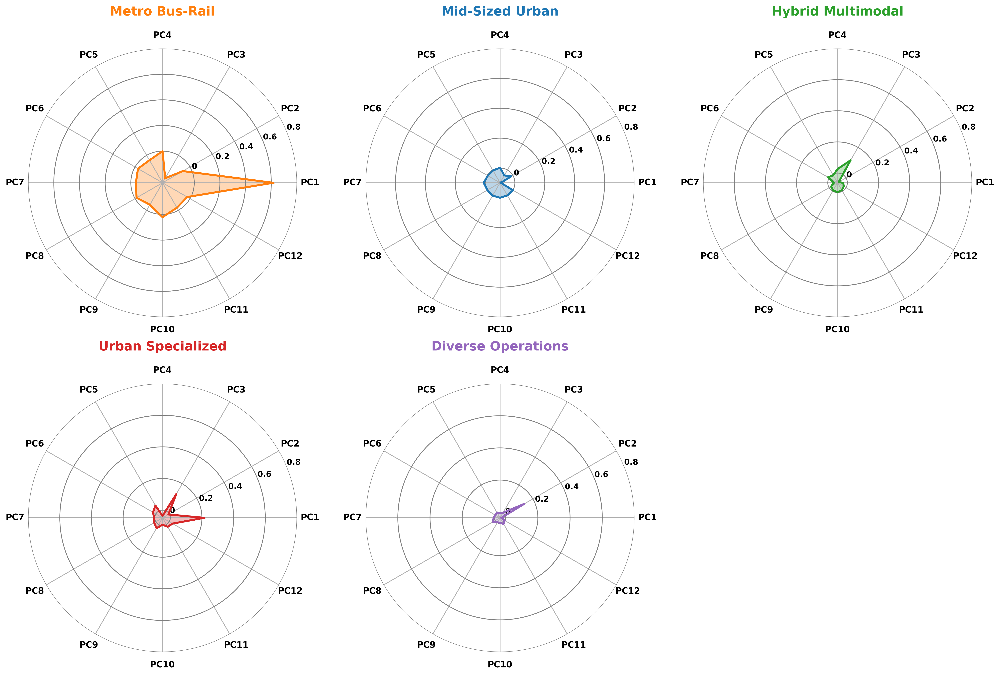

In [186]:
### Case 1: Log-transform the data


# Apply log-scale transformation
log_cluster_means = np.log1p(cluster_means)  # log(1 + x) to keep zeros safe

# Recalculate angles
num_vars = len(cluster_means.columns)
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]

# Set up figure and subplots
fig, axes = plt.subplots(2, 3, figsize=(18, 12), subplot_kw=dict(polar=True), dpi=300)
axes = axes.flatten()

colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']

for i, (cluster_name, row) in enumerate(log_cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]

    ax = axes[i]
    ax.plot(angles, values, linewidth=2.5, linestyle='solid', color=colors[i])
    ax.fill(angles, values, color=colors[i], alpha=0.3)

    ax.set_title(cluster_name, size=16, weight='bold', color=colors[i], pad=20)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(cluster_means.columns, size=11, ha='center', fontweight='bold')

    # Custom radial ticks for log scale (adjust as needed)
    ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8])
    ax.set_yticklabels(['0', '0.2', '0.4', '0.6', '0.8'], size=10, fontweight='bold')

    ax.spines['polar'].set_visible(False)
    for line in ax.yaxis.get_gridlines():
        line.set_color("gray")
        line.set_linewidth(1.0)
        line.set_linestyle('-')

for j in range(len(log_cluster_means), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


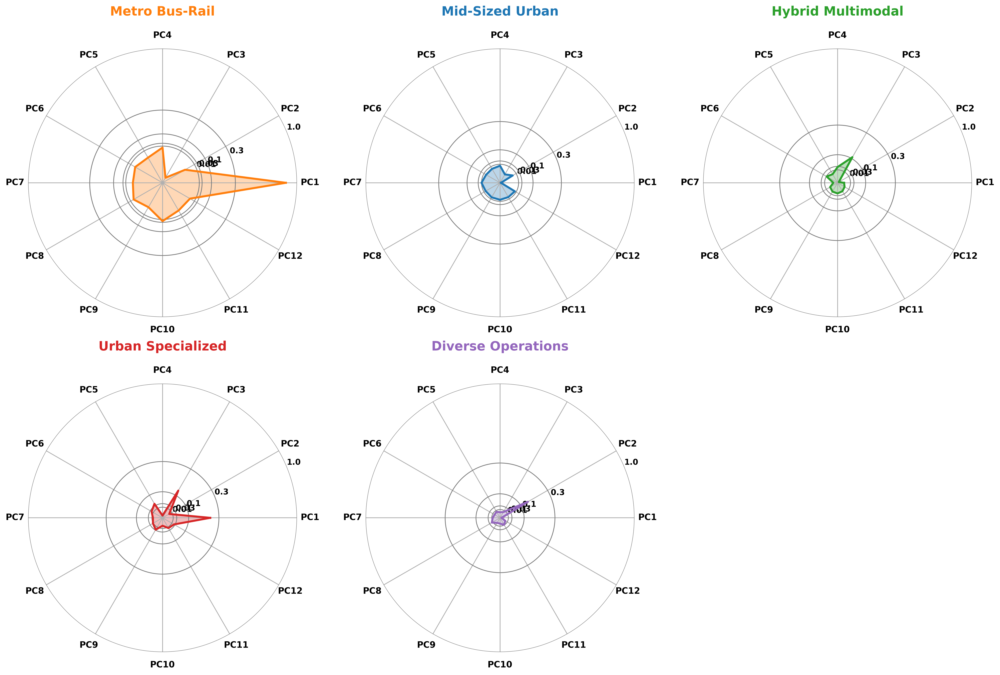

In [187]:
## Case 2. Log-Scale the Radial Axis (Log-Ticks)

# Setup
log_cluster_means = np.log1p(cluster_means)  # 1. Log-transform the data. log1p: computes the natural logarithm of (1 + x). It is used instead of np.log(x) when x might be very small or zero

angles = np.linspace(0, 2 * np.pi, len(log_cluster_means.columns), endpoint=False).tolist()
angles += angles[:1]  # Complete the loop
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']

# Create subplots
fig, axes = plt.subplots(2, 3, figsize=(18, 12), subplot_kw=dict(polar=True), dpi=300)
axes = axes.flatten()

for i, (cluster_name, row) in enumerate(log_cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]

    ax = axes[i]
    ax.plot(angles, values, color=colors[i], linewidth=2.5)
    ax.fill(angles, values, color=colors[i], alpha=0.3)
    ax.set_title(cluster_name, size=16, weight='bold', color=colors[i], pad=20)

    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(log_cluster_means.columns, size=11, fontweight='bold')

    # 2. Simulate log-scale radial axis
    log_ticks = [0.01, 0.03, 0.1, 0.3, 1.0]
    log_tick_labels = ['0.01', '0.03', '0.1', '0.3', '1.0']
    ax.set_yticks(np.log1p(log_ticks))  # NOTE: using log1p because values are already transformed
    ax.set_yticklabels(log_tick_labels, size=10, fontweight='bold')

    # Optional: format radial lines
    for line in ax.yaxis.get_gridlines():
        line.set_color("gray")
        line.set_linewidth(1.0)
        line.set_linestyle('-')
    ax.spines['polar'].set_visible(False)

# Remove extra subplot
for j in range(len(log_cluster_means), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


In [237]:
import numpy as np
import matplotlib.pyplot as plt
import os

# Apply log1p transform
log_cluster_means = np.log1p(cluster_means)

# Setup
angles = np.linspace(0, 2 * np.pi, len(log_cluster_means.columns), endpoint=False).tolist()
angles += angles[:1]
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']
save_path = r'../../figures'

# Descriptive axis labels (12 total)
split_pc_descriptions = [
    "Operating Expenses",  
    "Travel Demand",  
    "Service Scale",  
    "Compactness",  
    "Fleet Utilization",  
    "Administrative Costs",  
    "Service Frequency",  
    "Revenue Operations",  
    "Fare Collection",  
    "Taxi Revenue",  
    "Commuter Operations",
    "Bus Performance"
]

# Plot each cluster in a separate figure
for i, (cluster_name, row) in enumerate(log_cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]

    fig, ax = plt.subplots(figsize=(5, 5), subplot_kw=dict(polar=True), dpi=300)

    # Plot and fill
    ax.plot(angles, values, color=colors[i], linewidth=2.5)
    ax.fill(angles, values, color=colors[i], alpha=0.3)

    # Title
    ax.set_title(cluster_name, size=18, weight='bold', color=colors[i], pad=30)

    # X-axis with descriptive labels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(split_pc_descriptions, size=14)

    # Y-axis ticks
    if cluster_name == 'Metro Bus-Rail':
        log_ticks = [0.01, 0.1, 0.3, 1.0]
    else:
        log_ticks = [0.01, 0.1, 0.3]

    ax.set_yticks(np.log1p(log_ticks))
    ax.set_yticklabels([str(t) for t in log_ticks], size=14)

    # Adjust radial tick position and spacing
    ax.set_rlabel_position(135)
    ax.tick_params(axis='y', labelsize=12, pad=15)

    # Grid and border
    for line in ax.yaxis.get_gridlines():
        line.set_color("gray")
        line.set_linewidth(1.0)
        line.set_linestyle('-')
    ax.spines['polar'].set_visible(False)

    # Save figure
    filename = cluster_name.lower().replace(" ", "_") + "_radar.png"
    fig.savefig(os.path.join(save_path, filename), bbox_inches='tight')
    plt.close(fig)


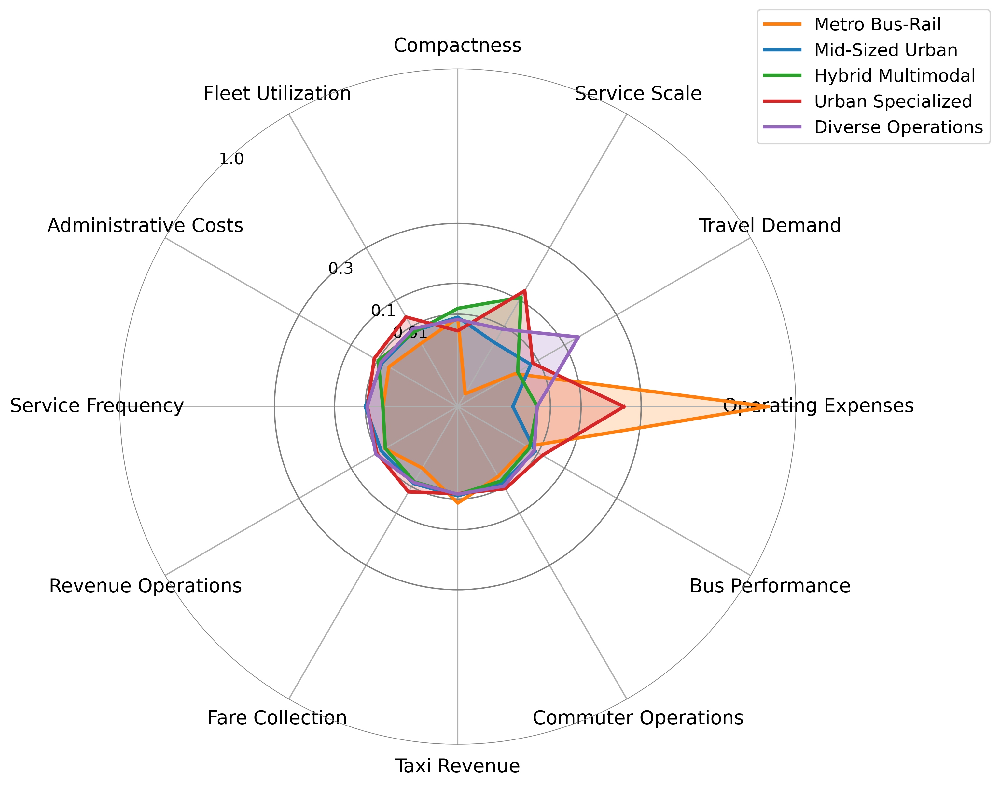

In [239]:
# Apply log1p transform
log_cluster_means = np.log1p(cluster_means)

# Setup
angles = np.linspace(0, 2 * np.pi, len(log_cluster_means.columns), endpoint=False).tolist()
angles += angles[:1]
colors = ['#ff7f0e', '#1f77b4', '#2ca02c', '#d62728', '#9467bd']
cluster_labels = log_cluster_means.index.tolist()
save_path = r'../../figures'

# Descriptive axis labels (12 total)
split_pc_descriptions = [
    "Operating Expenses",  
    "Travel Demand",  
    "Service Scale",  
    "Compactness",  
    "Fleet Utilization",  
    "Administrative Costs",  
    "Service Frequency",  
    "Revenue Operations",  
    "Fare Collection",  
    "Taxi Revenue",  
    "Commuter Operations",
    "Bus Performance"
]

# Initialize single radar plot
fig, ax = plt.subplots(figsize=(9, 9), subplot_kw=dict(polar=True), dpi=300)

# Plot each cluster on same radar
for i, (cluster_name, row) in enumerate(log_cluster_means.iterrows()):
    values = row.tolist()
    values += values[:1]  # repeat first value to close loop

    ax.plot(angles, values, color=colors[i], linewidth=2.5, label=cluster_name)
    ax.fill(angles, values, color=colors[i], alpha=0.2)

# X-axis setup
ax.set_xticks(angles[:-1])
ax.set_xticklabels(split_pc_descriptions, size=14)

# Y-axis setup (uniform for all)
log_ticks = [0.01, 0.1, 0.3, 1.0]
ax.set_yticks(np.log1p(log_ticks))
ax.set_yticklabels([str(t) for t in log_ticks], size=13)
ax.set_rlabel_position(135)
ax.tick_params(axis='y', labelsize=12, pad=10)

# Grid and aesthetics
for line in ax.yaxis.get_gridlines():
    line.set_color("gray")
    line.set_linewidth(1.0)
    line.set_linestyle('-')
ax.spines['polar'].set_visible(False)

# Title and legend
#plt.title("Log-Scaled Radar Plot of Transit System Types", size=18, weight='bold', pad=30)
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1), fontsize=13)

# Save figure
fig.savefig(os.path.join(save_path, "combined_radar_logscale.png"), bbox_inches='tight')
plt.show()


C:\Users\Mahsa\AppData\Local\Temp\ipykernel_30648\2211305613.py:100: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, ax=ax, color='steelblue', ci=None, width=bar_width)
C:\Users\Mahsa\AppData\Local\Temp\ipykernel_30648\2211305613.py:100: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, ax=ax, color='steelblue', ci=None, width=bar_width)
C:\Users\Mahsa\AppData\Local\Temp\ipykernel_30648\2211305613.py:100: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, ax=ax, color='steelblue', ci=None, width=bar_width)
C:\Users\Mahsa\AppData\Local\Temp\ipykernel_30648\2211305613.py:100: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x=top

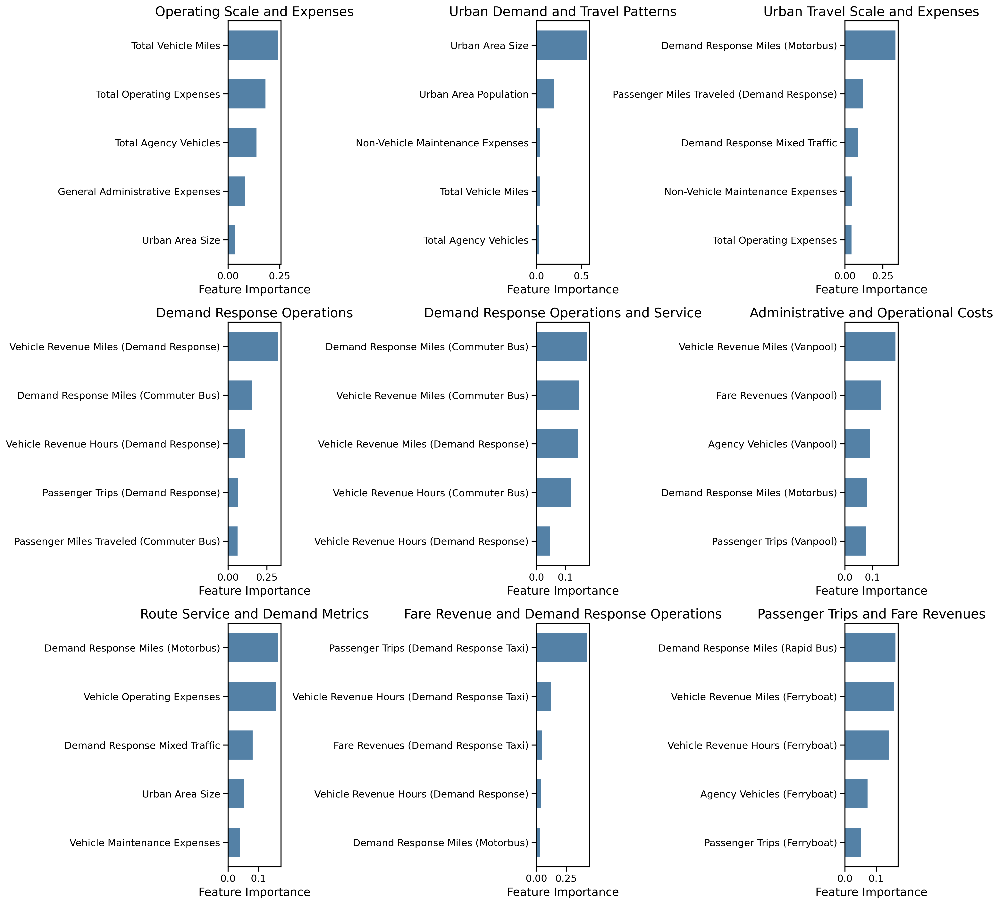

In [64]:
# Initialize a DataFrame to store feature importances
feature_importances = pd.DataFrame(index=df_scaled.columns)

# Train a Random Forest Regressor for each principal component
for i in range(X_kpca.shape[1]):
    # Use the ith principal component as the target
    y = X_kpca[:, i]

    # Train a Random Forest Regressor
    rf = RandomForestRegressor(n_estimators=100, random_state=42)
    rf.fit(df_scaled, y)

    # Extract feature importances
    feature_importances[f'PC{i+1}'] = rf.feature_importances_

# Dictionary for more readable variable names including modes
variable_names = {
    'Actual Vehicle/Passenger Car Miles': 'VehicleMiles',
    'OpExp VO': 'VehicleOpExp',
    'OpExp VM': 'VehicleMaintExp',
    'Agency Vehicles': 'TotalOperatingVehicles',
    'General Administrative Expenses': 'GenAdminExp',
    'Urban Area Size': 'Urban Area',
    'Area Population': 'UZAPop',
    'Demand Response Miles (Motorbus)': 'DemandRespMiles_MB',
    'Passenger Miles Traveled (Commuter Bus)': 'PassengerMiles_CB',
    'Passenger Miles Traveled (Demand Response)': 'PassengerMiles_DR',
    'Vehicle Revenue Hours (Demand Response)': 'RevenueHours_DR',
    'Vehicle Revenue Miles (Vanpool)': 'RevenueHours_VP',
    'Non-Vehicle Maintenance Expenses': 'NonVehicleMaintExp',
    'Demand Response Mixed Traffic': 'DemandResponseMixedROW',
    'Operating Expenses': 'TotalOpExp',
    'Unlinked Passenger Trips (Demand Response)': 'PassengerTrips_DR',
    
    # Add the rest of the variable name mappings...
}


# Rename the columns in the DataFrame
df_scaled.rename(columns=variable_names, inplace=True)

# Get the top 5 most important variables for each principal component
top_n = 5

# Define the titles for each principal component based on the descriptions
#pc_titles = [
#    'Operating scale',
#    'Urban area characteristics',
#    'Passenger demand',
#    'Commuter operations',
#    'Commuter demand response',
#    'Vanpool operations',
#    'Motor bus and vanpool costs',
#    'Taxi ridership and hours',
#    'Ferryboat and rapid bus',
#    'Rapid bus and geographic scale',
#    'Rural area characteristics',
#    'Commuter rail demand'
#]

pc_titles = [
    'Operating scale',
    'Urban area characteristics',
    'Passenger demand',
    'Demand response operations',
    'Commuter demand response',
    'Vanpool operations',
    'Mixed traffic route costs',
    'Taxi ridership and hours',
    'Specialized transit modes'
]


pc_titles = [
    "Operating Scale and Expenses",  
    "Urban Demand and Travel Patterns",  
    "Urban Travel Scale and Expenses",  
    "Demand Response Operations",  
    "Demand Response Operations and Service",  
    "Administrative and Operational Costs",  
    "Route Service and Demand Metrics",  
    "Fare Revenue and Demand Response Operations",  
    "Passenger Trips and Fare Revenues",  
    "Fare Revenues and Demand Response Taxi Metrics",  
    "Urban Scale and Commuter Operations",  
    "Commuter Bus Performance and Travel Metrics"
]

# Create subplots with adjusted size and spacing
fig, axes = plt.subplots(3, 3, figsize=(16, 16), dpi=300)

# Reduce bar width and space between bars
bar_width = 0.6  # Adjust width of the bars

for i, ax in enumerate(axes.flat):
    if i < X_kpca.shape[1]:
        pc = f'PC{i+1}'
        top_features = feature_importances[pc].nlargest(top_n)

        sns.barplot(x=top_features.values, y=top_features.index, ax=ax, color='steelblue', ci=None, width=bar_width)
        ax.set_xlabel('Feature Importance', fontsize=14)
        ax.set_ylabel('')
        ax.set_title(pc_titles[i], fontsize=16)
        ax.tick_params(axis='x', labelsize=12)
        ax.tick_params(axis='y', labelsize=12)

# Adjust the layout to reduce space between subplots
plt.tight_layout(pad=2.0, h_pad=1.0, w_pad=1.0)

plt.show()


## Cluster Centers and Distributions

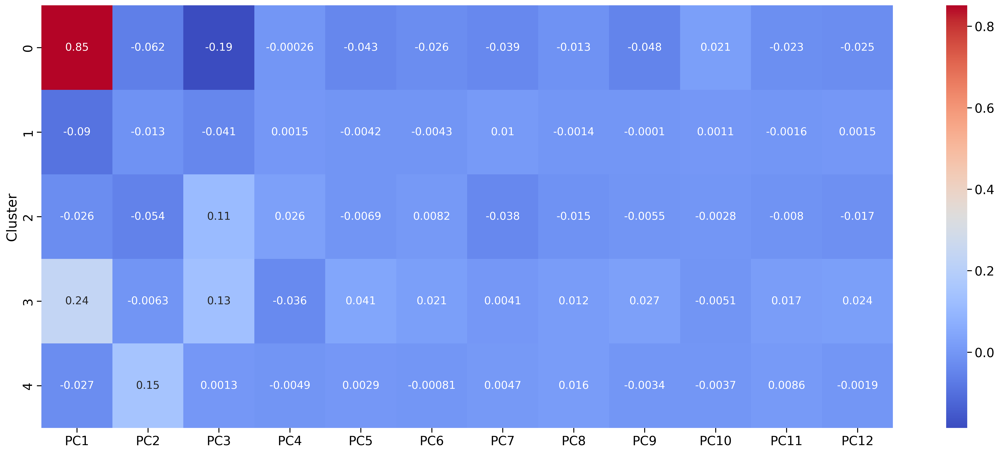

In [65]:
# Calculate cluster centers
cluster_centers = best_gmm.means_

# Create a DataFrame for cluster centers
cluster_centers_df = pd.DataFrame(cluster_centers, columns=[f'PC{i+1}' for i in range(12)])
cluster_centers_df['Cluster'] = range(0, best_gmm.n_components)

# Plot the cluster centers
plt.figure(figsize=(25, 10), dpi=300)
sns.heatmap(cluster_centers_df.set_index('Cluster'), annot=True, cmap='coolwarm')
#plt.title('Cluster Centers in Principal Component Space', fontsize=16)
plt.show()


### Save the appropriate data for energy prediction

In [66]:
# Load data
# File path to the saved final CSV
output_path = r'../../data/tidy/NTD_Annual_Data_Tidy_v02.csv'

# Read the CSV file and set the index to 'Agency'
df = pd.read_csv(output_path, index_col='Agency')

# Drop the original columns to avoid redundancy
df.drop(columns=['UZA Name'], inplace=True)

# Drop rows with null indexes
empty_index_rows = df_final_combined.index[df_final_combined.index.isnull()]
df = df.drop(empty_index_rows)

# Creating the new columns
df['Operating'] = df[['Operating Federal', 'Operating State', 'Operating Local', 'Operating Other']].sum(axis=1)
df['Capital'] = df[['Capital Federal', 'Capital State', 'Capital Local', 'Capital Other']].sum(axis=1)

# Dropping the used columns
df.drop(columns=['Operating Federal', 'Operating State', 'Operating Local', 'Operating Other', 
                                'Capital Federal', 'Capital State', 'Capital Local', 'Capital Other', 'Total OE'], inplace=True)

df

,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Service Area Population,Primary UZA Area Sq Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,...,DRM Mixed Traffic ROW,City,State,UZA,Service Area Sq Miles,Service Area Pop,Latitude,Longitude,Operating,Capital
Agency,,,,,,,,,,,,,,,,,,,,,
"King County Department of Metro Transit, dba: King County Metro",1,18261.0,51015415.0,2287050.0,982.52,0.0,0.0,0.0,0.0,311.0,...,1299.03,Seattle,WA,"80389 - Seattle--Tacoma, WA",2134.0,2287050.0,47.606139,-122.332848,984364098.0,164646549.0
Spokane Transit Authority,2,1116.0,10296150.0,459007.0,171.67,0.0,0.0,0.0,0.0,79.0,...,958.10,Spokane,WA,"83764 - Spokane, WA",248.0,459007.0,47.657971,-117.423532,94356558.0,40289227.0
Pierce County Transportation Benefit Area Authority,3,1910.0,9841274.0,575963.0,982.52,0.0,0.0,0.0,0.0,77.0,...,499.74,Lakewood,WA,"80389 - Seattle--Tacoma, WA",292.0,575963.0,47.171765,-122.518458,142722484.0,45755527.0
Confederated Tribes of the Colville Indian Reservation,4,10.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,0.0,...,0.00,Nespelem,WA,00053 - Washington Non-UZA,NaN,NaN,48.167100,-118.974748,1490917.0,0.0
"City of Everett, dba: EVERETT TRANSIT",5,84.0,1625002.0,110629.0,982.52,0.0,0.0,0.0,0.0,15.0,...,118.40,Everett,WA,"80389 - Seattle--Tacoma, WA",34.0,110629.0,47.978985,-122.202079,23789684.0,945068.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Elk Valley Rancheria,99452,1.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,1.0,...,0.00,Crescent City,CA,00006 - California Non-UZA,NaN,NaN,41.755750,-124.202591,28844.0,0.0
City of Winslow,99453,2.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0,2.0,...,0.00,Winslow,AZ,NaN,NaN,NaN,35.024187,-110.697357,128375.0,0.0
Palo Verde Valley Transit Agency,99454,20.0,0.0,NaN,NaN,0.0,5.0,0.0,0.0,0.0,...,0.00,Blythe,CA,NaN,NaN,NaN,33.617773,-114.588261,1160637.0,0.0


In [67]:
# Convert columns to a list and print
columns_list = df.columns.tolist()
print(columns_list)

['NTD ID', 'Agency VOMS', 'Actual Vehicle/Passenger Car Miles', 'Service Area Population', 'Primary UZA Area Sq Miles', 'Mode VOMS_AR', 'Mode VOMS_CB', 'Mode VOMS_CC', 'Mode VOMS_CR', 'Mode VOMS_DR', 'Mode VOMS_FB', 'Mode VOMS_HR', 'Mode VOMS_IP', 'Mode VOMS_LR', 'Mode VOMS_MB', 'Mode VOMS_MG', 'Mode VOMS_PB', 'Mode VOMS_RB', 'Mode VOMS_SR', 'Mode VOMS_TB', 'Mode VOMS_TR', 'Mode VOMS_VP', 'Mode VOMS_YR', 'Diesel (gal)', 'Gasoline (gal)', 'Liquefied Petroleum Gas (gal)', 'Compressed Natural Gas (gal)', 'Bio Diesel (gal)', 'Other Fuel (gal/gal equivalent)', 'Electric Propulsion (kWh)', 'Electric Battery (kWh)', 'total_diesel(gal)', 'total_kWh', 'Total Operating Hours', 'Total Employees', 'FARES_AR', 'FARES_CB', 'FARES_CC', 'FARES_CR', 'FARES_DR', 'FARES_DT', 'FARES_FB', 'FARES_HR', 'FARES_IP', 'FARES_JT', 'FARES_LR', 'FARES_MB', 'FARES_MG', 'FARES_OR', 'FARES_PB', 'FARES_RB', 'FARES_SR', 'FARES_TB', 'FARES_TR', 'FARES_VP', 'FARES_YR', 'DRM_AR', 'DRM_CB', 'DRM_CC', 'DRM_CR', 'DRM_DR', 'DR

In [68]:
# Columns to drop
columns_to_drop = ['Diesel (gal)', 'Gasoline (gal)', 'Liquefied Petroleum Gas (gal)', 
                   'Compressed Natural Gas (gal)', 'Bio Diesel (gal)', 'Other Fuel (gal/gal equivalent)', 
                   'Electric Propulsion (kWh)', 'Electric Battery (kWh)']

# Drop the specified columns
df = df.drop(columns=columns_to_drop)
df

,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Service Area Population,Primary UZA Area Sq Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,...,DRM Mixed Traffic ROW,City,State,UZA,Service Area Sq Miles,Service Area Pop,Latitude,Longitude,Operating,Capital
Agency,,,,,,,,,,,,,,,,,,,,,
"King County Department of Metro Transit, dba: King County Metro",1,18261.0,51015415.0,2287050.0,982.52,0.0,0.0,0.0,0.0,311.0,...,1299.03,Seattle,WA,"80389 - Seattle--Tacoma, WA",2134.0,2287050.0,47.606139,-122.332848,984364098.0,164646549.0
Spokane Transit Authority,2,1116.0,10296150.0,459007.0,171.67,0.0,0.0,0.0,0.0,79.0,...,958.10,Spokane,WA,"83764 - Spokane, WA",248.0,459007.0,47.657971,-117.423532,94356558.0,40289227.0
Pierce County Transportation Benefit Area Authority,3,1910.0,9841274.0,575963.0,982.52,0.0,0.0,0.0,0.0,77.0,...,499.74,Lakewood,WA,"80389 - Seattle--Tacoma, WA",292.0,575963.0,47.171765,-122.518458,142722484.0,45755527.0
Confederated Tribes of the Colville Indian Reservation,4,10.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,0.0,...,0.00,Nespelem,WA,00053 - Washington Non-UZA,NaN,NaN,48.167100,-118.974748,1490917.0,0.0
"City of Everett, dba: EVERETT TRANSIT",5,84.0,1625002.0,110629.0,982.52,0.0,0.0,0.0,0.0,15.0,...,118.40,Everett,WA,"80389 - Seattle--Tacoma, WA",34.0,110629.0,47.978985,-122.202079,23789684.0,945068.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Elk Valley Rancheria,99452,1.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,1.0,...,0.00,Crescent City,CA,00006 - California Non-UZA,NaN,NaN,41.755750,-124.202591,28844.0,0.0
City of Winslow,99453,2.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0,2.0,...,0.00,Winslow,AZ,NaN,NaN,NaN,35.024187,-110.697357,128375.0,0.0
Palo Verde Valley Transit Agency,99454,20.0,0.0,NaN,NaN,0.0,5.0,0.0,0.0,0.0,...,0.00,Blythe,CA,NaN,NaN,NaN,33.617773,-114.588261,1160637.0,0.0


In [69]:
# Convert columns to a list and print
columns_list = df.columns.tolist()
print(columns_list)

['NTD ID', 'Agency VOMS', 'Actual Vehicle/Passenger Car Miles', 'Service Area Population', 'Primary UZA Area Sq Miles', 'Mode VOMS_AR', 'Mode VOMS_CB', 'Mode VOMS_CC', 'Mode VOMS_CR', 'Mode VOMS_DR', 'Mode VOMS_FB', 'Mode VOMS_HR', 'Mode VOMS_IP', 'Mode VOMS_LR', 'Mode VOMS_MB', 'Mode VOMS_MG', 'Mode VOMS_PB', 'Mode VOMS_RB', 'Mode VOMS_SR', 'Mode VOMS_TB', 'Mode VOMS_TR', 'Mode VOMS_VP', 'Mode VOMS_YR', 'total_diesel(gal)', 'total_kWh', 'Total Operating Hours', 'Total Employees', 'FARES_AR', 'FARES_CB', 'FARES_CC', 'FARES_CR', 'FARES_DR', 'FARES_DT', 'FARES_FB', 'FARES_HR', 'FARES_IP', 'FARES_JT', 'FARES_LR', 'FARES_MB', 'FARES_MG', 'FARES_OR', 'FARES_PB', 'FARES_RB', 'FARES_SR', 'FARES_TB', 'FARES_TR', 'FARES_VP', 'FARES_YR', 'DRM_AR', 'DRM_CB', 'DRM_CC', 'DRM_CR', 'DRM_DR', 'DRM_DT', 'DRM_FB', 'DRM_HR', 'DRM_IP', 'DRM_JT', 'DRM_LR', 'DRM_MB', 'DRM_MG', 'DRM_OR', 'DRM_PB', 'DRM_RB', 'DRM_SR', 'DRM_TB', 'DRM_TR', 'DRM_VP', 'DRM_YR', 'VRM_AR', 'VRM_CB', 'VRM_CC', 'VRM_CR', 'VRM_DR', 'V

In [70]:
df = df[df.index.notna()]
df

,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Service Area Population,Primary UZA Area Sq Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,...,DRM Mixed Traffic ROW,City,State,UZA,Service Area Sq Miles,Service Area Pop,Latitude,Longitude,Operating,Capital
Agency,,,,,,,,,,,,,,,,,,,,,
"King County Department of Metro Transit, dba: King County Metro",1,18261.0,51015415.0,2287050.0,982.52,0.0,0.0,0.0,0.0,311.0,...,1299.03,Seattle,WA,"80389 - Seattle--Tacoma, WA",2134.0,2287050.0,47.606139,-122.332848,984364098.0,164646549.0
Spokane Transit Authority,2,1116.0,10296150.0,459007.0,171.67,0.0,0.0,0.0,0.0,79.0,...,958.10,Spokane,WA,"83764 - Spokane, WA",248.0,459007.0,47.657971,-117.423532,94356558.0,40289227.0
Pierce County Transportation Benefit Area Authority,3,1910.0,9841274.0,575963.0,982.52,0.0,0.0,0.0,0.0,77.0,...,499.74,Lakewood,WA,"80389 - Seattle--Tacoma, WA",292.0,575963.0,47.171765,-122.518458,142722484.0,45755527.0
Confederated Tribes of the Colville Indian Reservation,4,10.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,0.0,...,0.00,Nespelem,WA,00053 - Washington Non-UZA,NaN,NaN,48.167100,-118.974748,1490917.0,0.0
"City of Everett, dba: EVERETT TRANSIT",5,84.0,1625002.0,110629.0,982.52,0.0,0.0,0.0,0.0,15.0,...,118.40,Everett,WA,"80389 - Seattle--Tacoma, WA",34.0,110629.0,47.978985,-122.202079,23789684.0,945068.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Payson Senior Center,99441,2.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,...,0.00,Payson,AZ,NaN,NaN,NaN,34.230868,-111.325136,208973.0,0.0
Calaveras Transit Agency,99442,22.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0,5.0,...,0.00,San Andreas,CA,NaN,NaN,NaN,38.196030,-120.680487,1143254.0,72083.0
Elk Valley Rancheria,99452,1.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,1.0,...,0.00,Crescent City,CA,00006 - California Non-UZA,NaN,NaN,41.755750,-124.202591,28844.0,0.0


In [71]:
# Add the PCs to your dataframe
for i in range(X_kpca.shape[1]):
    df[f'PC{i+1}'] = X_kpca[:, i]
df

C:\Users\Mahsa\AppData\Local\Temp\ipykernel_30648\785952984.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'PC{i+1}'] = X_kpca[:, i]
C:\Users\Mahsa\AppData\Local\Temp\ipykernel_30648\785952984.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'PC{i+1}'] = X_kpca[:, i]
C:\Users\Mahsa\AppData\Local\Temp\ipykernel_30648\785952984.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Service Area Population,Primary UZA Area Sq Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,...,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
Agency,,,,,,,,,,,,,,,,,,,,,
"King County Department of Metro Transit, dba: King County Metro",1,18261.0,51015415.0,2287050.0,982.52,0.0,0.0,0.0,0.0,311.0,...,-0.221281,-0.004643,-0.034000,-0.032924,-0.037869,-0.008939,-0.010514,-0.021933,-0.045833,-0.031461
Spokane Transit Authority,2,1116.0,10296150.0,459007.0,171.67,0.0,0.0,0.0,0.0,79.0,...,0.488973,0.079114,-0.154299,0.124937,0.223711,-0.060014,0.042044,0.011579,0.008407,0.016438
Pierce County Transportation Benefit Area Authority,3,1910.0,9841274.0,575963.0,982.52,0.0,0.0,0.0,0.0,77.0,...,0.089964,-0.059251,-0.059665,0.702281,0.196466,-0.048377,0.038672,-0.001234,-0.010424,-0.001315
Confederated Tribes of the Colville Indian Reservation,4,10.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,0.0,...,-0.056546,-0.029473,-0.033120,-0.010230,-0.022373,0.005070,0.113705,0.062222,0.042510,0.036662
"City of Everett, dba: EVERETT TRANSIT",5,84.0,1625002.0,110629.0,982.52,0.0,0.0,0.0,0.0,15.0,...,0.180524,-0.001985,-0.028263,0.016044,-0.078176,-0.010599,-0.016816,-0.016438,0.007552,-0.013636
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Payson Senior Center,99441,2.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,...,-0.052725,-0.026031,-0.020982,-0.008634,0.013648,0.000441,-0.001489,-0.004645,0.003926,0.002403
Calaveras Transit Agency,99442,22.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0,5.0,...,-0.043160,-0.004121,-0.011112,-0.010444,0.037352,0.008943,0.006808,0.035971,-0.035651,-0.001554
Elk Valley Rancheria,99452,1.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,1.0,...,-0.048056,-0.009811,-0.012703,-0.010356,0.036326,0.009249,0.006531,0.035939,-0.036598,-0.001457


In [72]:
df['Cluster'] = clusters

## Drop rows where 'total_diesel(gal)' is NaN or empty
#df = df.dropna(subset=['total_diesel(gal)'])

# If there are any empty strings, you can also replace them with NaN and then drop
df['total_diesel(gal)'].replace('', pd.NA, inplace=True)
#df = df.dropna(subset=['total_diesel(gal)'])
df

C:\Users\Mahsa\AppData\Local\Temp\ipykernel_30648\2902861569.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Cluster'] = clusters
C:\Users\Mahsa\AppData\Local\Temp\ipykernel_30648\2902861569.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['total_diesel(gal)'].replace('', pd.NA, inplace=True)


,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Service Area Population,Primary UZA Area Sq Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,...,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,Cluster
Agency,,,,,,,,,,,,,,,,,,,,,
"King County Department of Metro Transit, dba: King County Metro",1,18261.0,51015415.0,2287050.0,982.52,0.0,0.0,0.0,0.0,311.0,...,-0.004643,-0.034000,-0.032924,-0.037869,-0.008939,-0.010514,-0.021933,-0.045833,-0.031461,0
Spokane Transit Authority,2,1116.0,10296150.0,459007.0,171.67,0.0,0.0,0.0,0.0,79.0,...,0.079114,-0.154299,0.124937,0.223711,-0.060014,0.042044,0.011579,0.008407,0.016438,3
Pierce County Transportation Benefit Area Authority,3,1910.0,9841274.0,575963.0,982.52,0.0,0.0,0.0,0.0,77.0,...,-0.059251,-0.059665,0.702281,0.196466,-0.048377,0.038672,-0.001234,-0.010424,-0.001315,3
Confederated Tribes of the Colville Indian Reservation,4,10.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,0.0,...,-0.029473,-0.033120,-0.010230,-0.022373,0.005070,0.113705,0.062222,0.042510,0.036662,3
"City of Everett, dba: EVERETT TRANSIT",5,84.0,1625002.0,110629.0,982.52,0.0,0.0,0.0,0.0,15.0,...,-0.001985,-0.028263,0.016044,-0.078176,-0.010599,-0.016816,-0.016438,0.007552,-0.013636,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Payson Senior Center,99441,2.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,...,-0.026031,-0.020982,-0.008634,0.013648,0.000441,-0.001489,-0.004645,0.003926,0.002403,1
Calaveras Transit Agency,99442,22.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0,5.0,...,-0.004121,-0.011112,-0.010444,0.037352,0.008943,0.006808,0.035971,-0.035651,-0.001554,1
Elk Valley Rancheria,99452,1.0,0.0,NaN,0.00,0.0,0.0,0.0,0.0,1.0,...,-0.009811,-0.012703,-0.010356,0.036326,0.009249,0.006531,0.035939,-0.036598,-0.001457,1


In [73]:
# Save the merged dataframe to a new CSV file
output_path = r'../../data/tidy/NTD_Energy.csv'
df.to_csv(output_path, index=False)

In [74]:
### Save the pcs as well:

df_final_combined = df_final_combined.copy() 

# Add the PCs to your dataframe
for i in range(X_kpca.shape[1]):
    df_final_combined[f'PC{i+1}'] = X_kpca[:, i]

# Add clusters to the dataframe
df_final_combined['Cluster'] = clusters

# Save the dataframe with PCs and clusters to a CSV file
output_path = r'../../data/tidy/NTD_Energy_with_PCs.csv'
df_final_combined.to_csv(output_path, index=False)


In [75]:
df_final_combined

,NTD ID,Agency VOMS,Actual Vehicle/Passenger Car Miles,Mode VOMS_AR,Mode VOMS_CB,Mode VOMS_CC,Mode VOMS_CR,Mode VOMS_DR,Mode VOMS_FB,Mode VOMS_HR,...,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
Agency,,,,,,,,,,,,,,,,,,,,,
Tri-County Metropolitan Transportation District of Oregon,8,4518.0,36072191.0,0.0,0.0,0.0,0.0,157.0,0.0,0.0,...,-0.221281,-0.004643,-0.034000,-0.032924,-0.037869,-0.008939,-0.010514,-0.021933,-0.045833,-0.031461
Utah Transit Authority,80001,8504.0,40768367.0,0.0,66.0,0.0,45.0,139.0,0.0,0.0,...,0.488973,0.079114,-0.154299,0.124937,0.223711,-0.060014,0.042044,0.011579,0.008407,0.016438
Port Authority of Allegheny County,30022,3292.0,33102167.0,0.0,0.0,0.0,0.0,208.0,0.0,0.0,...,0.089964,-0.059251,-0.059665,0.702281,0.196466,-0.048377,0.038672,-0.001234,-0.010424,-0.001315
"County of Miami-Dade , dba: Transportation & Public Work",40034,9373.0,60878000.0,0.0,9.0,0.0,0.0,332.0,0.0,84.0,...,-0.056546,-0.029473,-0.033120,-0.010230,-0.022373,0.005070,0.113705,0.062222,0.042510,0.036662
Alameda-Contra Costa Transit District,90014,2730.0,22028991.0,0.0,24.0,0.0,0.0,132.0,0.0,0.0,...,0.180524,-0.001985,-0.028263,0.016044,-0.078176,-0.010599,-0.016816,-0.016438,0.007552,-0.013636
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"City of Torrance, dba: Torrance Transit System",90010,148.0,1575799.0,0.0,0.0,0.0,0.0,36.0,0.0,0.0,...,-0.052725,-0.026031,-0.020982,-0.008634,0.013648,0.000441,-0.001489,-0.004645,0.003926,0.002403
"City of Gardena, dba: GTrans",90042,60.0,1210726.0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,...,-0.043160,-0.004121,-0.011112,-0.010444,0.037352,0.008943,0.006808,0.035971,-0.035651,-0.001554
"County of Rockland , dba: Public Transportation - Transport of Rockland",20084,106.0,2744759.0,0.0,0.0,0.0,0.0,19.0,0.0,0.0,...,-0.048056,-0.009811,-0.012703,-0.010356,0.036326,0.009249,0.006531,0.035939,-0.036598,-0.001457


In [76]:
cluster_counts = df_final_combined['Cluster'].value_counts()

# Display the counts of unique values in the 'Cluster' column
cluster_counts

Cluster
1    1286
2     317
4     268
3     251
0      83
Name: count, dtype: int64